In [1]:
import nibabel as nib
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import os
import sys
from glob import glob
import math
import json

In [2]:
sys.path.insert(0, '/home/ROBARTS/myousif/software/PCNtoolkit/')
from pcntoolkit.util.utils import create_design_matrix
from pcntoolkit.normative import estimate, evaluate, predict

/home/ROBARTS/myousif/virtualenvs/pcntoolkit_dev_cbs_venv/lib/python3.8/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [3]:
sys.path.insert(0,'/home/ROBARTS/myousif/software/hippunfold_toolbox/')
from hippunfold_toolbox import plotting

In [4]:
sys.path.insert(0, '/home/ROBARTS/myousif/software/hippomaps/')
import hippomaps as hm
from hippomaps import plotting

In [5]:
from brainspace.vtk_interface.wrappers.data_object import BSPolyData
from brainstat.mesh.data import mesh_smooth

from brainstat.stats.terms import FixedEffect, MixedEffect
from brainstat.stats.SLM import SLM
from brainspace.mesh.mesh_io import read_surface
from brainstat.context.meta_analysis import radar_plot

In [6]:

surf = read_surface('/home/ROBARTS/myousif/software/hippunfold_toolbox/resources/canonical_surfs/tpl-avg_space-canonical_den-2mm_label-hipp_midthickness.surf.gii')


In [90]:
eplink_qc[['CITI_REG','DSEG_L','Surf_Hippo_L','DSEG_R','Surf_Hippo_R']].sum(axis=1)

participant_id
sub-HSC0002    5
sub-HSC0004    5
sub-HSC0006    5
sub-HSC0009    5
sub-HSC0011    5
              ..
sub-TWH0081    5
sub-TWH0082    5
sub-TWH0083    4
sub-TWH0085    5
sub-TWH0086    2
Length: 96, dtype: int64

In [94]:
snsx_qc

,CITI_REG,DSEG_L,Surf_Dentate_L,Surf_Hippo_L,DSEG_R,Surf_Dentate_R,Surf_Hippo_R,pass_sum,pass,dataset
participant_id,,,,,,,,,,
sub-C002,1,1,NaN,1,1,NaN,1,5,True,snsx
sub-C004,1,1,NaN,1,1,NaN,1,5,True,snsx
sub-C006,1,1,NaN,1,1,NaN,1,5,True,snsx
sub-C008,1,1,NaN,1,1,NaN,1,5,True,snsx
sub-C010,1,1,NaN,1,1,NaN,1,5,True,snsx
...,...,...,...,...,...,...,...,...,...,...
Sub-P129,1,1,NaN,1,1,NaN,1,5,True,snsx
sub-P136,1,1,NaN,1,1,NaN,1,5,True,snsx
sub-P139,1,1,NaN,1,1,NaN,1,5,True,snsx


In [99]:
snsx_qc = pd.read_csv('/home/ROBARTS/myousif/graham/projects/ctb-akhanf/myousif9/norm_models/datasets/snsx/derivatives_7T/hippunfold_qc.csv')
eplink_qc = pd.read_csv('/home/ROBARTS/myousif/graham/projects/ctb-akhanf/myousif9/norm_models/datasets/eplink_phase3/baseline/derivatives/hippunfold_qc.csv')
snsx_qc['dataset'] = 'snsx'
eplink_qc['dataset'] = 'eplink'
eplink_qc['pass_sum'] = eplink_qc[['CITI_REG','DSEG_L','Surf_Hippo_L','DSEG_R','Surf_Hippo_R']].sum(axis=1)
eplink_qc['pass'] = eplink_qc['pass_sum'] == 5

qc_df = pd.concat([snsx_qc,eplink_qc])[['participant_id','dataset','pass']]

In [117]:
snsx_vol_df = pd.read_csv('../data/snsx_data/snsx_volume_ipsi_data.csv',index_col=0)
snsx_vol_df = snsx_vol_df[['participant_id', 'hemi', 'ipsilateral_mts', 'ipsilateral_TLE',
                           'ipsilateral_TLE_non_epi (TLE=1/non-tle-epi=0)',
                           'ipsilateral_mts_non_tle_epi (TLE=1/non-tle-epi=0)']]
snsx_vol_df['dataset'] = 'snsx'

In [118]:
eplink_vol_df = pd.read_csv('../data/eplink_data/eplink_volume_data.csv',index_col=0)
eplink_vol_df = eplink_vol_df[['participant_id', 'hemi','ipsilateral_mts','ipsilateral_mts_non_tle_epi (TLE=1/non-tle-epi=0)']]
eplink_vol_df['dataset'] = 'eplink'

In [7]:
histology = {}
histology_dir = '../../../hippomaps_histology/'
for fname in os.listdir(histology_dir):
    fpath =  os.path.join(histology_dir,fname)
    histology[fpath.split('-')[1].replace('_average','')] = hm.utils.density_interp('unfoldiso', '2mm', nib.load(fpath).darrays[0].data,'hipp')[0]



In [893]:
histology['Calretinin_average']

array([-5.81645062e-01, -7.41120485e-01, -1.05502100e+00, -4.64210583e-01,
        2.64421819e-01, -5.03442999e-01, -2.71947669e-01, -8.87566970e-02,
        4.87817698e-01,  9.87864584e-01, -5.02766334e-01, -5.20110191e-01,
       -2.47188416e-01, -9.51041515e-02,  1.53085619e-01, -1.44169539e-01,
        5.41300120e-01,  4.84923699e-01,  8.12393010e-01,  2.78179402e-02,
       -2.85566886e-01,  8.69088017e-02,  2.82714671e-01,  1.05119705e-01,
       -2.62833400e-01,  2.06892061e-01,  9.28269611e-01,  1.86812516e+00,
        4.31710109e-01,  7.37376864e-01,  6.75977143e-01,  4.87196126e-01,
       -1.85855521e-01, -6.31106493e-02, -1.45179025e-01,  7.23614820e-01,
        1.28299591e-01,  9.41360660e-01,  8.07597758e-01,  5.90090329e-01,
       -2.59534152e-01, -1.49965439e-01, -1.90971399e-01,  5.52810549e-02,
       -7.33046047e-02,  1.33475004e+00, -4.27585506e-01,  5.21440882e-01,
       -3.12172976e-01, -2.50645437e-01, -6.25635164e-02, -2.19782822e-01,
        4.95503835e-02,  

In [887]:
hm.utils.density_interp('unfoldiso', '2mm',histology['Calretinin_average'],'hipp')

(array([-5.81645062e-01, -7.41120485e-01, -1.05502100e+00, -4.64210583e-01,
         2.64421819e-01, -5.03442999e-01, -2.71947669e-01, -8.87566970e-02,
         4.87817698e-01,  9.87864584e-01, -5.02766334e-01, -5.20110191e-01,
        -2.47188416e-01, -9.51041515e-02,  1.53085619e-01, -1.44169539e-01,
         5.41300120e-01,  4.84923699e-01,  8.12393010e-01,  2.78179402e-02,
        -2.85566886e-01,  8.69088017e-02,  2.82714671e-01,  1.05119705e-01,
        -2.62833400e-01,  2.06892061e-01,  9.28269611e-01,  1.86812516e+00,
         4.31710109e-01,  7.37376864e-01,  6.75977143e-01,  4.87196126e-01,
        -1.85855521e-01, -6.31106493e-02, -1.45179025e-01,  7.23614820e-01,
         1.28299591e-01,  9.41360660e-01,  8.07597758e-01,  5.90090329e-01,
        -2.59534152e-01, -1.49965439e-01, -1.90971399e-01,  5.52810549e-02,
        -7.33046047e-02,  1.33475004e+00, -4.27585506e-01,  5.21440882e-01,
        -3.12172976e-01, -2.50645437e-01, -6.25635164e-02, -2.19782822e-01,
         4.9

In [935]:
list(histology.keys())

['PLI',
 'Thionin',
 'Calretinin',
 'Blockface',
 'Calbindin',
 'Merker',
 'Parvalbumin',
 'Bieloschowsky']

<AxesSubplot: ylabel='Count'>

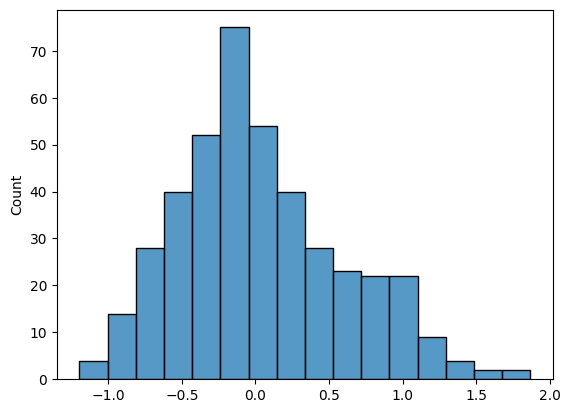

In [894]:
sns.histplot(histology['Calretinin_average'])

In [ ]:
sns.histplot(histology['Thionin_average'])

In [864]:
test = nib.load(fpath)

In [869]:
test.darrays[0].data

(32004,)

In [8]:
project_path = os.path.abspath(os.path.join(os.getcwd(),'..'))
project_data_path = os.path.join(project_path,'data')
snsx_data_path = os.path.join(project_data_path,'snsx_data')
eplink_data_path = os.path.join(project_data_path, 'eplink_data')

In [9]:
snsx_ctrl_covs = []
snsx_diseased_ctrl_covs = []
snsx_epi_covs = []

snsx_ctrl_idp = []
snsx_diseased_ctrl_idp = []
snsx_epi_idp = []

snsx_groups = ['control','diseased_control','epilpesy']
snsx_metrics = ['thickness','gyrification','myelin','fa','md']

for met_idx, met in enumerate(snsx_metrics):
    snsx_ctrl_covs.append(os.path.join(snsx_data_path,f'snsx_{met}_control_cov.txt'))
    snsx_diseased_ctrl_covs.append(os.path.join(snsx_data_path,f'snsx_{met}_diseased_control_cov.txt'))
    snsx_epi_covs.append(os.path.join(snsx_data_path,f'snsx_{met}_epilepsy_cov.txt'))
    
    snsx_ctrl_idp.append(os.path.join(snsx_data_path,f'snsx_{met}_control_IDP.txt'))
    snsx_diseased_ctrl_idp.append(os.path.join(snsx_data_path,f'snsx_{met}_diseased_control_IDP.txt'))
    snsx_epi_idp.append(os.path.join(snsx_data_path,f'snsx_{met}_epilepsy_IDP.txt'))

In [10]:
codes_list = []
metric_names = ['thickness','gyrification','myelin','fa','md']
for metric in metric_names:
    
    with open(os.path.join(project_data_path, f'training_data/{metric}_category_var_codes.json')) as f:
        codes_list.append(json.load(f))

In [11]:

eplink_nontle_covs = []
eplink_possible_TLE_covs = []


eplink_nontle_idp = []
eplink_possible_TLE_idp = []

eplink_groups = ['nonTLE','possibleTLE']
eplink_metrics = ['thickness','gyrification','fa','md']

for met_idx, met in enumerate(eplink_metrics):
    eplink_nontle_covs.append(os.path.join(eplink_data_path,f'eplink_{met}_nonTLE_cov.txt'))
    eplink_possible_TLE_covs.append(os.path.join(eplink_data_path,f'eplink_{met}_possibleTLE_cov.txt'))
    
    eplink_nontle_idp.append(os.path.join(eplink_data_path,f'eplink_{met}_nonTLE_IDP.txt'))
    eplink_possible_TLE_idp.append(os.path.join(eplink_data_path,f'eplink_{met}_possibleTLE_IDP.txt'))


In [12]:
snsx_ctrl_sites = [np.ones(np.loadtxt(p).shape[0]) * (np.max(list(codes_list[p_idx]['site'].values()))+1) for p_idx, p in enumerate(snsx_ctrl_covs)]
snsx_disease_ctrl_sites = [np.ones(np.loadtxt(p).shape[0]) * (np.max(list(codes_list[p_idx]['site'].values()))+1) for p_idx, p in enumerate(snsx_diseased_ctrl_covs)]
snsx_epi_sites = [np.ones(np.loadtxt(p).shape[0]) * (np.max(list(codes_list[p_idx]['site'].values()))+1) for p_idx, p in enumerate(snsx_epi_covs)]


In [68]:
for idx, met in enumerate(metric_names):
    np.savetxt(os.path.join(snsx_data_path,f'snsx_{met}_ctrl_sites.txt'),snsx_ctrl_sites[idx])
    np.savetxt(os.path.join(snsx_data_path,f'snsx_{met}_disease_ctrl_sites.txt'),snsx_disease_ctrl_sites[idx])
    np.savetxt(os.path.join(snsx_data_path,f'snsx_{met}_epi_sites.txt'),snsx_epi_sites[idx])
    

In [13]:
eplink_nonTLE_sites = [np.ones(np.loadtxt(p).shape[0]) * (np.max(list(codes_list[p_idx]['site'].values()))+1) for p_idx, p in enumerate(eplink_nontle_covs)]
eplink_possibleTLE_sites = [np.ones(np.loadtxt(p).shape[0]) * (np.max(list(codes_list[p_idx]['site'].values()))+1) for p_idx, p in enumerate(eplink_possible_TLE_covs)]



In [30]:
for idx, met in enumerate(eplink_metrics):
    np.savetxt(os.path.join(eplink_data_path,f'eplink_{met}_nonTLE_sites.txt'),eplink_nonTLE_sites[idx])
    np.savetxt(os.path.join(eplink_data_path,f'eplink_{met}_possibleTLE_sites.txt'),eplink_possibleTLE_sites[idx])

    

In [14]:
snsx_disease_ctrl_yhat = []
snsx_disease_ctrl_s2 = []
snsx_disease_ctrl_zscore = []

for idx, met in enumerate(metric_names):
    yhat, s2, zscore = predict(snsx_diseased_ctrl_covs[idx],
                        alg='blr',
                        respfile=snsx_diseased_ctrl_idp[idx],
                        model_path = f'../models/{met}_den-2mm_model/Models/',
                        saveout=False,
                        adaptrespfile = snsx_ctrl_idp[idx],
                        adaptcovfile = snsx_ctrl_covs[idx],
                        adaptvargroupfile = f'../data/snsx_data/snsx_{met}_ctrl_sites.txt',
                        testvargroupfile= f'../data/snsx_data/snsx_{met}_disease_ctrl_sites.txt')
    
    snsx_disease_ctrl_yhat.append(yhat)
    snsx_disease_ctrl_s2.append(s2)
    snsx_disease_ctrl_zscore.append(zscore)

Loading data ...
Prediction by model  1 of 838
Prediction by model  2 of 838
Prediction by model  3 of 838
Prediction by model  4 of 838
Prediction by model  5 of 838
Prediction by model  6 of 838
Prediction by model  7 of 838
Prediction by model  8 of 838
Prediction by model  9 of 838
Prediction by model  10 of 838
Prediction by model  11 of 838
Prediction by model  12 of 838
Prediction by model  13 of 838
Prediction by model  14 of 838
Prediction by model  15 of 838
Prediction by model  16 of 838
Prediction by model  17 of 838
Prediction by model  18 of 838
Prediction by model  19 of 838
Prediction by model  20 of 838
Prediction by model  21 of 838
Prediction by model  22 of 838
Prediction by model  23 of 838
Prediction by model  24 of 838
Prediction by model  25 of 838
Prediction by model  26 of 838
Prediction by model  27 of 838
Prediction by model  28 of 838
Prediction by model  29 of 838
Prediction by model  30 of 838
Prediction by model  31 of 838
Prediction by model  32 of 838


In [15]:
snsx_epi_yhat = []
snsx_epi_s2 = []
snsx_epi_zscore = []

for idx, met in enumerate(metric_names):
    yhat, s2, zscore = predict(snsx_epi_covs[idx],
                        alg='blr',
                        respfile=snsx_epi_idp[idx],
                        model_path = f'../models/{met}_den-2mm_model/Models/',
                        saveout=False,
                        adaptrespfile = snsx_ctrl_idp[idx],
                        adaptcovfile = snsx_ctrl_covs[idx],
                        adaptvargroupfile = f'../data/snsx_data/snsx_{met}_ctrl_sites.txt',
                        testvargroupfile= f'../data/snsx_data/snsx_{met}_epi_sites.txt')
    
    snsx_epi_yhat.append(yhat)
    snsx_epi_s2.append(s2)
    snsx_epi_zscore.append(zscore)

Loading data ...
Prediction by model  1 of 838
Prediction by model  2 of 838
Prediction by model  3 of 838
Prediction by model  4 of 838
Prediction by model  5 of 838
Prediction by model  6 of 838
Prediction by model  7 of 838
Prediction by model  8 of 838
Prediction by model  9 of 838
Prediction by model  10 of 838
Prediction by model  11 of 838
Prediction by model  12 of 838
Prediction by model  13 of 838
Prediction by model  14 of 838
Prediction by model  15 of 838
Prediction by model  16 of 838
Prediction by model  17 of 838
Prediction by model  18 of 838
Prediction by model  19 of 838
Prediction by model  20 of 838
Prediction by model  21 of 838
Prediction by model  22 of 838
Prediction by model  23 of 838
Prediction by model  24 of 838
Prediction by model  25 of 838
Prediction by model  26 of 838
Prediction by model  27 of 838
Prediction by model  28 of 838
Prediction by model  29 of 838
Prediction by model  30 of 838
Prediction by model  31 of 838
Prediction by model  32 of 838


In [16]:
eplink_possibleTLE_yhat = []
eplink_possibleTLE_s2 = []
eplink_possibleTLE_zscore = []

for idx, met in enumerate(eplink_metrics):
    yhat, s2, zscore = predict(eplink_possible_TLE_covs[idx],
                        alg='blr',
                        respfile=eplink_possible_TLE_idp[idx],
                        model_path = f'../models/{met}_den-2mm_model/Models/',
                        saveout=False,
                        adaptrespfile = eplink_nontle_idp[idx],
                        adaptcovfile = eplink_nontle_covs[idx],
                        adaptvargroupfile = f'../data/eplink_data/eplink_{met}_nonTLE_sites.txt',
                        testvargroupfile= f'../data/eplink_data/eplink_{met}_possibleTLE_sites.txt')
    
    eplink_possibleTLE_yhat.append(yhat)
    eplink_possibleTLE_s2.append(s2)
    eplink_possibleTLE_zscore.append(zscore)

Loading data ...
Prediction by model  1 of 838
Prediction by model  2 of 838
Prediction by model  3 of 838
Prediction by model  4 of 838
Prediction by model  5 of 838
Prediction by model  6 of 838
Prediction by model  7 of 838
Prediction by model  8 of 838
Prediction by model  9 of 838
Prediction by model  10 of 838
Prediction by model  11 of 838
Prediction by model  12 of 838
Prediction by model  13 of 838
Prediction by model  14 of 838
Prediction by model  15 of 838
Prediction by model  16 of 838
Prediction by model  17 of 838
Prediction by model  18 of 838
Prediction by model  19 of 838
Prediction by model  20 of 838
Prediction by model  21 of 838
Prediction by model  22 of 838
Prediction by model  23 of 838
Prediction by model  24 of 838
Prediction by model  25 of 838
Prediction by model  26 of 838
Prediction by model  27 of 838
Prediction by model  28 of 838
Prediction by model  29 of 838
Prediction by model  30 of 838
Prediction by model  31 of 838
Prediction by model  32 of 838


In [17]:
snsx_df = pd.read_csv('../data/snsx_data/snsx_data_collection.csv')
snsx_df = snsx_df.drop_duplicates('participant_id', keep='last')

In [18]:
snsx_dc_dfs = []
snsx_epi_dfs = []

for met in metric_names:
    snsx_dc_df = pd.read_csv(f'../data/snsx_data/snsx_{met}_diseased_control_df.csv',index_col=0)
    snsx_epi_df = pd.read_csv(f'../data/snsx_data/snsx_{met}_epilepsy_df.csv',index_col=0)
    
    snsx_dc_df = pd.merge(snsx_dc_df, snsx_df.drop(columns=['age','sex','diagnosis','handedness']),on='participant_id',how='left')
    snsx_epi_df = pd.merge(snsx_epi_df, snsx_df.drop(columns=['age','sex','diagnosis','handedness']),on='participant_id',how='left')
    
    snsx_epi_df['mri_mts'] = snsx_epi_df['MRI (0=no/1=yes) MTS']
    snsx_epi_df['mri_mts_lateralization'] = (snsx_epi_df['Left'] + snsx_epi_df['Right ']*2 + snsx_epi_df['Bilobal']*3)*snsx_epi_df['mri_mts']
    snsx_epi_df['TLE'] = snsx_epi_df['Temporal']
    
    snsx_dc_dfs.append(snsx_dc_df)
    snsx_epi_dfs.append(snsx_epi_df)
    

In [19]:
eplink_nonTLE_dfs = []
eplink_possibleTLE_dfs = []

for met in eplink_metrics:
    eplink_nonTLE_df = pd.read_csv(f'../data/eplink_data/eplink_{met}_nonTLE_df.csv',index_col=0)
    
    eplink_possibleTLE_df = pd.read_csv(f'../data/eplink_data/eplink_{met}_possibleTLE_df.csv',index_col=0)
    
    
    eplink_possibleTLE_df['mri_mts'] = eplink_possibleTLE_df[['mri_1.5T_mts','mri_3T_mts']].replace('No',0).replace('Yes',1).sum(axis=1,min_count=1)
    eplink_possibleTLE_df['mri_mts'] = eplink_possibleTLE_df[['mri_1.5T_mts','mri_3T_mts']].replace('No',0).replace('Yes',1).sum(axis=1,min_count=1)
    
    eplink_possibleTLE_df['mri_mts_location'] = (
        eplink_possibleTLE_df[['mri_1.5T_mts_location','mri_3T_mts_location']]
        .replace('Left',1)
        .replace('Right',2)
        .replace('Bilateral',3)
        .sum(axis=1,min_count=1)
        .multiply(eplink_possibleTLE_df['mri_mts'], fill_value=0)
    )
    
    eplink_possibleTLE_df['TLE'] = (eplink_possibleTLE_df['temporal_lobe_epilepsy']
                                    .replace('Probable',1)
                                    .replace('Definite',1)
                                    .replace('Possible',0))
    
    eplink_possibleTLE_df['dataset'] = eplink_possibleTLE_df['TLE'].shape[0]*['eplink']
    eplink_nonTLE_df['dataset'] =eplink_nonTLE_df.shape[0]*['eplink']
    
    eplink_nonTLE_dfs.append(eplink_nonTLE_df.reset_index(drop=True))
    eplink_possibleTLE_dfs.append(eplink_possibleTLE_df.reset_index(drop=True))
    
# snsx_df = snsx_df.drop_duplicates('participant_id', keep='last')

In [73]:
eplink_nonTLE_dfs[0]

,participant_id,age,sex,handedness,focal_seizures,generalized_seizures,mesial_temporal_lobe_epilepsy,temporal_lobe_epilepsy,frontal_lobe_epilepsy,occipital_lobe_epilepsy,...,intraoperative_cortical_stimulation,MRGLITT_surgery,pathology_completed,ilae_hippocampal_sclerosis_classification,hippocampal_pathology_details,neocortical_pathology_details,paths,site_code,sex_code,dataset
0,sub-HSC0004,11.0,Female,Right,Checked,Unchecked,No,No,No,No,...,Yes,No,Yes,NaN,NaN,NaN,/home/ROBARTS/myousif/graham/scratch/norm_mode...,25,0,eplink
1,sub-HSC0011,14.0,Male,Right,Checked,Checked,No,No,Possible,No,...,Yes,No,Yes,NaN,NaN,NaN,/home/ROBARTS/myousif/graham/scratch/norm_mode...,25,1,eplink
2,sub-HSC0017,8.0,Male,Left,Checked,Unchecked,No,No,No,No,...,No,Yes,No,NaN,NaN,NaN,/home/ROBARTS/myousif/graham/scratch/norm_mode...,25,1,eplink
3,sub-HSC0018,11.0,Female,Right,Checked,Unchecked,No,No,Probable,No,...,No,No,NaN,NaN,NaN,NaN,/home/ROBARTS/myousif/graham/scratch/norm_mode...,25,0,eplink
4,sub-HSC0019,47.0,Female,Right,Checked,Unchecked,No,No,Probable,No,...,NaN,NaN,NaN,NaN,NaN,NaN,/home/ROBARTS/myousif/graham/scratch/norm_mode...,25,0,eplink
5,sub-HSC0025,14.0,Female,Left,Checked,Unchecked,No,No,No,No,...,NaN,No,NaN,NaN,NaN,NaN,/home/ROBARTS/myousif/graham/scratch/norm_mode...,25,0,eplink
6,sub-HSC0028,10.0,Male,Right,Checked,Unchecked,No,No,Probable,No,...,NaN,NaN,NaN,NaN,NaN,NaN,/home/ROBARTS/myousif/graham/scratch/norm_mode...,25,1,eplink
7,sub-HSC0034,15.0,Male,Ambidextrous,Checked,Unchecked,No,No,Possible,No,...,NaN,NaN,NaN,NaN,NaN,NaN,/home/ROBARTS/myousif/graham/scratch/norm_mode...,25,1,eplink
8,sub-LHS0005,29.0,Female,Ambidextrous,Checked,Unchecked,No,No,No,No,...,No,No,Yes,Type 1,NaN,mild gliosis,/home/ROBARTS/myousif/graham/scratch/norm_mode...,25,0,eplink
9,sub-LHS0013,20.0,Female,Right,Checked,Unchecked,No,No,Probable,No,...,NaN,NaN,NaN,NaN,NaN,NaN,/home/ROBARTS/myousif/graham/scratch/norm_mode...,25,0,eplink


In [20]:
def reshape_1D_hemi(arr):
    arr = arr.flatten()
    return arr.reshape(arr.shape[-1],1,1)

def reshape_1D(array):
    arr_split = np.split(array,2)
    return np.stack(arr_split).T

def reshape4surfplot(input_arr):
    multi_arr = []
    for arr in input_arr:
        multi_arr.append(reshape_1D(arr))
    return np.stack(multi_arr,axis=2)


In [21]:

snsx_mts_idxs = [ list(df[(df.mri_mts == 1)].index) for df in snsx_epi_dfs]
eplink_mts_idxs = [ list(df[(df.mri_mts == 1)].index) for df in eplink_possibleTLE_dfs]
 

/home/ROBARTS/myousif/virtualenvs/pcntoolkit_dev_cbs_venv/lib/python3.8/site-packages/brainspace-0.1.10-py3.8.egg/brainspace/plotting/base.py:287: UserWarning: Interactive mode requires 'panel'. Setting 'interactive=False'
  warnings.warn("Interactive mode requires 'panel'. "


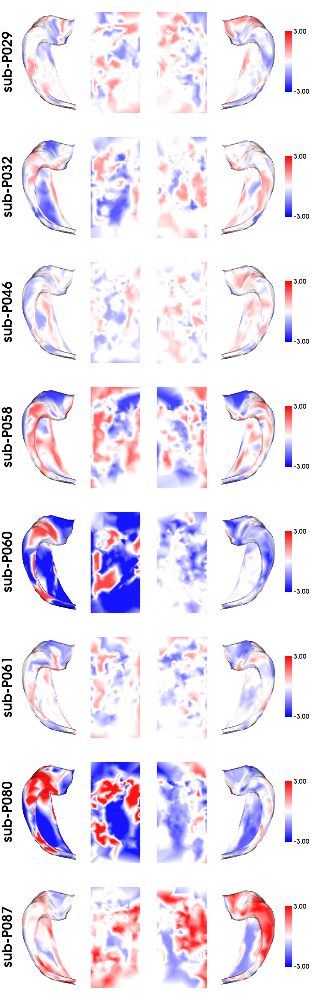

In [182]:
plotting.surfplot_canonical_foldunfold(reshape4surfplot(snsx_epi_zscore[0][snsx_mts_idxs[0]]),
                                  labels=['hipp'],
                                  den='2mm',
                                  tighten_cwindow=True, 
                                  embed_nb=True, 
                                  color_bar='right',
                                  share='row',
                                  cmap='bwr',
                                  color_range=(-3,3),
                                  label_text=snsx_epi_dfs[0].iloc[snsx_mts_idxs[0]]['participant_id'].to_list())


In [186]:
snsx_epi_dfs[1].iloc[snsx_mts_idxs[1]]['mri_mts_lateralization'].to_list()

[1.0, 1.0, 2.0, 3.0, 1.0, 3.0, 3.0]

/home/ROBARTS/myousif/virtualenvs/pcntoolkit_dev_cbs_venv/lib/python3.8/site-packages/brainspace-0.1.10-py3.8.egg/brainspace/plotting/base.py:287: UserWarning: Interactive mode requires 'panel'. Setting 'interactive=False'
  warnings.warn("Interactive mode requires 'panel'. "


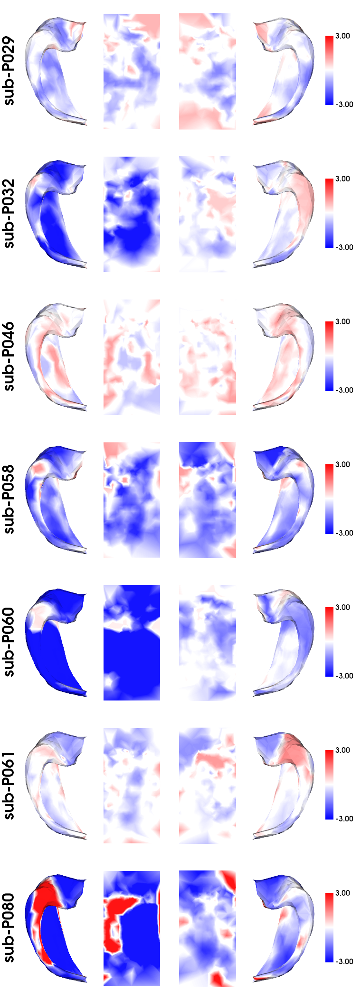

In [187]:
plotting.surfplot_canonical_foldunfold(reshape4surfplot(snsx_epi_zscore[1][snsx_mts_idxs[1]]),
                                  labels=['hipp'],
                                  den='2mm',
                                  tighten_cwindow=True, 
                                  embed_nb=True, 
                                  color_bar='right',
                                  share='row',
                                  cmap='bwr',
                                  color_range=(-3,3),
                                  label_text=snsx_epi_dfs[1].iloc[snsx_mts_idxs[1]]['participant_id'].to_list())


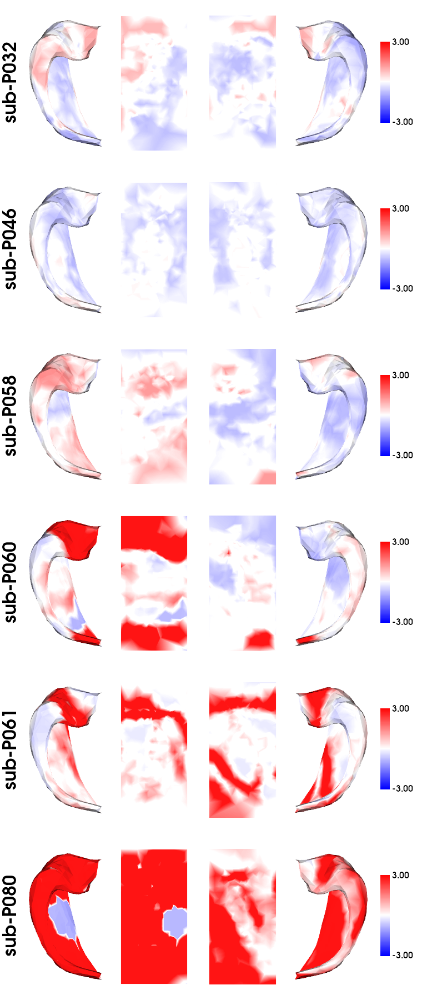

In [192]:
plotting.surfplot_canonical_foldunfold(reshape4surfplot(snsx_epi_zscore[2][snsx_mts_idxs[2]]),
                                  labels=['hipp'],
                                  den='2mm',
                                  tighten_cwindow=True, 
                                  embed_nb=True, 
                                  color_bar='right',
                                  share='row',
                                  cmap='bwr',
                                  color_range=(-3,3),
                                  label_text=snsx_epi_dfs[2].iloc[snsx_mts_idxs[2]]['participant_id'].to_list())


In [194]:
snsx_epi_dfs[3].iloc[snsx_mts_idxs[3]]['mri_mts_lateralization'].to_list()

[1.0, 2.0, 1.0, 3.0]

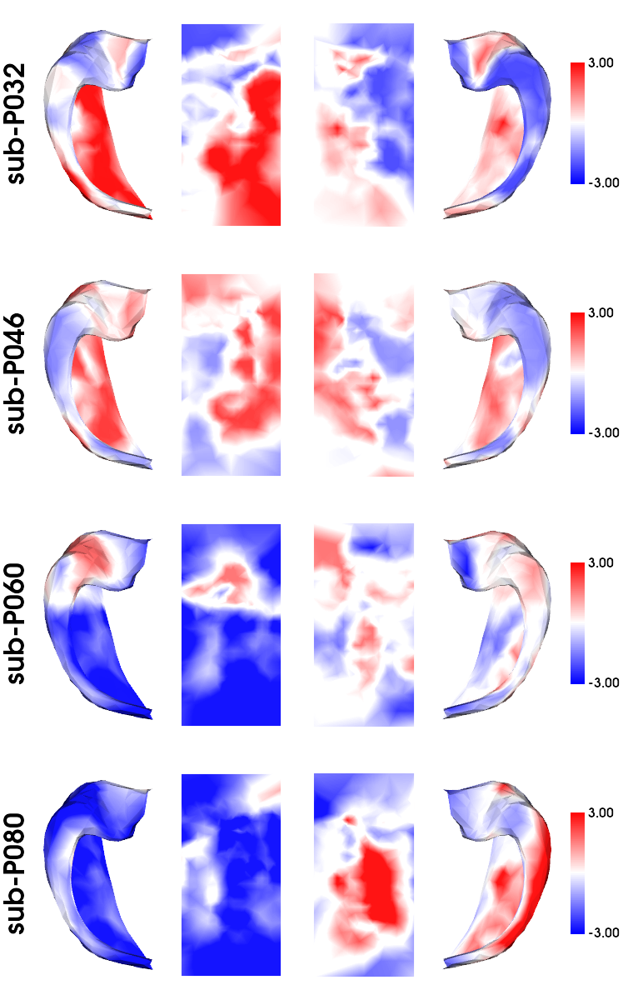

In [193]:
plotting.surfplot_canonical_foldunfold(reshape4surfplot(snsx_epi_zscore[3][snsx_mts_idxs[3]]),
                                  labels=['hipp'],
                                  den='2mm',
                                  tighten_cwindow=True, 
                                  embed_nb=True, 
                                  color_bar='right',
                                  share='row',
                                  cmap='bwr',
                                  color_range=(-3,3),
                                  label_text=snsx_epi_dfs[3].iloc[snsx_mts_idxs[3]]['participant_id'].to_list())


In [50]:
# (n,v) or (n, v, k) n = # of observations, v = # of vertices, k = # variates 
reshape4smooth = lambda arr: np.stack(np.split(arr.T,2))

In [51]:
snsx_dc_smooth_zscore =  [ mesh_smooth(reshape4smooth(arr), surf, 2) for arr in snsx_disease_ctrl_zscore]
snsx_epi_smooth_zscore =  [ mesh_smooth(reshape4smooth(arr),surf, 2) for arr in snsx_epi_zscore]

eplink_epi_smooth_zscore =  [ mesh_smooth(reshape4smooth(arr),surf,2) for arr in eplink_possibleTLE_zscore ] 

 2 x 44 surfaces to smooth, % remaining: 100 
Done
 2 x 44 surfaces to smooth, % remaining: 100 
Done
 2 x 44 surfaces to smooth, % remaining: 100 
Done
 2 x 25 surfaces to smooth, % remaining: 100 
Done
 2 x 25 surfaces to smooth, % remaining: 100 
Done
 2 x 41 surfaces to smooth, % remaining: 100 
Done
 2 x 40 surfaces to smooth, % remaining: 100 
Done
 2 x 38 surfaces to smooth, % remaining: 100 
Done
 2 x 19 surfaces to smooth, % remaining: 100 
Done
 2 x 19 surfaces to smooth, % remaining: 100 
Done
 2 x 63 surfaces to smooth, % remaining: 100 
Done
 2 x 63 surfaces to smooth, % remaining: 100 
Done
 2 x 30 surfaces to smooth, % remaining: 100 
Done
 2 x 30 surfaces to smooth, % remaining: 100 
Done


In [473]:
import xarray as xr

In [ ]:
xr.

In [ ]:
correlation(

In [471]:
snsx_epi_smooth_zscore[0].reshape(

(2, 419, 41)

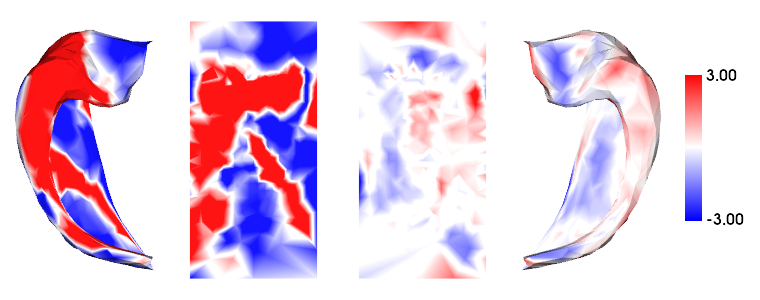

In [487]:
plotting.surfplot_canonical_foldunfold(reshape_1D(snsx_epi_zscore[0][30]),
                                  labels=['hipp'],
                                  den='2mm',
                                  tighten_cwindow=True, 
                                  embed_nb=True, 
                                  color_bar='right',
                                  share='row',
                                  cmap='bwr',
                                  color_range=(-3,3),)

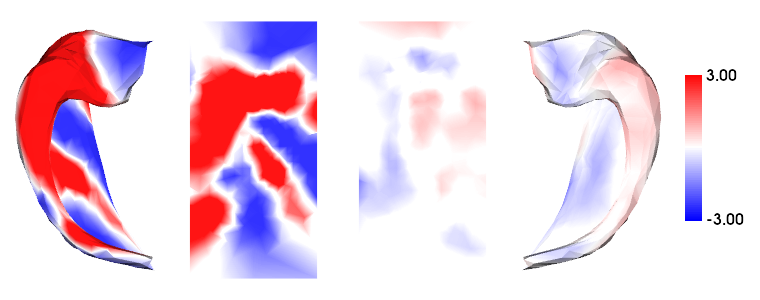

In [486]:
plotting.surfplot_canonical_foldunfold(reshape_1D(snsx_epi_smooth_zscore[0][:,:,30].flatten()),
                                  labels=['hipp'],
                                  den='2mm',
                                  tighten_cwindow=True, 
                                  embed_nb=True, 
                                  color_bar='right',
                                  share='row',
                                  cmap='bwr',
                                  color_range=(-3,3),)

/home/ROBARTS/myousif/virtualenvs/pcntoolkit_dev_cbs_venv/lib/python3.8/site-packages/brainspace-0.1.10-py3.8.egg/brainspace/plotting/base.py:287: UserWarning: Interactive mode requires 'panel'. Setting 'interactive=False'
  warnings.warn("Interactive mode requires 'panel'. "


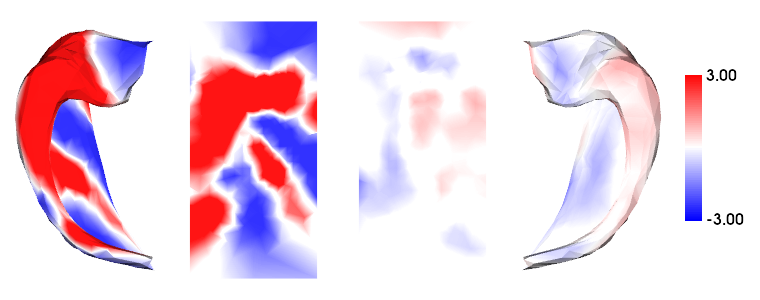

In [756]:
plotting.surfplot_canonical_foldunfold(reshape_1D(snsx_epi_smooth_zscore[0][:,:,30].flatten()),
                                  labels=['hipp'],
                                  den='2mm',
                                  tighten_cwindow=True, 
                                  embed_nb=True, 
                                  color_bar='right',
                                  share='row',
                                  cmap='bwr',
                                  color_range=(-3,3),)

In [517]:
snsx_epi_dfs[0][['TLE','dataset']]

,TLE,dataset
0,1.0,snsx
1,0.0,snsx
2,1.0,snsx
3,1.0,snsx
4,0.0,snsx
5,0.0,snsx
6,0.0,snsx
7,0.0,snsx
8,0.0,snsx
9,1.0,snsx


,participant_id,age,sex,handedness,focal_seizures,generalized_seizures,mesial_temporal_lobe_epilepsy,temporal_lobe_epilepsy,frontal_lobe_epilepsy,occipital_lobe_epilepsy,...,pathology_completed,ilae_hippocampal_sclerosis_classification,hippocampal_pathology_details,neocortical_pathology_details,paths,site_code,sex_code,mri_mts,mri_mts_location,TLE
0,sub-HSC0002,13.0,Female,Right,Checked,Unchecked,No,Possible,Possible,NaN,...,No,NaN,NaN,NaN,/home/ROBARTS/myousif/graham/scratch/norm_mode...,25,0,NaN,NaN,0.0
1,sub-HSC0006,10.0,Male,Right,Checked,Checked,No,Possible,No,Possible,...,Yes,No hippocampal sclerosis,NaN,Pathology demonstrated diffuse low grade astro...,/home/ROBARTS/myousif/graham/scratch/norm_mode...,25,1,0.0,0.0,0.0
2,sub-HSC0009,9.0,Female,Right,Checked,Unchecked,No,Probable,No,No,...,Yes,NaN,NaN,NaN,/home/ROBARTS/myousif/graham/scratch/norm_mode...,25,0,0.0,0.0,1.0
3,sub-HSC0016,17.0,Female,Right,Checked,Unchecked,No,Probable,Probable,No,...,Yes,NaN,NaN,NaN,/home/ROBARTS/myousif/graham/scratch/norm_mode...,25,0,0.0,0.0,1.0
4,sub-HSC0026,14.0,Female,Right,Checked,Unchecked,Possible,Possible,No,No,...,NaN,NaN,NaN,NaN,/home/ROBARTS/myousif/graham/scratch/norm_mode...,25,0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
58,sub-TWH0078,32.0,Male,Left,Checked,Unchecked,Definite,Definite,No,No,...,NaN,NaN,NaN,NaN,/home/ROBARTS/myousif/graham/scratch/norm_mode...,25,1,NaN,NaN,1.0
59,sub-TWH0081,41.0,Female,Right,Checked,Unchecked,Probable,Probable,Probable,No,...,NaN,NaN,NaN,NaN,/home/ROBARTS/myousif/graham/scratch/norm_mode...,25,0,NaN,NaN,1.0
60,sub-TWH0082,26.0,Male,Right,Checked,Unchecked,Possible,Definite,No,No,...,NaN,NaN,NaN,NaN,/home/ROBARTS/myousif/graham/scratch/norm_mode...,25,1,NaN,NaN,1.0
61,sub-TWH0085,54.0,Male,Right,Checked,Unchecked,No,Definite,No,No,...,NaN,NaN,NaN,NaN,/home/ROBARTS/myousif/graham/scratch/norm_mode...,25,1,NaN,NaN,1.0


In [529]:
eplink_possibleTLE_dfs[0][['TLE','dataset']]

,TLE,dataset
0,0.0,eplink
1,0.0,eplink
2,1.0,eplink
3,1.0,eplink
4,0.0,eplink
...,...,...
58,1.0,eplink
59,1.0,eplink
60,1.0,eplink
61,1.0,eplink


In [536]:
~thick_tle_bool.TLE.isna()

0     True
1     True
2     True
3     True
4     True
      ... 
58    True
59    True
60    True
61    True
62    True
Name: TLE, Length: 104, dtype: bool

TLE    dataset
False  False      74
dtype: int64

In [477]:
snsx_epi_dfs[0]['Engel_I=1']

0     1.0
1     0.0
2     1.0
3     0.0
4     0.0
5     0.0
6     0.0
7     0.0
8     0.0
9     1.0
10    1.0
11    0.0
12    1.0
13    1.0
14    1.0
15    0.0
16    NaN
17    NaN
18    0.0
19    1.0
20    0.0
21    NaN
22    1.0
23    NaN
24    NaN
25    1.0
26    0.0
27    NaN
28    0.0
29    0.0
30    1.0
31    0.0
32    NaN
33    0.0
34    NaN
35    0.0
36    NaN
37    NaN
38    NaN
39    NaN
40    NaN
Name: Engel_I=1, dtype: float64

In [ ]:
snsx_epi_dfs[0]['Engel_I=1']

In [45]:
eplink_possibleTLE_dfs[0].columns

Index(['participant_id', 'age', 'sex', 'handedness', 'focal_seizures',
       'generalized_seizures', 'mesial_temporal_lobe_epilepsy',
       'temporal_lobe_epilepsy', 'frontal_lobe_epilepsy',
       'occipital_lobe_epilepsy', 'parietal_lobe_epilepsy',
       'unknown_localization_focal_epilepsy', 'pet_abnormality',
       'pet_lateralization_temporal_lobe', 'pet_lateralization_frontal_lobe',
       'pet_lateralization_parietal_lobe', 'pet_lateralization_occipital_lobe',
       'spect_abnormality', 'spect_lateralization_temporal_lobe',
       'spect_lateralization_frontal_lobe',
       'spect_lateralization_parietal_lobe',
       'spect_lateralization_occipital_lobe', 'meg_spike_cluster',
       'mri_1.5T_abnormality', 'mri_1.5T_mts', 'mri_1.5T_mts_location',
       'mri_1.5T_fcd', 'mri_1.5T_fcd_location',
       'mri_1.5T_other_epileptogenic_lesion',
       'mri_1.5T_other_epileptogenic_lesion_location',
       'mri_1.5T_other_nonspecific_findings',
       'mri_1.5T_other_nonspecific_

In [46]:

tle_columns = ['participant_id','age','sex','TLE','dataset']
mts_columns = ['participant_id','age','sex','mri_mts','dataset']

thick_tle_bool = pd.concat([snsx_epi_dfs[0][tle_columns],eplink_possibleTLE_dfs[0][tle_columns]]).dropna()
thick_mts_bool = pd.concat([snsx_epi_dfs[0][mts_columns],eplink_possibleTLE_dfs[0][mts_columns]]).dropna()

gyr_tle_bool = pd.concat([snsx_epi_dfs[1][tle_columns],eplink_possibleTLE_dfs[1][tle_columns]]).dropna()
gyr_mts_bool = pd.concat([snsx_epi_dfs[1][mts_columns],eplink_possibleTLE_dfs[1][mts_columns]]).dropna()

myelin_tle_bool = snsx_epi_dfs[2][tle_columns].dropna()
myelin_mts_bool = snsx_epi_dfs[2][mts_columns].dropna()

fa_tle_bool = pd.concat([snsx_epi_dfs[3][tle_columns],eplink_possibleTLE_dfs[2][tle_columns]]).dropna()
fa_mts_bool = pd.concat([snsx_epi_dfs[3][mts_columns],eplink_possibleTLE_dfs[2][mts_columns]]).dropna()

md_tle_bool = pd.concat([snsx_epi_dfs[4][tle_columns],eplink_possibleTLE_dfs[3][tle_columns]]).dropna()
md_mts_bool = pd.concat([snsx_epi_dfs[4][mts_columns],eplink_possibleTLE_dfs[3][mts_columns]]).dropna()

tle_bools = [thick_tle_bool, 
             gyr_tle_bool,
             myelin_tle_bool,
             fa_tle_bool,
             md_tle_bool]

mts_bools = [thick_mts_bool,
             gyr_mts_bool,
             myelin_mts_bool,
             fa_mts_bool,
             md_mts_bool]

for idx, _ in enumerate(tle_bools):
    tle_bools[idx]['sex'] = tle_bools[idx]['sex'].replace('Female','f').replace('Male','m')
    mts_bools[idx]['sex'] = mts_bools[idx]['sex'].replace('Female','f').replace('Male','m')
    
    tle_bools[idx]['sex_code'] = tle_bools[idx]['sex'].replace('f',0).replace('m',1)
    mts_bools[idx]['sex_code'] = mts_bools[idx]['sex'].replace('f',0).replace('m',1)
    
    tle_bools[idx]['TLE_cat'] = tle_bools[idx]['TLE'].replace(1,'Yes').replace(0,'No')
    mts_bools[idx]['mri_mts_cat'] = mts_bools[idx]['mri_mts'].replace(1,'Yes').replace(0,'No')
    
    


In [47]:
ilae_col = ['ilae_1','ilae_2','ilae_3','ilae_4','ilae_5','ilae_6']
tle_columns = ['participant_id','age','sex','TLE','mri_mts','mri_mts_lateralization','dataset'] + ilae_col
mts_columns = ['participant_id','age','sex','TLE','mri_mts','mri_mts_lateralization','dataset'] + ilae_col

thick_tle_ilae_bool = snsx_epi_dfs[0][tle_columns][snsx_epi_dfs[0].TLE ==  1].dropna()
thick_mts_ilae_bool = snsx_epi_dfs[0][mts_columns][snsx_epi_dfs[0].mri_mts ==  1].dropna()

gyr_tle_ilae_bool = snsx_epi_dfs[1][tle_columns][snsx_epi_dfs[1].TLE ==  1].dropna()
gyr_mts_ilae_bool = snsx_epi_dfs[1][mts_columns][snsx_epi_dfs[1].mri_mts ==  1].dropna()

myelin_tle_ilae_bool = snsx_epi_dfs[2][tle_columns][snsx_epi_dfs[2].TLE ==  1].dropna()
myelin_mts_ilae_bool = snsx_epi_dfs[2][mts_columns][snsx_epi_dfs[2].mri_mts ==  1].dropna()

fa_tle_ilae_bool = snsx_epi_dfs[3][tle_columns][snsx_epi_dfs[3].TLE ==  1].dropna()
fa_mts_ilae_bool = snsx_epi_dfs[3][mts_columns][snsx_epi_dfs[3].mri_mts ==  1].dropna()

md_tle_ilae_bool = snsx_epi_dfs[4][tle_columns][snsx_epi_dfs[4].TLE ==  1].dropna()
md_mts_ilae_bool = snsx_epi_dfs[4][mts_columns][snsx_epi_dfs[4].mri_mts ==  1].dropna()

tle_ilae_bools = [thick_tle_ilae_bool, 
                 gyr_tle_ilae_bool,
                 myelin_tle_ilae_bool,
                 fa_tle_ilae_bool,
                 md_tle_ilae_bool]

mts_ilae_bools = [thick_mts_ilae_bool,
                 gyr_mts_ilae_bool,
                 myelin_mts_ilae_bool,
                 fa_mts_ilae_bool,
                 md_mts_ilae_bool]

for idx, _ in enumerate(tle_bools):
    tle_ilae_bools[idx]['sex'] = tle_ilae_bools[idx]['sex'].replace('Female','f').replace('Male','m')
    mts_ilae_bools[idx]['sex'] = mts_ilae_bools[idx]['sex'].replace('Female','f').replace('Male','m')
    
    tle_ilae_bools[idx]['sex_code'] = tle_ilae_bools[idx]['sex'].replace('f',0).replace('m',1)
    mts_ilae_bools[idx]['sex_code'] = mts_ilae_bools[idx]['sex'].replace('f',0).replace('m',1)
    
    tle_ilae_bools[idx]['TLE_cat'] = tle_ilae_bools[idx]['TLE'].replace(1,'Yes').replace(0,'No')
    tle_ilae_bools[idx]['mri_mts_cat'] = tle_ilae_bools[idx]['mri_mts'].replace(1,'Yes').replace(0,'No')
    mts_ilae_bools[idx]['mri_mts_cat'] = mts_ilae_bools[idx]['mri_mts'].replace(1,'Yes').replace(0,'No')
    
    
    tle_ilae_bools[idx][ilae_col] = tle_ilae_bools[idx][ilae_col].replace(1,'Yes').replace(0,'No')
    mts_ilae_bools[idx][ilae_col] = mts_ilae_bools[idx][ilae_col].replace(1,'Yes').replace(0,'No')
    
    


In [52]:
tle_zscores = [ np.concatenate([snsx_epi_smooth_zscore[0][:,:,tle_bools[0][tle_bools[0].dataset == 'snsx'].index],
                                eplink_epi_smooth_zscore[0][:,:,tle_bools[0][tle_bools[0].dataset == 'eplink'].index]],axis=2),
               np.concatenate([snsx_epi_smooth_zscore[1][:,:,tle_bools[1][tle_bools[1].dataset == 'snsx'].index],
                                eplink_epi_smooth_zscore[1][:,:,tle_bools[1][tle_bools[1].dataset == 'eplink'].index]],axis=2),
               snsx_epi_smooth_zscore[2][:,:,tle_bools[2][tle_bools[2].dataset == 'snsx'].index],
               np.concatenate([snsx_epi_smooth_zscore[3][:,:,tle_bools[3][tle_bools[3].dataset == 'snsx'].index],
                                eplink_epi_smooth_zscore[2][:,:,tle_bools[3][tle_bools[3].dataset == 'eplink'].index]],axis=2),
               np.concatenate([snsx_epi_smooth_zscore[4][:,:,tle_bools[4][tle_bools[4].dataset == 'snsx'].index],
                                eplink_epi_smooth_zscore[3][:,:,tle_bools[4][tle_bools[4].dataset == 'eplink'].index]],axis=2)
              ]

mts_zscores = [ np.concatenate([snsx_epi_smooth_zscore[0][:,:,mts_bools[0][mts_bools[0].dataset == 'snsx'].index],
                                eplink_epi_smooth_zscore[0][:,:,mts_bools[0][mts_bools[0].dataset == 'eplink'].index]],axis=2),
               np.concatenate([snsx_epi_smooth_zscore[1][:,:,mts_bools[1][mts_bools[1].dataset == 'snsx'].index],
                                eplink_epi_smooth_zscore[1][:,:,mts_bools[1][mts_bools[1].dataset == 'eplink'].index]],axis=2),
               snsx_epi_smooth_zscore[2][:,:,mts_bools[2][mts_bools[2].dataset == 'snsx'].index],
               np.concatenate([snsx_epi_smooth_zscore[3][:,:,mts_bools[3][mts_bools[3].dataset == 'snsx'].index],
                                eplink_epi_smooth_zscore[2][:,:,mts_bools[3][mts_bools[3].dataset == 'eplink'].index]],axis=2),
               np.concatenate([snsx_epi_smooth_zscore[4][:,:,mts_bools[4][mts_bools[4].dataset == 'snsx'].index],
                                eplink_epi_smooth_zscore[3][:,:,mts_bools[4][mts_bools[4].dataset == 'eplink'].index]],axis=2)
              ]

In [53]:
tle_ilae_zscores = [ snsx_epi_smooth_zscore[0][:,:,tle_ilae_bools[0].index],
               snsx_epi_smooth_zscore[1][:,:,tle_ilae_bools[1].index],
               snsx_epi_smooth_zscore[2][:,:,tle_ilae_bools[2].index],
               snsx_epi_smooth_zscore[3][:,:,tle_ilae_bools[3].index],
               snsx_epi_smooth_zscore[4][:,:,tle_ilae_bools[4].index],
              ]

In [54]:
tle_zscores_mixed = [ np.concatenate([arr[0],arr[1]],axis=1) for arr in tle_zscores ]
mts_zscores_mixed = [ np.concatenate([arr[0],arr[1]],axis=1) for arr in mts_zscores ]

In [55]:
tle_ilae_zscores_mixed = [ np.concatenate([arr[0],arr[1]],axis=1) for arr in tle_ilae_zscores ]

In [56]:
tle_ilae_zscores_mixed[0].shape

(419, 28)

In [57]:
tle_bools_mixed = []
mts_bools_mixed = []
tle_ilae_bools_mixed = []

for idx, _ in enumerate(tle_bools):
    
    tle_df = tle_bools[idx].copy()
    mts_df = mts_bools[idx].copy()
    tle_ilae_df = tle_ilae_bools[idx].copy()
    
    tle_mixed_list = []
    mts_mixed_list = []
    tle_ilae_mixed_list = []
    
    for hemi in ['L','R']:
        tle_df['hemi'] = [hemi] * tle_df.shape[0]
        tle_mixed_list.append(tle_df.copy())

        
        mts_df['hemi'] = [hemi] * mts_df.shape[0]
        mts_mixed_list.append(mts_df.copy())
        
        tle_ilae_df['hemi'] = [hemi] * tle_ilae_df.shape[0]
        tle_ilae_mixed_list.append(tle_ilae_df.copy())
        
    tle_bools_mixed.append(pd.concat(tle_mixed_list))
    mts_bools_mixed.append(pd.concat(mts_mixed_list))
    tle_ilae_bools_mixed.append(pd.concat(tle_ilae_mixed_list))


In [119]:
ipsi_df = pd.concat([snsx_vol_df, eplink_vol_df])

In [120]:
ipsi_df

,participant_id,hemi,ipsilateral_mts,ipsilateral_TLE,ipsilateral_TLE_non_epi (TLE=1/non-tle-epi=0),ipsilateral_mts_non_tle_epi (TLE=1/non-tle-epi=0),dataset
0,sub-P065,L,NaN,NaN,0.0,NaN,snsx
1,sub-P065,R,NaN,NaN,0.0,NaN,snsx
2,sub-P072,L,0.0,1.0,1.0,NaN,snsx
3,sub-P072,R,0.0,1.0,1.0,NaN,snsx
4,sub-P100,L,0.0,1.0,1.0,NaN,snsx
...,...,...,...,...,...,...,...
195,sub-LHS0004,R,0.0,NaN,NaN,NaN,eplink
196,sub-TWH0072,L,NaN,NaN,NaN,0.0,eplink
197,sub-TWH0072,R,NaN,NaN,NaN,0.0,eplink
198,sub-LHS0038,L,0.0,NaN,NaN,NaN,eplink


In [121]:
for idx, _ in enumerate(tle_bools_mixed):
    tle_bools_mixed[idx] = pd.merge(tle_bools_mixed[idx],ipsi_df,on=['participant_id','hemi','dataset'],how='left')
    mts_bools_mixed[idx] = pd.merge(mts_bools_mixed[idx],ipsi_df,on=['participant_id','hemi','dataset'],how='left')
    tle_ilae_bools_mixed[idx] = pd.merge(tle_ilae_bools_mixed[idx],ipsi_df,on=['participant_id','hemi','dataset'],how='left')

In [71]:
for idx in range(len(tle_bools_mixed)):
    tle_bools_mixed

5

In [104]:
tle_bools_mixed

[    participant_id   age sex  TLE dataset  sex_code TLE_cat hemi  \
 0         sub-P008  26.0   f  1.0    snsx         0     Yes    L   
 1         sub-P012  28.0   m  0.0    snsx         1      No    L   
 2         sub-P013  37.0   f  1.0    snsx         0     Yes    L   
 3         sub-P014  33.0   m  1.0    snsx         1     Yes    L   
 4         sub-P015  19.0   f  0.0    snsx         0      No    L   
 ..             ...   ...  ..  ...     ...       ...     ...  ...   
 145    sub-TWH0078  32.0   m  1.0  eplink         1     Yes    R   
 146    sub-TWH0081  41.0   f  1.0  eplink         0     Yes    R   
 147    sub-TWH0082  26.0   m  1.0  eplink         1     Yes    R   
 148    sub-TWH0085  54.0   m  1.0  eplink         1     Yes    R   
 149    sub-TWH0086  27.0   m  1.0  eplink         1     Yes    R   
 
      ipsilateral_mts  ipsilateral_lateralization  ipsilateral_TLE  \
 0                0.0                         0.0              0.0   
 1                0.0         

In [58]:

tle_models = []
tle_contrasts = []

mts_models = []
mts_contrasts = []

tle_no_age_sex_models = []
mts_no_age_sex_models = []



tle_mixed_models = []
tle_mixed_contrasts = []

mts_mixed_models = []
mts_mixed_contrasts = []

tle_no_age_sex_mixed_models = []
mts_no_age_sex_mixed_models = []


tle_ilae_mixed_models = []
tle_ilae_no_age_sex_mixed_models = []

tle_mts_ilae_mixed_models = []
tle_mts_ilae_no_age_sex_mixed_models = []

tle_ilae_mixed_contrasts = []

for idx, tle_df in enumerate(tle_bools):
    tle_model = FixedEffect(tle_df.age) + FixedEffect(tle_df.sex) + FixedEffect(tle_df.TLE_cat)
    tle_contrast = (tle_df.TLE_cat == 'Yes').astype(int) - (tle_df.TLE_cat == 'No').astype(int)
    
    tle_models.append(tle_model)
    tle_contrasts.append(tle_contrast)
    
    mts_df = mts_bools[idx]
    
    mts_model = FixedEffect(mts_df.age) + FixedEffect(mts_df.sex) + FixedEffect(mts_df.mri_mts_cat)
    mts_contrast = (mts_df.mri_mts_cat == 'Yes').astype(int) - (mts_df.mri_mts_cat == 'No').astype(int)
    
    mts_models.append(mts_model)
    mts_contrasts.append(mts_contrast)
    
    tle_no_age_sex_model = FixedEffect(tle_df.TLE_cat)
    tle_no_age_sex_models.append(tle_no_age_sex_model)

    
    mts_no_age_sex_model = FixedEffect(mts_df.mri_mts_cat)
    mts_no_age_sex_models.append(mts_no_age_sex_model)

    
    # mixed effect models
    tle_mixed_df = tle_bools_mixed[idx]
    mts_mixed_df = mts_bools_mixed[idx]
    
    tle_mx_model = FixedEffect(tle_mixed_df.age) + FixedEffect(tle_mixed_df.sex) + FixedEffect(tle_mixed_df.TLE_cat) + FixedEffect(tle_mixed_df.hemi) + MixedEffect(tle_mixed_df.participant_id)
    tle_mx_contrast = (tle_mixed_df.TLE_cat == 'Yes').astype(int) - (tle_mixed_df.TLE_cat == 'No').astype(int)
    
    mts_mx_model = FixedEffect(mts_mixed_df.age) + FixedEffect(mts_mixed_df.sex) + FixedEffect(mts_mixed_df.mri_mts_cat) + FixedEffect(mts_mixed_df.hemi) + MixedEffect(mts_mixed_df.participant_id)
    mts_mx_contrast = (mts_mixed_df.mri_mts_cat == 'Yes').astype(int) - (mts_mixed_df.mri_mts_cat == 'No').astype(int)
    
    
    tle_no_age_sex_mx_model = FixedEffect(tle_mixed_df.TLE_cat) + FixedEffect(tle_mixed_df.hemi) + MixedEffect(tle_mixed_df.participant_id)
    mts_no_age_sex_mx_model = FixedEffect(mts_mixed_df.mri_mts_cat) + FixedEffect(mts_mixed_df.hemi) + MixedEffect(mts_mixed_df.participant_id)
    

    tle_mixed_models.append(tle_mx_model)
    mts_mixed_models.append(mts_mx_model)
    
    tle_mixed_contrasts.append(tle_mx_contrast)
    mts_mixed_contrasts.append(mts_mx_contrast)
    
    tle_no_age_sex_mixed_models.append(tle_no_age_sex_mx_model)
    mts_no_age_sex_mixed_models.append(mts_no_age_sex_mx_model)
    
    # ilae_mixed effect model
    tle_ilae_mx_df = tle_ilae_bools_mixed[idx]
    
    tle_ilae_mx_model = FixedEffect(tle_ilae_mx_df.age) + FixedEffect(tle_ilae_mx_df.sex) + FixedEffect(tle_ilae_mx_df.ilae_1) + FixedEffect(tle_ilae_mx_df.hemi) + MixedEffect(tle_ilae_mx_df.participant_id)
    tle_ilae_no_age_sex_mx_model = FixedEffect(tle_ilae_mx_df.ilae_1) + FixedEffect(tle_ilae_mx_df.hemi) + MixedEffect(tle_ilae_mx_df.participant_id)

    tle_mts_ilae_mx_model = tle_ilae_mx_model + FixedEffect(tle_ilae_mx_df.mri_mts_cat) 
    tle_mts_ilae_no_age_sex_mx_model = tle_ilae_no_age_sex_mx_model + FixedEffect(tle_ilae_mx_df.mri_mts_cat) + FixedEffect(tle_ilae_mx_df.hemi) + MixedEffect(tle_ilae_mx_df.participant_id)
    
    tle_ilae_mx_contrast = (tle_ilae_mx_df.ilae_1 == 'Yes').astype(int) - (tle_ilae_mx_df.ilae_1 == 'No').astype(int)
    
    tle_ilae_mixed_models.append(tle_ilae_mx_model)
    tle_ilae_no_age_sex_mixed_models.append(tle_ilae_no_age_sex_mx_model)
    
    tle_mts_ilae_mixed_models.append(tle_mts_ilae_mx_model)
    tle_mts_ilae_no_age_sex_mixed_models.append(tle_mts_ilae_no_age_sex_mx_model)

    tle_ilae_mixed_contrasts.append(tle_ilae_mx_contrast)


In [109]:
tle_bools_mixed[0]['ipsilateral_TLE_control (TLE=1/cntrl=0)'].value_counts()

1.0    28
Name: ipsilateral_TLE_control (TLE=1/cntrl=0), dtype: int64

In [59]:
reshape_zscores = lambda zscore_arr: zscore_arr.reshape(-1,zscore_arr.shape[-1]).T
reshape_zscores_mx = lambda zscore_arr: np.concatenate(np.split(reshape_zscores(zscore_arr),2,axis=1)) 

In [60]:
slm_tle_list = []
for idx, _ in enumerate(tle_models):

    slm_tle = SLM(
        tle_models[idx],
        tle_contrasts[idx],
        surf=surf,
        correction=['fdr','rft'],
        cluster_threshold=0.01)

    slm_tle.fit(reshape_zscores(tle_zscores[idx]))
    
    slm_tle_list.append(slm_tle)


In [269]:
slm_noagesex_tle_list = []
for idx, _ in enumerate(tle_models):

    slm_noagesex_tle = SLM(
        tle_no_age_sex_models[idx],
        tle_contrasts[idx],
        surf=surf,
        correction=['fdr','rft'],
        cluster_threshold=0.01)

    slm_noagesex_tle.fit(reshape_zscores(tle_zscores[idx]))
    
    slm_noagesex_tle_list.append(slm_noagesex_tle)

In [270]:
slm_mts_list = []
for idx, _ in enumerate(mts_models):

    slm_mts = SLM(
        mts_models[idx],
        mts_contrasts[idx],
        surf=surf,
        correction=['fdr','rft'],
        cluster_threshold=0.01)

    slm_mts.fit(reshape_zscores(mts_zscores[idx]))
    
    slm_mts_list.append(slm_mts)


In [271]:
slm_noagesex_mts_list = []
for idx, _ in enumerate(mts_models):

    slm_noagesex_mts = SLM(
        mts_no_age_sex_models[idx],
        mts_contrasts[idx],
        surf=surf,
        correction=['fdr','rft'],
        cluster_threshold=0.01)

    slm_noagesex_mts.fit(reshape_zscores(mts_zscores[idx]))
    
    slm_noagesex_mts_list.append(slm_noagesex_mts)

In [272]:
slm_tle_mx_list = []

for idx, _ in enumerate(tle_mixed_models):

    slm_tle_mx = SLM(
        tle_mixed_models[idx],
        tle_mixed_contrasts[idx],
        surf=surf,
        correction=['fdr','rft'],
        cluster_threshold=0.01)

    slm_tle_mx.fit(reshape_zscores_mx(tle_zscores[idx]))
    
    slm_tle_mx_list.append(slm_tle_mx)

In [273]:
slm_mts_mx_list = []

for idx, _ in enumerate(mts_mixed_models):

    slm_mts_mx = SLM(
        mts_mixed_models[idx],
        mts_mixed_contrasts[idx],
        surf=surf,
        correction=['fdr','rft'],
        cluster_threshold=0.01)

    slm_mts_mx.fit(reshape_zscores_mx(mts_zscores[idx]))
    
    slm_mts_mx_list.append(slm_mts_mx)

In [1352]:
slm_mts_mx_noagesex_list[2].P['clus']

[   clusid  nverts    resels         P
 0       1    31.0  0.480945  0.033315
 1       2     5.0  0.050866  0.116462
 2       3     1.0  0.002185  0.134612,
 Empty DataFrame
 Columns: [clusid, nverts, resels, P]
 Index: []]

In [1354]:
mts_no_age_sex_mixed_models[2]

,intercept,mri_mts_cat_No,mri_mts_cat_Yes,hemi_L,hemi_R
0,1,1,0,1,0
1,1,1,0,1,0
2,1,1,0,1,0
3,1,1,0,1,0
4,1,1,0,1,0
...,...,...,...,...,...
67,1,1,0,0,1
68,1,1,0,0,1
69,1,1,0,0,1
70,1,1,0,0,1


In [274]:
slm_tle_mx_noagesex_list = []

for idx, _ in enumerate(tle_no_age_sex_mixed_models):

    slm_tle_mx_noagesex = SLM(
        tle_no_age_sex_mixed_models[idx],
        tle_mixed_contrasts[idx],
        surf=surf,
        correction=['fdr','rft'],
        cluster_threshold=0.01)

    slm_tle_mx_noagesex.fit(reshape_zscores_mx(tle_zscores[idx]))
    
    slm_tle_mx_noagesex_list.append(slm_tle_mx_noagesex)

In [598]:
slm_mts_mx_noagesex_list = []

for idx, _ in enumerate(mts_no_age_sex_mixed_models):

    slm_mts_mx_noagesex = SLM(
        mts_no_age_sex_mixed_models[idx],
        mts_mixed_contrasts[idx],
        surf=surf,
        correction=['fdr','rft'],
        cluster_threshold=0.01)

    slm_mts_mx_noagesex.fit(reshape_zscores_mx(mts_zscores[idx]))
    
    slm_mts_mx_noagesex_list.append(slm_mts_mx_noagesex)

In [610]:
mts_no_age_sex_mixed_models[0].shape

(128, 5, 16384, 2)

In [613]:
reshape_zscores_mx(mts_zscores[0]).shape

(128, 419)

In [611]:
mts_mixed_contrasts[0].shape

(128,)

In [580]:
tle_ilae_zscores_mixed[0].shape

(419, 28)

In [589]:
tle_ilae_zscores_mixed[idx].T.shape

(28, 419)

In [632]:
tle_ilae_mixed_contrasts[idx].shape

(28,)

In [630]:
tle_ilae_mixed_models[idx].shape

(28, 8, 784, 2)

In [629]:
reshape_zscores_mx(tle_ilae_zscores[idx]).shape

(28, 419)

In [640]:
reshape_zscores_mx(tle_ilae_zscores[idx]).shape

(28, 419)

In [688]:
tle_ilae_mixed_models[idx]

,intercept,age,sex_f,sex_m,ilae_1_No,ilae_1_Yes,hemi_L,hemi_R
0,1,26.0,1,0,0,1,1,0
1,1,37.0,1,0,0,1,1,0
2,1,33.0,0,1,1,0,1,0
3,1,36.0,1,0,0,1,1,0
4,1,40.0,0,1,1,0,1,0
5,1,44.0,1,0,0,1,1,0
6,1,24.0,0,1,1,0,1,0
7,1,21.0,1,0,0,1,1,0
8,1,45.0,0,1,1,0,1,0
9,1,59.0,1,0,0,1,1,0


In [692]:
np.concatenate([tle_ilae_mixed_contrasts[idx],tle_ilae_mixed_contrasts[idx]]).shape

(28,)

In [693]:
tle_ilae_mixed_models[idx]

,intercept,age,sex_f,sex_m,ilae_1_No,ilae_1_Yes,hemi_L,hemi_R
0,1,26.0,1,0,0,1,1,0
1,1,37.0,1,0,0,1,1,0
2,1,33.0,0,1,1,0,1,0
3,1,36.0,1,0,0,1,1,0
4,1,40.0,0,1,1,0,1,0
5,1,44.0,1,0,0,1,1,0
6,1,24.0,0,1,1,0,1,0
7,1,21.0,1,0,0,1,1,0
8,1,45.0,0,1,1,0,1,0
9,1,59.0,1,0,0,1,1,0


In [700]:
tle_ilae_mixed_contrasts[idx].shape

(28,)

In [701]:
tle_ilae_mixed_models[idx].shape

(28, 8, 784, 2)

In [703]:
reshape_zscores_mx(tle_ilae_zscores[idx]).shape

(28, 419)

In [705]:
slm_ilae_tle_mx_list = []

for idx, _ in enumerate(tle_ilae_mixed_models):

    slm_ilae_tle_mx = SLM(
        tle_ilae_mixed_models[idx],
        tle_ilae_mixed_contrasts[idx],
        surf=surf,
        correction=['fdr','rft'],
        cluster_threshold=0.01)

    slm_ilae_tle_mx.fit(reshape_zscores_mx(tle_ilae_zscores[idx]))
    
    slm_ilae_tle_mx_list.append(slm_ilae_tle_mx)

In [738]:
slm_ilae_noagesex_tle_mx_list = []

for idx, _ in enumerate(tle_ilae_mixed_models):

    slm_ilae_noagesex_tle_mx = SLM(
        tle_ilae_no_age_sex_mixed_models[idx],
        tle_ilae_mixed_contrasts[idx],
        surf=surf,
        correction=['fdr','rft'],
        cluster_threshold=0.01)

    slm_ilae_noagesex_tle_mx.fit(reshape_zscores_mx(tle_ilae_zscores[idx]))
    
    slm_ilae_noagesex_tle_mx_list.append(slm_ilae_noagesex_tle_mx)

In [1400]:
tle_ilae_bools[1].ilae_1.value_counts()

Yes    8
No     5
Name: ilae_1, dtype: int64

In [799]:
slm_ilae_noagesex_tle_mx_list = []

for idx, _ in enumerate(tle_ilae_mixed_models):

    slm_ilae_noagesex_tle_mx = SLM(
        tle_ilae_no_age_sex_mixed_models[idx],
        tle_ilae_mixed_contrasts[idx],
        surf=surf,
        correction=['fdr','rft'],
        cluster_threshold=0.01)

    slm_ilae_noagesex_tle_mx.fit(reshape_zscores_mx(tle_ilae_zscores[idx]))
    
    slm_ilae_noagesex_tle_mx_list.append(slm_ilae_noagesex_tle_mx)

In [ ]:
tle_il

In [807]:
reshape_zscores_mx(tle_ilae_zscores[idx]).shape

(14, 419)

In [800]:
tle_mts_ilae_mixed_models[0]

,intercept,age,sex_f,sex_m,ilae_1_No,ilae_1_Yes,hemi_L,hemi_R,mri_mts_cat_No,mri_mts_cat_Yes
0,1,26.0,1,0,0,1,1,0,1,0
1,1,37.0,1,0,0,1,1,0,1,0
2,1,33.0,0,1,1,0,1,0,1,0
3,1,36.0,1,0,0,1,1,0,1,0
4,1,40.0,0,1,1,0,1,0,0,1
5,1,44.0,1,0,0,1,1,0,1,0
6,1,24.0,0,1,1,0,1,0,0,1
7,1,21.0,1,0,0,1,1,0,0,1
8,1,45.0,0,1,1,0,1,0,0,1
9,1,59.0,1,0,0,1,1,0,0,1


In [803]:
tle_ilae_mixed_contrasts[0].shape

(28,)

In [810]:
tle_ilae_zscores[idx].shape

(2, 419, 7)

In [817]:
reshape_zscores_mx(tle_ilae_zscores[idx]).shape

(14, 419)

In [829]:
tle_ilae_zscores[0].shape

(2, 419, 14)

In [831]:
tle_ilae_zscores[0][0,:,:].shape

(419, 14)

In [832]:
tle_ilae_zscores[idx][0].shape

(419, 7)

In [842]:
np.concatenate([tle_ilae_zscores[idx][0,:,:].T,tle_ilae_zscores[idx][1,:,:].T]).shape

(14, 419)

In [1397]:
tle_mts_ilae_mixed_models[1]

,intercept,age,sex_f,sex_m,ilae_1_No,ilae_1_Yes,hemi_L,hemi_R,mri_mts_cat_No,mri_mts_cat_Yes
0,1,26.0,1,0,0,1,1,0,1,0
1,1,37.0,1,0,0,1,1,0,1,0
2,1,33.0,0,1,1,0,1,0,1,0
3,1,36.0,1,0,0,1,1,0,1,0
4,1,40.0,0,1,1,0,1,0,0,1
5,1,44.0,1,0,0,1,1,0,1,0
6,1,24.0,0,1,1,0,1,0,0,1
7,1,21.0,1,0,0,1,1,0,0,1
8,1,45.0,0,1,1,0,1,0,0,1
9,1,59.0,1,0,0,1,1,0,0,1


In [845]:
slm_ilae_tle_mts_mx_list = []

for idx, _ in enumerate(tle_ilae_mixed_models):

    slm_ilae_tle_mts_mx = SLM(
        tle_mts_ilae_mixed_models[idx],
        tle_ilae_mixed_contrasts[idx],
        surf=surf,
        correction=['fdr','rft'],
        cluster_threshold=0.01)

    slm_ilae_tle_mts_mx.fit(np.concatenate([tle_ilae_zscores[idx][0,:,:].T,tle_ilae_zscores[idx][1,:,:].T]))
    
    slm_ilae_tle_mts_mx_list.append(slm_ilae_tle_mts_mx)
    print(idx)

0
1
2
3


/home/ROBARTS/myousif/virtualenvs/pcntoolkit_dev_cbs_venv/lib/python3.8/site-packages/brainstat/stats/_multiple_comparisons.py:725: RuntimeWarning: overflow encountered in scalar power
  b1 = a * np.log((1 - (1 - 0.000001) ** (2 / (df2 - d))) * df2 / 2)
/home/ROBARTS/myousif/virtualenvs/pcntoolkit_dev_cbs_venv/lib/python3.8/site-packages/brainstat/stats/_multiple_comparisons.py:725: RuntimeWarning: invalid value encountered in log
  b1 = a * np.log((1 - (1 - 0.000001) ** (2 / (df2 - d))) * df2 / 2)


ValueError: cannot convert float NaN to integer

In [744]:
slm_ilae_noagesex_tle_mx_list[1].P['clus']

[   clusid  nverts    resels         P
 0       1    25.0  0.578815  0.056238
 1       2     1.0  0.204927  0.178367
 2       3     1.0  0.081839  0.273597,
 Empty DataFrame
 Columns: [clusid, nverts, resels, P]
 Index: []]

In [718]:
slm_ilae_tle_mx_list[1].P['clus']

[   clusid  nverts    resels         P
 0       1    66.0  1.324252  0.008780
 1       2     6.0  0.290633  0.128937
 2       3     2.0  0.027983  0.339943
 3       4     2.0  0.015272  0.357728,
   clusid nverts                resels                   P
 0      1    1.0  0.054234463520180166  0.3063255521977869]

In [853]:
modalities = ['Merker', 'PLI-transmittance', 'Blockface', 'Bieloschowsky', 'Calbindin', 'Calretinin', 'Parvalbumin', 'Thionin']#, 'ProtonDensity', 'qR1', 'qR2star']

In [856]:
np.load('/home/ROBARTS/myousif/software/hippomaps/resources/

ImportError: cannot import name 'get_maps' from 'hippomaps.fetcher' (/home/ROBARTS/myousif/software/hippomaps/hippomaps/fetcher.py)

<AxesSubplot: ylabel='Density'>

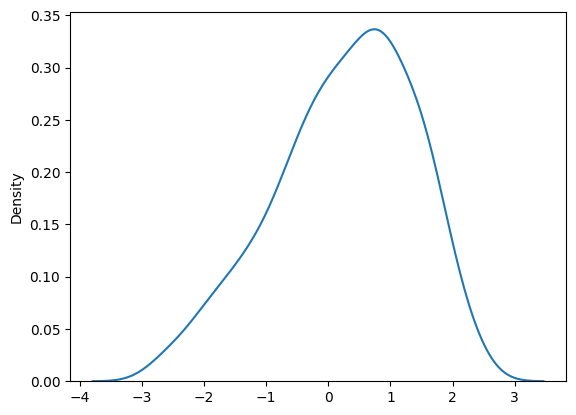

In [715]:
sns.kdeplot(x=slm_ilae_tle_mx_list[1].t.flatten())

/home/ROBARTS/myousif/virtualenvs/pcntoolkit_dev_cbs_venv/lib/python3.8/site-packages/brainspace-0.1.10-py3.8.egg/brainspace/plotting/base.py:287: UserWarning: Interactive mode requires 'panel'. Setting 'interactive=False'
  warnings.warn("Interactive mode requires 'panel'. "


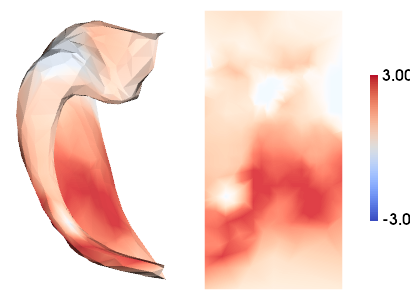

In [1358]:
plotting.surfplot_canonical_foldunfold(reshape_1D_hemi(slm_ilae_noagesex_tle_mx_list[1].t),
                                  labels=['hipp'],
                                  hemis=['L'],
                                  den='2mm',
                                  tighten_cwindow=True, 
                                  embed_nb=True, 
                                  color_bar='right',
                                  share='row',
                                  cmap='coolwarm',
                                  color_range=(-3,3)
                              )

In [1360]:
slm_ilae_noagesex_tle_mx_list[1].P['clus']

[   clusid  nverts    resels         P
 0       1    25.0  0.578815  0.056238
 1       2     1.0  0.204927  0.178367
 2       3     1.0  0.081839  0.273597,
 Empty DataFrame
 Columns: [clusid, nverts, resels, P]
 Index: []]

In [ ]:
plotting.surfplot_canonical_foldunfold(reshape_1D_hemi(slm_ilae_noagesex_tle_mx_list[1].t),
                                  labels=['hipp'],
                                  hemis=['L'],
                                  den='2mm',
                                  tighten_cwindow=True, 
                                  embed_nb=True, 
                                  color_bar='right',
                                  share='row',
                                  cmap='coolwarm',
                                  color_range=(-3,3)
                              )

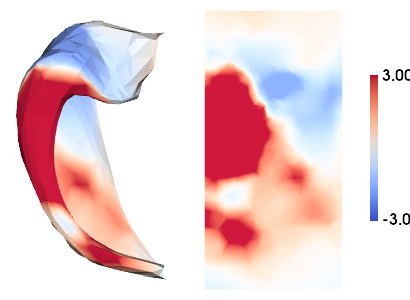

In [1357]:
plotting.surfplot_canonical_foldunfold(reshape_1D_hemi(slm_ilae_tle_mx_list[1].t),
                                  labels=['hipp'],
                                  hemis=['L'],
                                  den='2mm',
                                  tighten_cwindow=True, 
                                  embed_nb=True, 
                                  color_bar='right',
                                  share='row',
                                  cmap='coolwarm',
                                  color_range=(-3,3)
                              )

In [1401]:
plotting.surfplot_canonical_foldunfold(reshape_1D_hemi(slm_ilae_tle_mx_list[1].P['clusid']==1),
                                  labels=['hipp'],
                                  hemis=['L'],
                                  den='2mm',
                                  tighten_cwindow=True, 
                                  embed_nb=True, 
                                  color_bar='right',
                                  share='row',
           
                              )

AttributeError: 'bool' object has no attribute 'flatten'

In [ ]:
sns.scatterplot

In [896]:
histology['PLI']

array([ 1.80378179e+00,  1.92152104e+00,  3.56001889e-01,  6.96931085e-01,
        1.65665201e+00,  1.35787153e-01,  2.09214463e+00, -1.99436265e-01,
        2.38504834e+00,  1.71158147e+00, -6.90069550e-02,  2.45055130e+00,
        1.28730721e-01,  1.05190619e+00,  6.47466614e-01, -1.80021990e-01,
        1.03399324e+00,  1.19055283e+00,  1.54858057e+00, -1.02638390e+00,
        6.67782226e-01,  4.67295688e-01,  8.94931664e-01, -1.93833108e-01,
       -4.57739621e-03,  2.36696075e-01,  1.05801559e+00,  1.11764437e+00,
        1.61712960e+00,  6.62431046e-01,  4.11373761e-01,  4.94206490e-01,
       -5.01288929e-03, -1.17487153e+00, -1.83208579e-01,  7.79522024e-01,
        6.82031072e-01,  9.86421123e-01,  4.42333195e-01,  3.68930357e-01,
        2.77488434e-01, -1.19117124e+00,  5.24586043e-01,  2.91898879e-01,
        6.52456971e-01,  7.95653516e-01,  1.18612119e+00,  2.36612275e-01,
        2.41949670e-01, -9.70056732e-01, -6.22139191e-01,  7.73797180e-01,
        3.88069503e-02,  

In [899]:
slm_ilae_tle_mx_list[1].t.shape

(1, 419)

<AxesSubplot: >

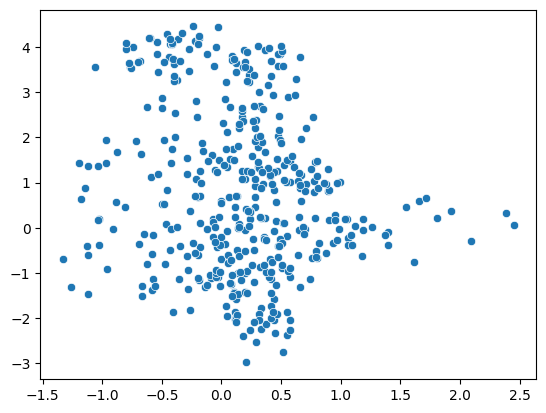

In [902]:
sns.scatterplot(y = slm_ilae_tle_mx_list[1].t.flatten(), x=histology['PLI'])

In [936]:
histo_list = list(histology.values())
histo_names = list(histology.keys())

In [937]:


# Plot the correlation between the t-stat
def plot_tstat_corr(x, y, ylabel='histology z-score', xlabel="t-statistic", xtextcoord=2.3, ytextcoord=2):
    df = pd.DataFrame({"x": x.flatten(), "y": y.flatten()})
    df.dropna(inplace=True)
    plt.scatter(df.x, df.y, s=5, c="k")
    plt.xticks(fontsize=14)
    plt.yticks(fontsize=14)
    plt.xlabel(xlabel, fontdict={"fontsize": 16})
    plt.ylabel(ylabel, fontdict={"fontsize": 16})
    plt.plot(np.unique(df.x), np.poly1d(np.polyfit(df.x, df.y, 1))(np.unique(df.x)), "k")
    plt.text(xtextcoord, ytextcoord, f"r={df.x.corr(df.y):.2f}", fontdict={"size": 14})
    plt.gcf().subplots_adjust(left=0.15)
    plt.show()



In [993]:
spintest_ilae_tle_histo = []
for idx, _ in enumerate(histo_list):
    test_out = hm.stats.spin_test(slm_ilae_tle_mx_list[1].t.flatten(),
                                  histo_list[idx].flatten(),
                                  nperm=1000)
    
    spintest_ilae_tle_histo.append(test_out)

                              

In [1202]:
ilae_tle_histo_r = np.array([test[-1] for test in spintest_ilae_tle_histo])
ilae_tle_histo_pval = [test[-2] for test in spintest_ilae_tle_histo]

In [1230]:
ilae_tle_hist_r_df = pd.DataFrame(ilae_tle_histo_r,index=histo_names,columns=["Pearson's r"])

,PLI,Thionin,Calretinin,Blockface,Calbindin,Merker,Parvalbumin,Bieloschowsky
0,-0.175823,0.243789,0.445601,-0.049772,0.433164,0.200371,0.387183,0.108112


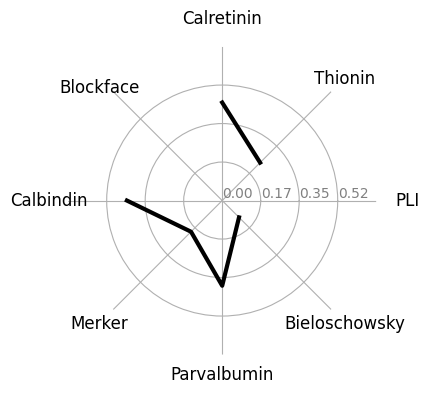

In [1407]:
ilae_tle_hist_r_df = pd.DataFrame(ilae_tle_histo_r,index=histo_names,columns=["Pearson's r"])
radar_plot(ilae_tle_hist_r_df.to_numpy(),label=ilae_tle_hist_r_df.index,axis_range=(0,.7))


,PLI,Thionin,Calretinin,Blockface,Calbindin,Merker,Parvalbumin,Bieloschowsky
0,0.175823,0.243789,0.445601,0.049772,0.433164,0.200371,0.387183,0.108112


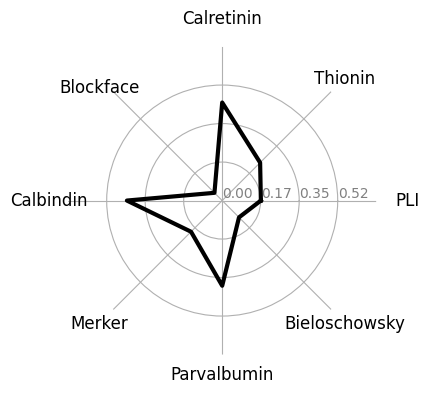

In [1239]:
ilae_tle_hist_r_df = pd.DataFrame(ilae_tle_histo_r,index=histo_names,columns=["Pearson's r"])
radar_plot(np.abs(ilae_tle_hist_r_df.to_numpy()),label=ilae_tle_hist_r_df.index,axis_range=(0,.7))


In [1196]:
spintest_ilae_tle_histo[0][-1]

-0.1758234304567686

In [1150]:
spintest_ilae_tle_histo[2][-2]

0.026

In [1017]:
histo_names[3]

'Blockface'

In [1018]:
spintest_ilae_tle_histo[4][-1]

0.43316441288754187

In [982]:
idx = 2
test_out = hm.stats.spin_test(slm_ilae_tle_mx_list[1].t.flatten(),
                              histo_list[idx].flatten(),
                              nperm=1000)

In [991]:
test_out[1].shape

(126, 254, 1000)

/home/ROBARTS/myousif/virtualenvs/pcntoolkit_dev_cbs_venv/lib/python3.8/site-packages/brainspace-0.1.10-py3.8.egg/brainspace/plotting/base.py:287: UserWarning: Interactive mode requires 'panel'. Setting 'interactive=False'
  warnings.warn("Interactive mode requires 'panel'. "


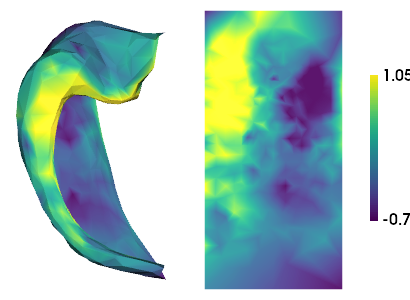

In [1419]:
plotting.surfplot_canonical_foldunfold(reshape_1D_hemi(histo_list[2].flatten()),
                                  labels=['hipp'],
                                  hemis=['L'],
                                  den='2mm',
                                  tighten_cwindow=True, 
                                  embed_nb=True, 
                                  color_bar='right',
                                  share='row',
                                  # cmap='coolwarm',
                                  # color_range=(-0.4,2.8)
                              )

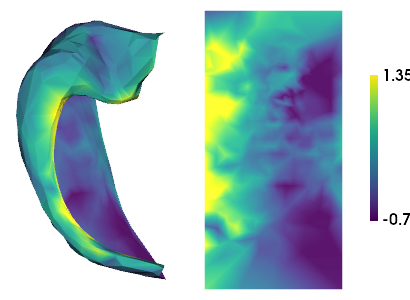

In [1420]:
plotting.surfplot_canonical_foldunfold(reshape_1D_hemi(histo_list[4].flatten()),
                                  labels=['hipp'],
                                  hemis=['L'],
                                  den='2mm',
                                  tighten_cwindow=True, 
                                  embed_nb=True, 
                                  color_bar='right',
                                  share='row',
                                  # cmap='coolwarm',
                                  # color_range=(-0.4,2.8)
                              )

In [ ]:
plotting.surfplot_canonical_foldunfold(reshape_1D_hemi(histo_list[6].flatten()),
                                  labels=['hipp'],
                                  hemis=['L'],
                                  den='2mm',
                                  tighten_cwindow=True, 
                                  embed_nb=True, 
                                  color_bar='right',
                                  share='row',
                                  # cmap='coolwarm',
                                  # color_range=(-0.4,2.8)
                              )

Text(-0.75, 100, 'r=0.4456 \np=0.026')

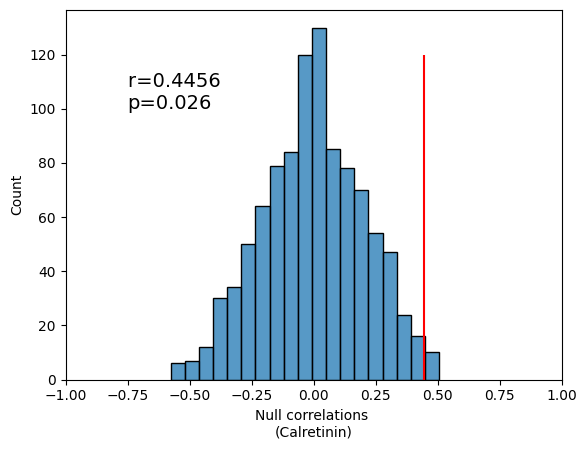

In [1418]:
idx = 2
sns.histplot(x=spintest_ilae_tle_histo[idx][0])
plt.xlim(-1,1)
plt.xlabel(f'Null correlations \n({histo_names[idx]})')
plt.vlines(x=spintest_ilae_tle_histo[idx][-1],ymin=0,ymax=120,colors='red')
plt.text(-.75, 100, f"r={np.round(spintest_ilae_tle_histo[idx][-1],4)} \np={np.round(spintest_ilae_tle_histo[idx][-2],4)}", fontdict={"size": 14})

Text(-0.75, 100, 'r=0.4332 \np=0.013')

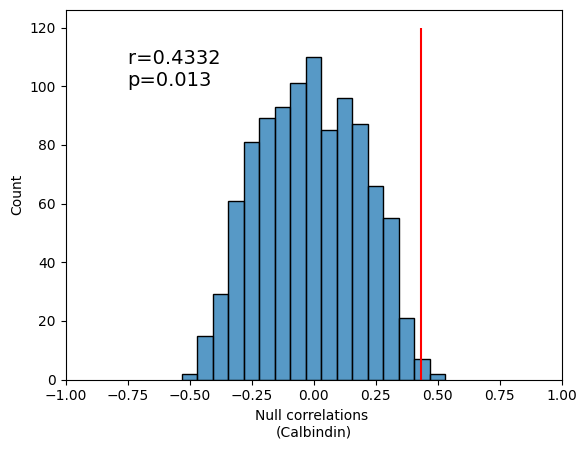

In [1184]:
idx = 4
sns.histplot(x=spintest_ilae_tle_histo[idx][0])
plt.xlim(-1,1)
plt.xlabel(f'Null correlations \n({histo_names[idx]})')
plt.vlines(x=spintest_ilae_tle_histo[idx][-1],ymin=0,ymax=120,colors='red')
plt.text(-.75, 100, f"r={np.round(spintest_ilae_tle_histo[idx][-1],4)} \np={np.round(spintest_ilae_tle_histo[idx][-2],4)}", fontdict={"size": 14})

Text(-0.75, 100, 'r=0.3872 \np=0.027')

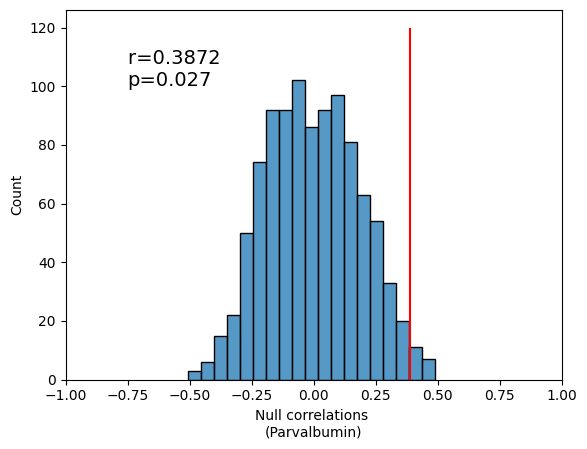

In [1187]:
idx = 6
sns.histplot(x=spintest_ilae_tle_histo[idx][0])
plt.xlim(-1,1)
plt.xlabel(f'Null correlations \n({histo_names[idx]})')
plt.vlines(x=spintest_ilae_tle_histo[idx][-1],ymin=0,ymax=120,colors='red')
plt.text(-.75, 100, f"r={np.round(spintest_ilae_tle_histo[idx][-1],4)} \np={np.round(spintest_ilae_tle_histo[idx][-2],4)}", fontdict={"size": 14})

Text(-0.75, 100, 'r=0.1081 \np=0.649')

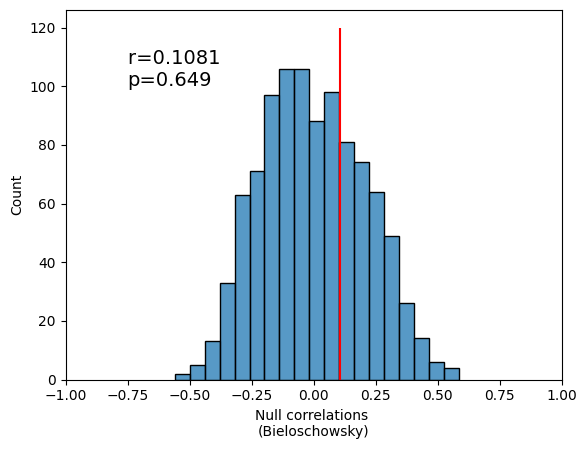

In [1188]:
idx = 7
sns.histplot(x=spintest_ilae_tle_histo[idx][0])
plt.xlim(-1,1)
plt.xlabel(f'Null correlations \n({histo_names[idx]})')
plt.vlines(x=spintest_ilae_tle_histo[idx][-1],ymin=0,ymax=120,colors='red')
plt.text(-.75, 100, f"r={np.round(spintest_ilae_tle_histo[idx][-1],4)} \np={np.round(spintest_ilae_tle_histo[idx][-2],4)}", fontdict={"size": 14})

<AxesSubplot: ylabel='Count'>

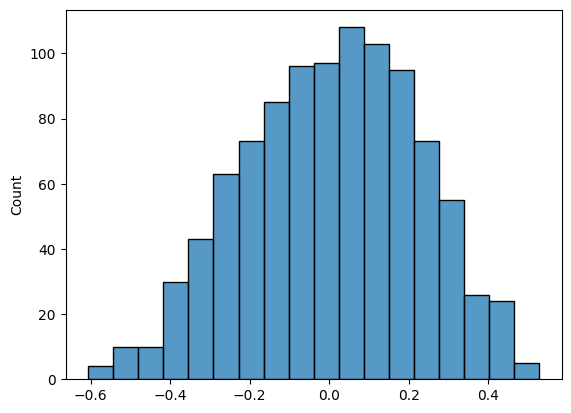

In [989]:
sns.histplot(x=test_out[0])

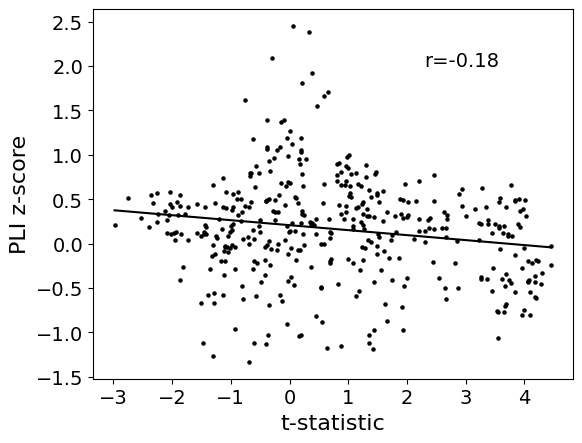

In [941]:
idx=0
plot_tstat_corr(slm_ilae_tle_mx_list[1].t, histo_list[idx],ylabel=histo_names[idx]+ ' z-score')

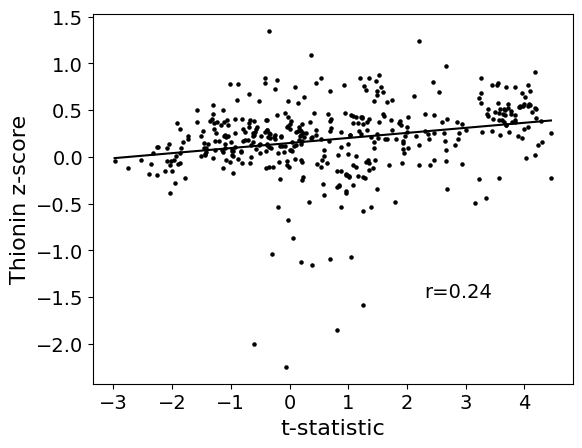

In [940]:
idx=1
plot_tstat_corr(slm_ilae_tle_mx_list[1].t, histo_list[idx],ylabel=histo_names[idx]+ ' z-score',ytextcoord=-1.5)

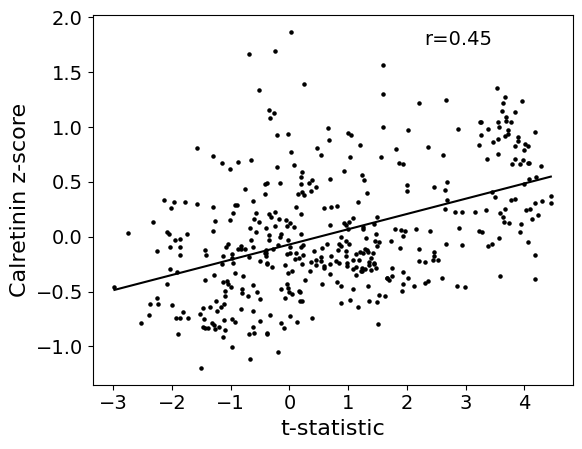

In [943]:
idx=2
plot_tstat_corr(slm_ilae_tle_mx_list[1].t, histo_list[idx],ylabel=histo_names[idx]+ ' z-score',ytextcoord=1.75)

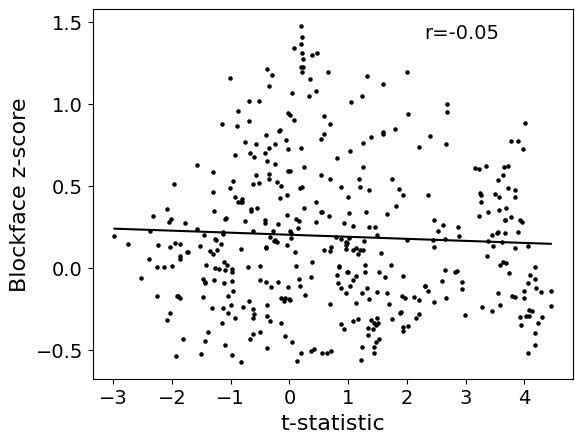

In [945]:
idx=3
plot_tstat_corr(slm_ilae_tle_mx_list[1].t, histo_list[idx],ylabel=histo_names[idx]+ ' z-score',ytextcoord=1.4)

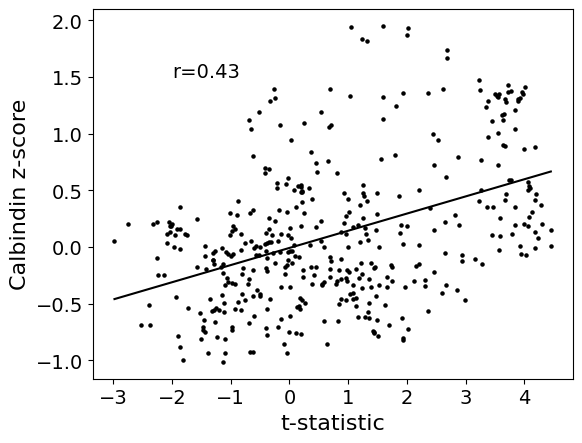

In [947]:
idx=4
plot_tstat_corr(slm_ilae_tle_mx_list[1].t, histo_list[idx],ylabel=histo_names[idx]+ ' z-score',xtextcoord=-2,ytextcoord=1.5)

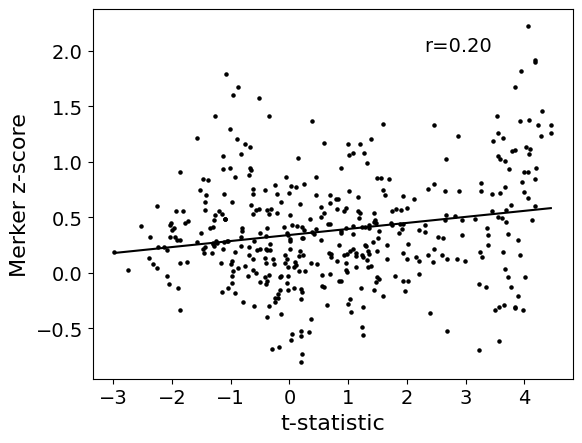

In [948]:
idx=5
plot_tstat_corr(slm_ilae_tle_mx_list[1].t, histo_list[idx],ylabel=histo_names[idx]+ ' z-score')

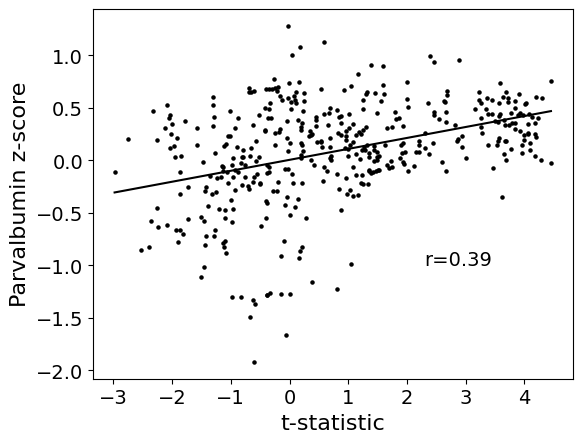

In [950]:
idx=6
plot_tstat_corr(slm_ilae_tle_mx_list[1].t, histo_list[idx],ylabel=histo_names[idx]+ ' z-score',ytextcoord=-1)

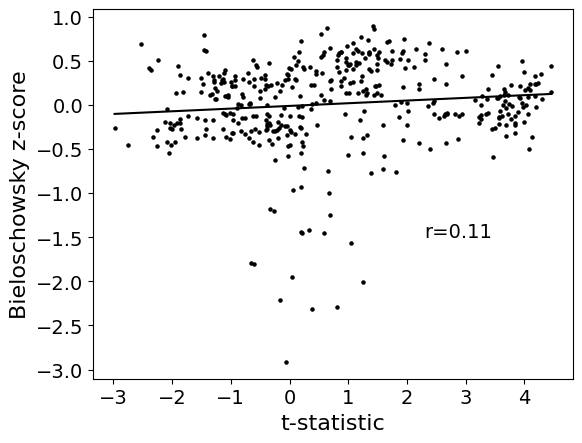

In [952]:
idx=7
plot_tstat_corr(slm_ilae_tle_mx_list[1].t, histo_list[idx],ylabel=histo_names[idx]+ ' z-score',ytextcoord=-1.5)

In [954]:
slm_ilae_tle_mx_list[1].P['clus']

[   clusid  nverts    resels         P
 0       1    66.0  1.324252  0.008780
 1       2     6.0  0.290633  0.128937
 2       3     2.0  0.027983  0.339943
 3       4     2.0  0.015272  0.357728,
   clusid nverts                resels                   P
 0      1    1.0  0.054234463520180166  0.3063255521977869]

In [1406]:
slm_ilae_tle_mx_list[1].P['clus'][0]

,clusid,nverts,resels,P
0,1,66.0,1.324252,0.008780
1,2,6.0,0.290633,0.128937
2,3,2.0,0.027983,0.339943
3,4,2.0,0.015272,0.357728


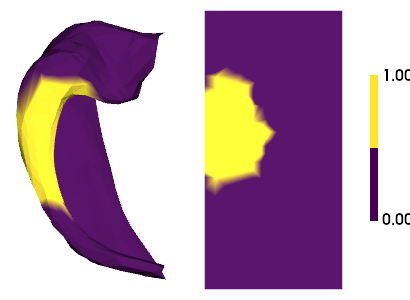

In [726]:
plotting.surfplot_canonical_foldunfold(reshape_1D_hemi(slm_ilae_tle_mx_list[1].P['clusid'][0].flatten() == 1),
                                  labels=['hipp'],
                                  hemis=['L'],
                                  den='2mm',
                                  tighten_cwindow=True, 
                                  embed_nb=True, 
                                  color_bar='right',
                                  share='row',
                              )

In [781]:
tle_ilae_bools[1]

,participant_id,age,sex,TLE,dataset,ilae_1,ilae_2,ilae_3,ilae_4,ilae_5,ilae_6,sex_code,TLE_cat
0,sub-P008,26.0,f,1.0,snsx,Yes,No,No,No,No,No,0,Yes
2,sub-P013,37.0,f,1.0,snsx,Yes,No,No,No,No,No,0,Yes
3,sub-P014,33.0,m,1.0,snsx,No,No,No,No,No,No,1,Yes
9,sub-P026,36.0,f,1.0,snsx,Yes,No,No,No,No,No,0,Yes
11,sub-P029,40.0,m,1.0,snsx,No,No,No,No,No,No,1,Yes
12,sub-P031,44.0,f,1.0,snsx,Yes,No,No,No,No,No,0,Yes
13,sub-P032,24.0,m,1.0,snsx,No,No,Yes,No,No,No,1,Yes
14,sub-P046,21.0,f,1.0,snsx,Yes,No,No,No,No,No,0,Yes
18,sub-P060,45.0,m,1.0,snsx,No,No,No,Yes,No,No,1,Yes
19,sub-P061,59.0,f,1.0,snsx,Yes,No,No,No,No,No,0,Yes


In [784]:
pd.merge(tle_ilae_bools[1], snsx_epi_dfs[0][['participant_id','mri_mts','mri_mts_lateralization']],on='participant_id',how='left')

,participant_id,age,sex,TLE,dataset,ilae_1,ilae_2,ilae_3,ilae_4,ilae_5,ilae_6,sex_code,TLE_cat,mri_mts,mri_mts_lateralization
0,sub-P008,26.0,f,1.0,snsx,Yes,No,No,No,No,No,0,Yes,0.0,0.0
1,sub-P013,37.0,f,1.0,snsx,Yes,No,No,No,No,No,0,Yes,0.0,0.0
2,sub-P014,33.0,m,1.0,snsx,No,No,No,No,No,No,1,Yes,0.0,0.0
3,sub-P026,36.0,f,1.0,snsx,Yes,No,No,No,No,No,0,Yes,0.0,0.0
4,sub-P029,40.0,m,1.0,snsx,No,No,No,No,No,No,1,Yes,1.0,1.0
5,sub-P031,44.0,f,1.0,snsx,Yes,No,No,No,No,No,0,Yes,0.0,0.0
6,sub-P032,24.0,m,1.0,snsx,No,No,Yes,No,No,No,1,Yes,1.0,1.0
7,sub-P046,21.0,f,1.0,snsx,Yes,No,No,No,No,No,0,Yes,1.0,2.0
8,sub-P060,45.0,m,1.0,snsx,No,No,No,Yes,No,No,1,Yes,1.0,1.0
9,sub-P061,59.0,f,1.0,snsx,Yes,No,No,No,No,No,0,Yes,1.0,3.0


In [762]:
~np.ones(419).shape

TypeError: bad operand type for unary ~: 'tuple'

/home/ROBARTS/myousif/virtualenvs/pcntoolkit_dev_cbs_venv/lib/python3.8/site-packages/brainspace-0.1.10-py3.8.egg/brainspace/vtk_interface/wrappers/data_object.py:166: UserWarning: Input array is boolean. Casting to uint8.
  warnings.warn('Input array is boolean. Casting to uint8.')
/home/ROBARTS/myousif/virtualenvs/pcntoolkit_dev_cbs_venv/lib/python3.8/site-packages/brainspace-0.1.10-py3.8.egg/brainspace/plotting/base.py:287: UserWarning: Interactive mode requires 'panel'. Setting 'interactive=False'
  warnings.warn("Interactive mode requires 'panel'. "


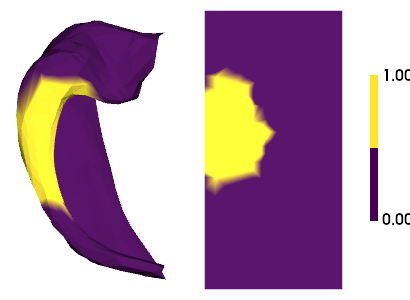

In [772]:
plotting.surfplot_canonical_foldunfold(reshape_1D_hemi(slm_ilae_tle_mx_list[1].P['clusid'][0].flatten() == 1),
                                  labels=['hipp'],
                                  hemis=['L'],
                                  den='2mm',
                                  tighten_cwindow=True, 
                                  embed_nb=True, 
                                  color_bar='right',
                                  share='row',
                              )

In [773]:
tle_ilae_bools[1].ilae_1.value_counts()

Yes    8
No     5
Name: ilae_1, dtype: int64

In [774]:
tle_ilae_bools[1].sex.value_counts()

f    7
m    6
Name: sex, dtype: int64

In [ ]:
tle_ilae_bools[1].value_counts()

In [754]:
slm_ilae_tle_mx_list[4].P['peak']

[Empty DataFrame
 Columns: [t, clusid, vertid, P]
 Index: [],
 Empty DataFrame
 Columns: [t, clusid, vertid, P]
 Index: []]

In [624]:
tle_ilae_mixed_models[0].shape

(28, 8, 784, 2)

In [622]:
reshape_zscores_mx(tle_ilae_zscores[0]).shape
    

(28, 419)

In [618]:
tle_ilae_zscores[0].shape

(2, 419, 14)

In [615]:
tle_ilae_zscores_mixed[idx].T.shape

(14, 419)

In [606]:
tle_ilae_zscores_mixed[idx].shape

(419, 14)

In [605]:
tle_ilae_mixed_models[0].shape

(28, 8, 784, 2)

In [1350]:
slm_mts_mx_noagesex_list[2].P['clus']

[   clusid  nverts    resels         P
 0       1    31.0  0.480945  0.033315
 1       2     5.0  0.050866  0.116462
 2       3     1.0  0.002185  0.134612,
 Empty DataFrame
 Columns: [clusid, nverts, resels, P]
 Index: []]

In [330]:
slm_tle_mx_noagesex_list[0].P['clus']

[Empty DataFrame
 Columns: [clusid, nverts, resels, P]
 Index: [],
    clusid  nverts    resels         P
 0       1    12.0  0.666143  0.087886
 1       2     2.0  0.037659  0.422363]

<AxesSubplot: ylabel='Density'>

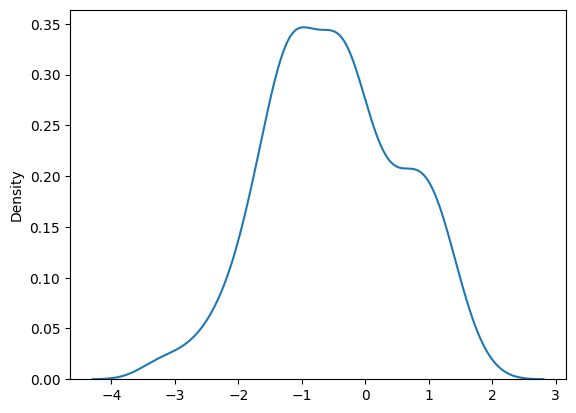

In [333]:
sns.kdeplot(x=slm_tle_mx_noagesex_list[0].t.flatten())

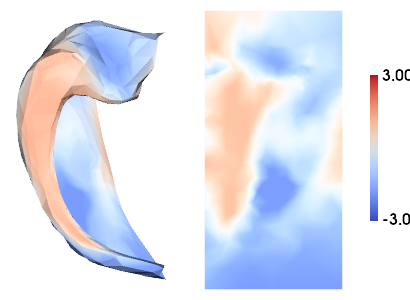

In [456]:
plotting.surfplot_canonical_foldunfold(reshape_1D_hemi(slm_tle_mx_noagesex_list[0].t),
                                  labels=['hipp'],
                                  hemis=['L'],
                                  den='2mm',
                                  tighten_cwindow=True, 
                                  embed_nb=True, 
                                  color_bar='right',
                                  share='row',
                                  cmap='coolwarm',
                                  color_range=(-3,3)
                              )

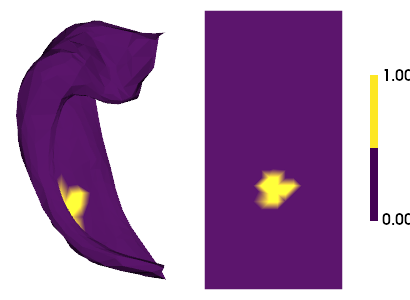

In [343]:
plotting.surfplot_canonical_foldunfold(reshape_1D_hemi(slm_tle_mx_noagesex_list[0].P['clusid'][1]) == 1,
                                  labels=['hipp'],
                                  hemis=['L'],
                                  den='2mm',
                                  embed_nb=True, 
                                  color_bar='right',
                                  share='row',
                              )

<AxesSubplot: ylabel='Density'>

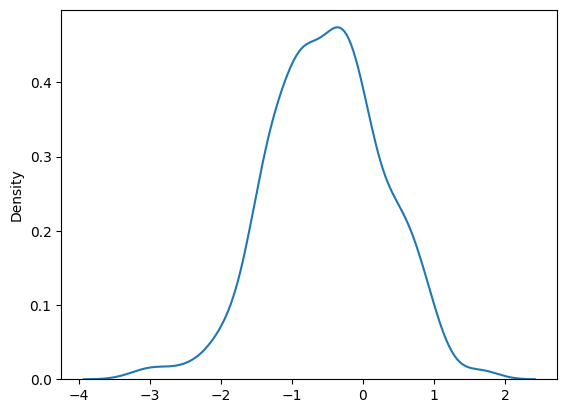

In [367]:
sns.kdeplot(x=slm_tle_mx_noagesex_list[1].t.flatten())

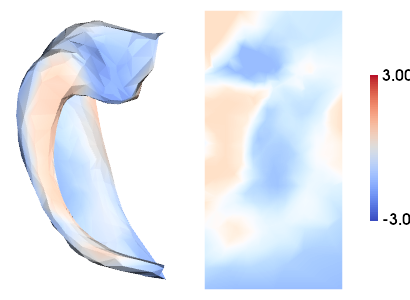

In [455]:
plotting.surfplot_canonical_foldunfold(reshape_1D_hemi(slm_tle_mx_noagesex_list[1].t),
                                  labels=['hipp'],
                                  hemis=['L'],
                                  den='2mm',
                                  tighten_cwindow=True, 
                                  embed_nb=True, 
                                  color_bar='right',
                                  share='row',
                                  cmap='coolwarm',
                                  color_range=(-3,3)
                              )

/home/ROBARTS/myousif/virtualenvs/pcntoolkit_dev_cbs_venv/lib/python3.8/site-packages/brainspace-0.1.10-py3.8.egg/brainspace/vtk_interface/wrappers/data_object.py:166: UserWarning: Input array is boolean. Casting to uint8.
  warnings.warn('Input array is boolean. Casting to uint8.')


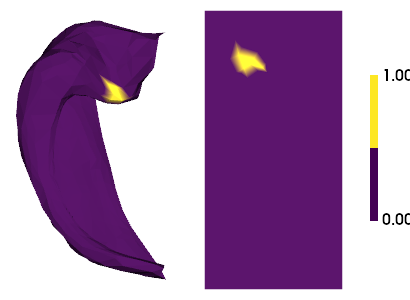

In [369]:
plotting.surfplot_canonical_foldunfold(reshape_1D_hemi(slm_tle_mx_noagesex_list[1].P['clusid'][1]) == 1,
                                  labels=['hipp'],
                                  hemis=['L'],
                                  den='2mm',
                                  embed_nb=True, 
                                  color_bar='right',
                                  share='row',
                              )

<AxesSubplot: ylabel='Density'>

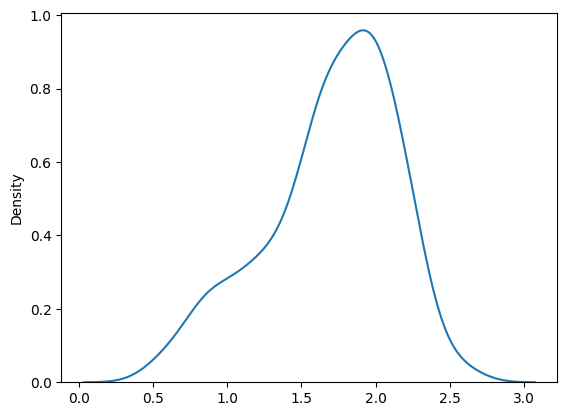

In [346]:
sns.kdeplot(x=slm_tle_mx_noagesex_list[2].t.flatten())

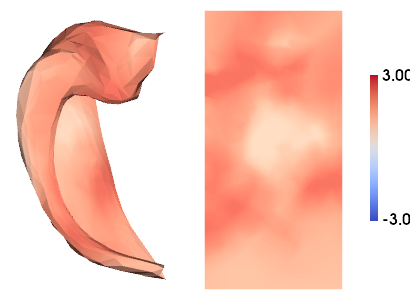

In [347]:
plotting.surfplot_canonical_foldunfold(reshape_1D_hemi(slm_tle_mx_noagesex_list[2].t),
                                  labels=['hipp'],
                                  hemis=['L'],
                                  den='2mm',
                                  tighten_cwindow=True, 
                                  embed_nb=True, 
                                  color_bar='right',
                                  share='row',
                                  cmap='coolwarm',
                                  color_range=(-3,3)
                              )

/home/ROBARTS/myousif/virtualenvs/pcntoolkit_dev_cbs_venv/lib/python3.8/site-packages/brainspace-0.1.10-py3.8.egg/brainspace/vtk_interface/wrappers/data_object.py:166: UserWarning: Input array is boolean. Casting to uint8.
  warnings.warn('Input array is boolean. Casting to uint8.')


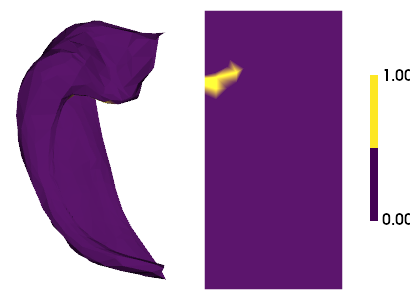

In [453]:
plotting.surfplot_canonical_foldunfold(reshape_1D_hemi(slm_tle_mx_noagesex_list[2].P['clusid'][0]) ==1,
                                  labels=['hipp'],
                                  hemis=['L'],
                                  den='2mm',
                                  embed_nb=True, 
                                  color_bar='right',
                                  share='row',
                              )

In [434]:
slm_tle_mx_list[2].P['clus']

[Empty DataFrame
 Columns: [clusid, nverts, resels, P]
 Index: [],
 Empty DataFrame
 Columns: [clusid, nverts, resels, P]
 Index: []]

In [437]:
slm_mts_mx_list[2].P['clus']

[  clusid nverts              resels                    P
 0      1   17.0  0.3023999893797859  0.05984888814159923,
 Empty DataFrame
 Columns: [clusid, nverts, resels, P]
 Index: []]

<AxesSubplot: ylabel='Density'>

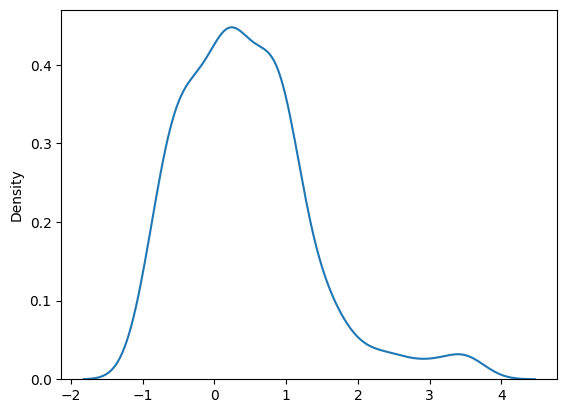

In [438]:
sns.kdeplot(x=slm_mts_mx_list[2].t.flatten())

In [1363]:
slm_mts_mx_list[2].P['clus']

/home/ROBARTS/myousif/virtualenvs/pcntoolkit_dev_cbs_venv/lib/python3.8/site-packages/IPython/core/displayhook.py:275: UserWarning: Output cache limit (currently 1000 entries) hit.
Flushing oldest 200 entries.
  warn('Output cache limit (currently {sz} entries) hit.\n'


[  clusid nverts              resels                    P
 0      1   17.0  0.3023999893797859  0.05984888814159923,
 Empty DataFrame
 Columns: [clusid, nverts, resels, P]
 Index: []]

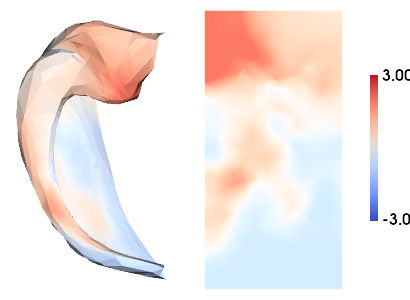

In [451]:
plotting.surfplot_canonical_foldunfold(reshape_1D_hemi(slm_mts_mx_list[2].t),
                                  labels=['hipp'],
                                  hemis=['L'],
                                  den='2mm',
                                  tighten_cwindow=True, 
                                  embed_nb=True, 
                                  color_bar='right',
                                  share='row',
                                  cmap='coolwarm',
                                  color_range=(-3,3)
                              )

/home/ROBARTS/myousif/virtualenvs/pcntoolkit_dev_cbs_venv/lib/python3.8/site-packages/brainspace-0.1.10-py3.8.egg/brainspace/vtk_interface/wrappers/data_object.py:166: UserWarning: Input array is boolean. Casting to uint8.
  warnings.warn('Input array is boolean. Casting to uint8.')


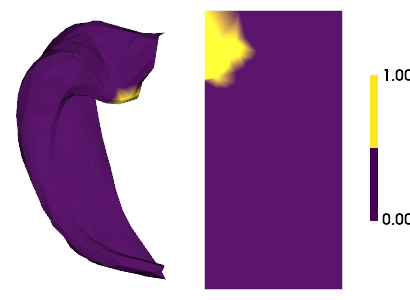

In [445]:
plotting.surfplot_canonical_foldunfold(reshape_1D_hemi(slm_mts_mx_list[2].P['clusid'][0]) == 1,
                                  labels=['hipp'],
                                  hemis=['L'],
                                  den='2mm',
                                  embed_nb=True, 
                                  color_bar='right',
                                  share='row',
                              )

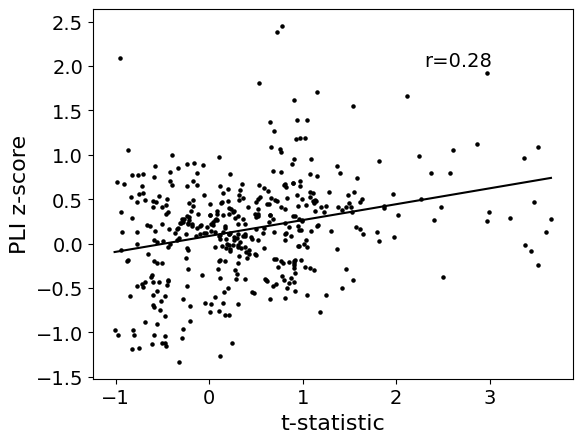

In [957]:
idx=0
plot_tstat_corr(slm_mts_mx_list[2].t, histo_list[idx],ylabel=histo_names[idx]+ ' z-score')

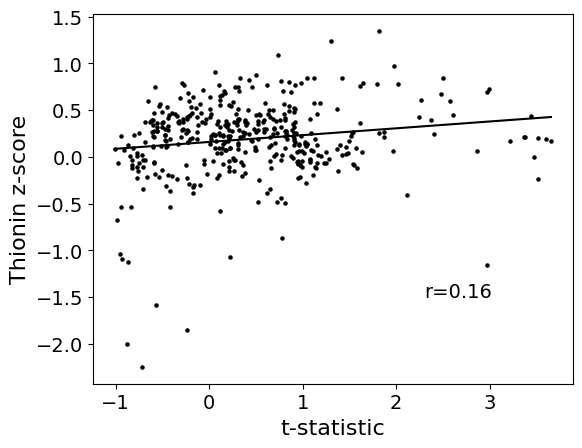

In [1128]:
idx=1
plot_tstat_corr(slm_mts_mx_list[2].t, histo_list[idx],ylabel=histo_names[idx]+ ' z-score',ytextcoord=-1.5)

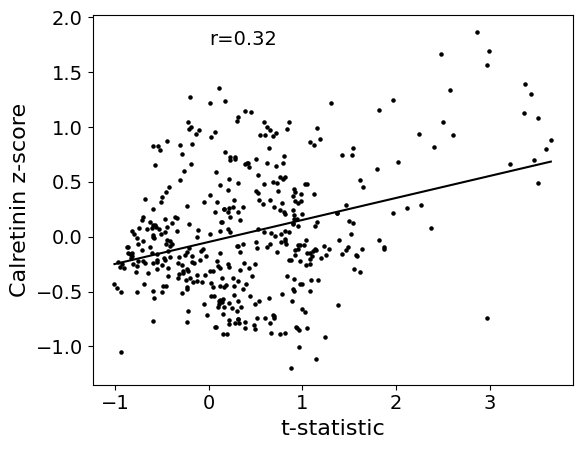

In [1129]:
idx=2
plot_tstat_corr(slm_mts_mx_list[2].t, histo_list[idx],ylabel=histo_names[idx]+ ' z-score',ytextcoord=1.75,xtextcoord=0)

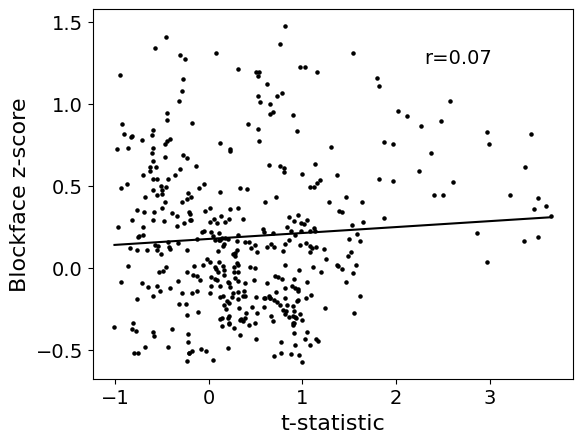

In [1130]:
idx=3
plot_tstat_corr(slm_mts_mx_list[2].t, histo_list[idx],ylabel=histo_names[idx]+ ' z-score',ytextcoord=1.25)

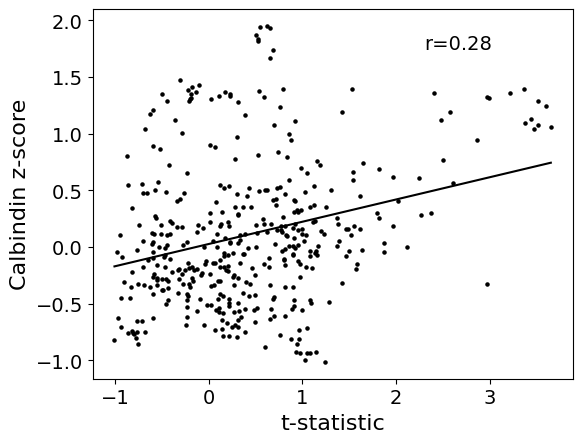

In [1131]:
idx=4
plot_tstat_corr(slm_mts_mx_list[2].t, histo_list[idx],ylabel=histo_names[idx]+ ' z-score',ytextcoord=1.75)

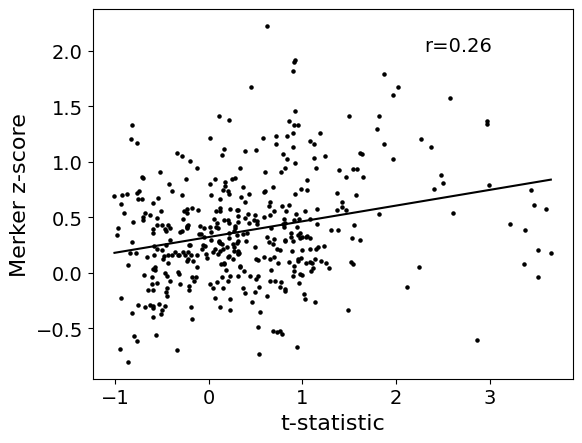

In [1132]:
idx=5
plot_tstat_corr(slm_mts_mx_list[2].t, histo_list[idx],ylabel=histo_names[idx]+ ' z-score')

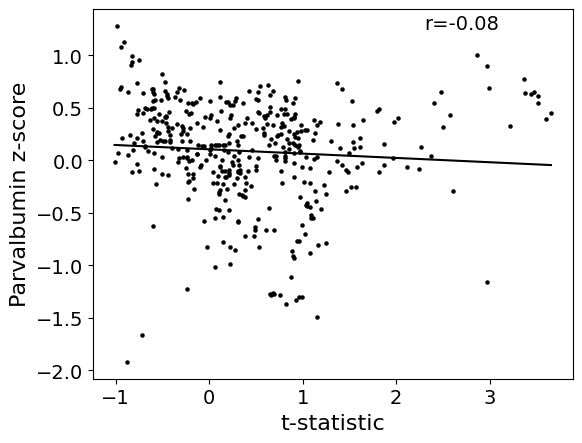

In [1134]:
idx=6
plot_tstat_corr(slm_mts_mx_list[2].t, histo_list[idx],ylabel=histo_names[idx]+ ' z-score',ytextcoord=1.25)

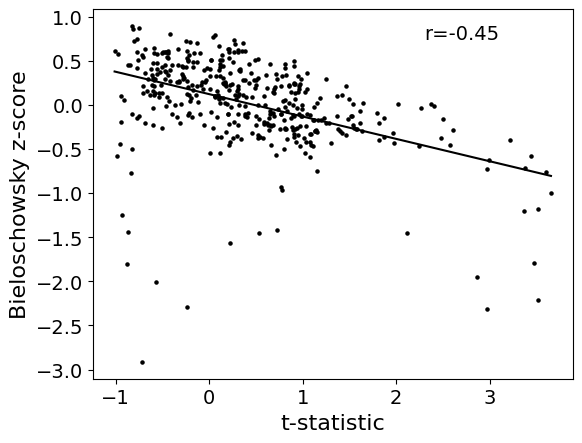

In [1135]:
idx=7
plot_tstat_corr(slm_mts_mx_list[2].t, histo_list[idx],ylabel=histo_names[idx]+ ' z-score', ytextcoord=.75)

<AxesSubplot: ylabel='Density'>

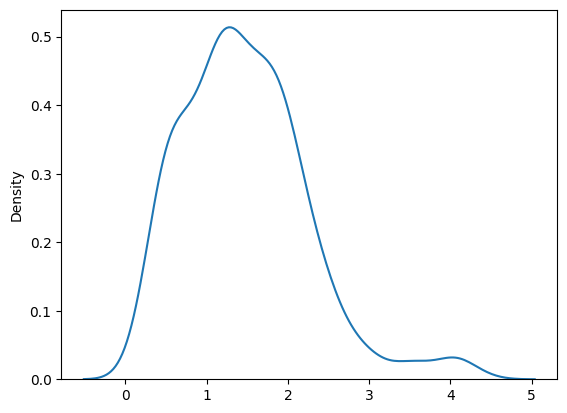

In [276]:
sns.kdeplot(x=slm_mts_mx_noagesex_list[2].t.flatten())

In [1349]:
slm_mts_mx_noagesex_list[2].P['clus'][0]

,clusid,nverts,resels,P
0,1,31.0,0.480945,0.033315
1,2,5.0,0.050866,0.116462
2,3,1.0,0.002185,0.134612


/home/ROBARTS/myousif/virtualenvs/pcntoolkit_dev_cbs_venv/lib/python3.8/site-packages/brainspace-0.1.10-py3.8.egg/brainspace/plotting/base.py:287: UserWarning: Interactive mode requires 'panel'. Setting 'interactive=False'
  warnings.warn("Interactive mode requires 'panel'. "


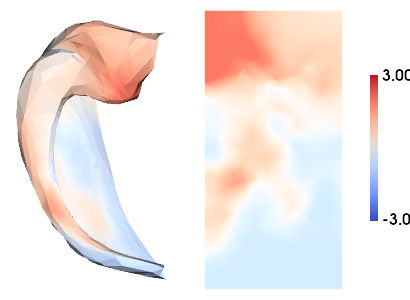

In [1364]:
plotting.surfplot_canonical_foldunfold(reshape_1D_hemi(slm_mts_mx_list[2].t),
                                  labels=['hipp'],
                                  hemis=['L'],
                                  den='2mm',
                                  tighten_cwindow=True, 
                                  embed_nb=True, 
                                  color_bar='right',
                                  share='row',
                                  cmap='coolwarm',
                                  color_range=(-3,3)
                              )

In [1372]:
test = slm_mts_mx_list[2].P['clus'][0].copy()

In [1387]:
test.astype(float).round(5)

,clusid,nverts,resels,P
0,1.0,17.0,0.3024,0.05985


In [1384]:
test2.round(3)

,clusid,nverts,resels,P
0,1,17.0,0.3023999893797859,0.05984888814159923


/home/ROBARTS/myousif/virtualenvs/pcntoolkit_dev_cbs_venv/lib/python3.8/site-packages/brainspace-0.1.10-py3.8.egg/brainspace/vtk_interface/wrappers/data_object.py:166: UserWarning: Input array is boolean. Casting to uint8.
  warnings.warn('Input array is boolean. Casting to uint8.')


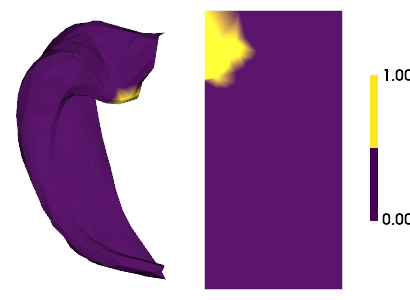

In [1365]:
plotting.surfplot_canonical_foldunfold(reshape_1D_hemi(slm_mts_mx_list[2].P['clusid'][0]) == 1,
                                  labels=['hipp'],
                                  hemis=['L'],
                                  den='2mm', 
                                  embed_nb=True, 
                                  color_bar='right',
                                  share='row')

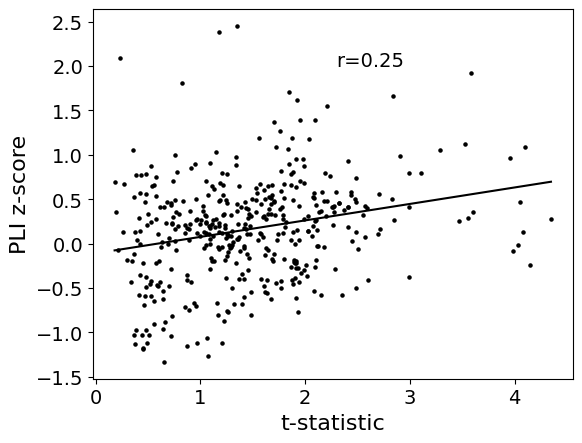

In [966]:
idx=0
plot_tstat_corr(slm_mts_mx_noagesex_list[2].t, histo_list[idx],ylabel=histo_names[idx]+ ' z-score')

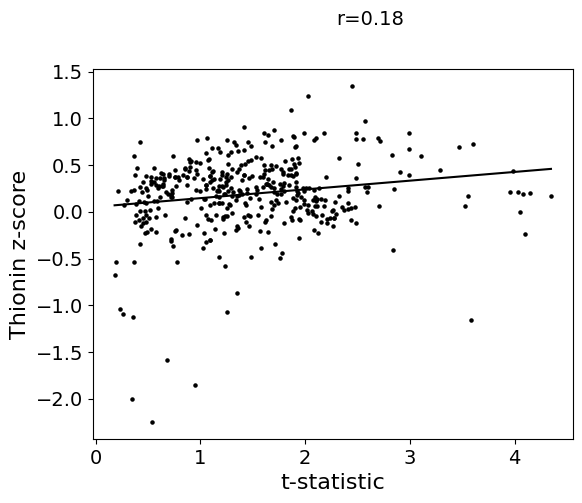

In [967]:
idx=1
plot_tstat_corr(slm_mts_mx_noagesex_list[2].t, histo_list[idx],ylabel=histo_names[idx]+ ' z-score')

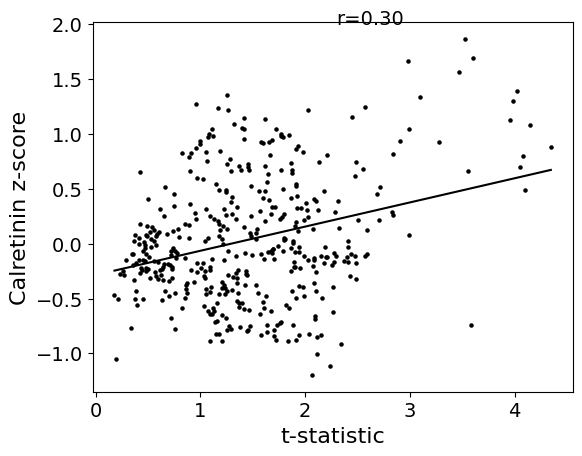

In [968]:
idx=2
plot_tstat_corr(slm_mts_mx_noagesex_list[2].t, histo_list[idx],ylabel=histo_names[idx]+ ' z-score')

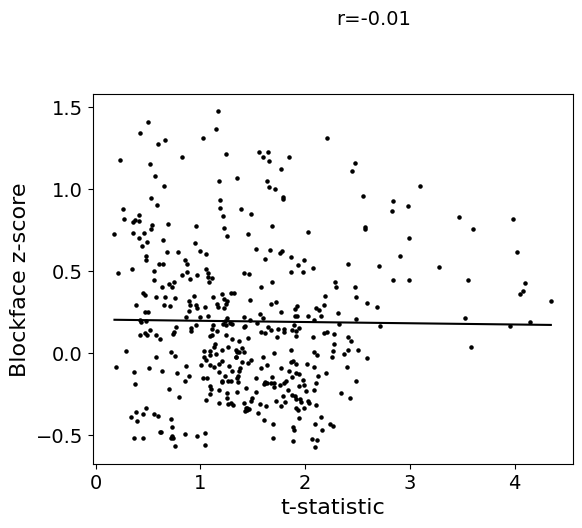

In [1031]:
idx=3
plot_tstat_corr(slm_mts_mx_noagesex_list[2].t, histo_list[idx],ylabel=histo_names[idx]+ ' z-score')

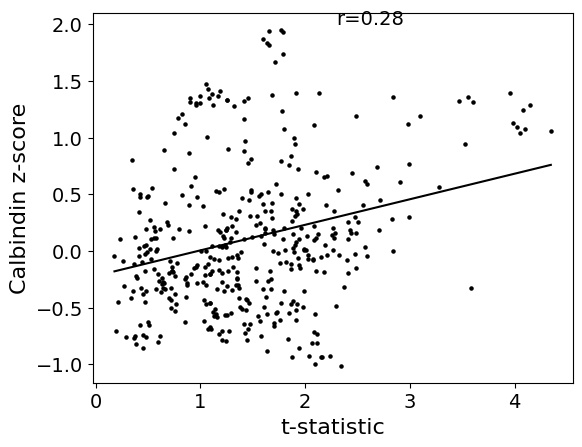

In [969]:
idx=4
plot_tstat_corr(slm_mts_mx_noagesex_list[2].t, histo_list[idx],ylabel=histo_names[idx]+ ' z-score')

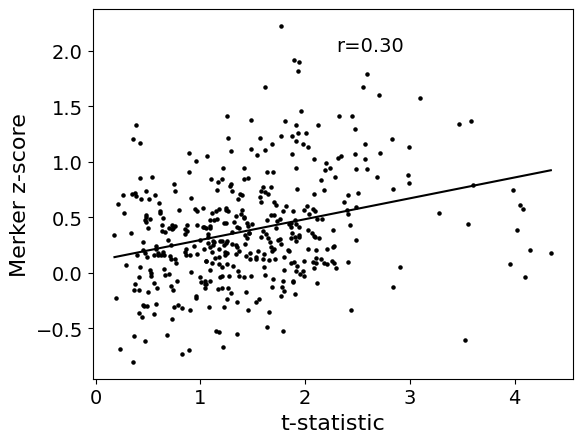

In [970]:
idx=5
plot_tstat_corr(slm_mts_mx_noagesex_list[2].t, histo_list[idx],ylabel=histo_names[idx]+ ' z-score')

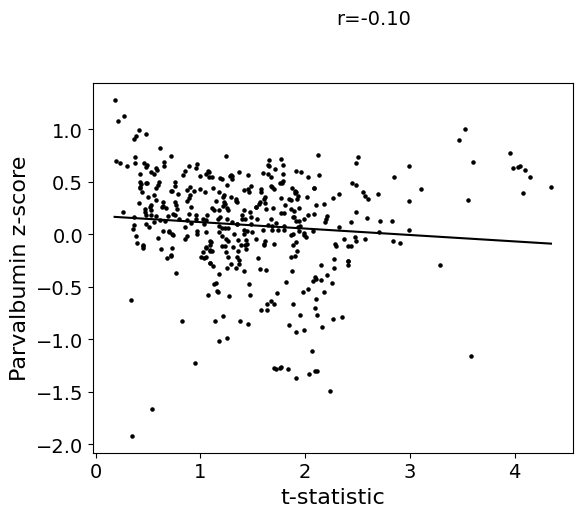

In [971]:
idx=6
plot_tstat_corr(slm_mts_mx_noagesex_list[2].t, histo_list[idx],ylabel=histo_names[idx]+ ' z-score')

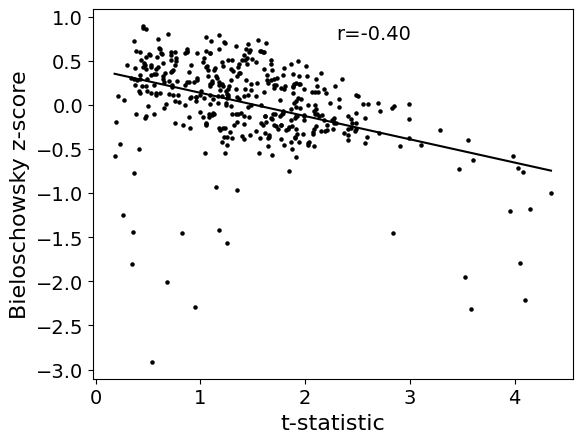

In [1395]:
idx=7
plot_tstat_corr(slm_mts_mx_noagesex_list[2].t, histo_list[idx],ylabel=histo_names[idx]+ ' z-score',ytextcoord=.75)

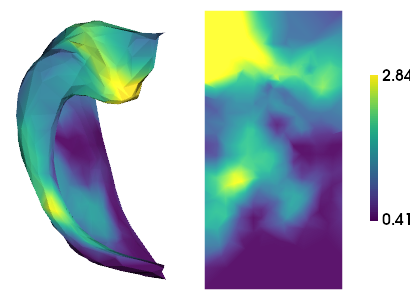

In [1050]:
plotting.surfplot_canonical_foldunfold(reshape_1D_hemi(slm_mts_mx_noagesex_list[2].t),
                                  labels=['hipp'],
                                  hemis=['L'],
                                  den='2mm',
                                  tighten_cwindow=True, 
                                  embed_nb=True, 
                                  color_bar='right',
                                  share='row',
                                  # cmap='coolwarm',
                                  # color_range=(-0.4,3)
                              )

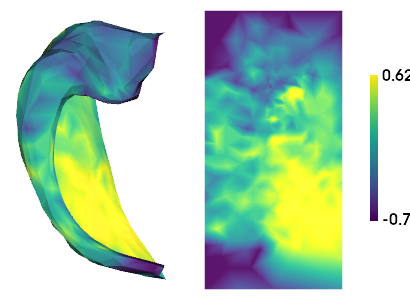

In [1111]:
plotting.surfplot_canonical_foldunfold(reshape_1D_hemi(histo_list[7].flatten()),
                                  labels=['hipp'],
                                  hemis=['L'],
                                  den='2mm',
                                  tighten_cwindow=True, 
                                  embed_nb=True, 
                                  color_bar='right',
                                  share='row',
                                  # cmap='coolwarm',
                                  # color_range=(-0.4,2.8)
                              )

In [1062]:
np.savetxt('t-stat_contrast-mts_noagesex.txt',slm_mts_mx_noagesex_list[2].t.flatten() )
np.savetxt('histo-blockface_den-2mm.txt',histo_list[3].flatten())


In [ ]:
slm_mts_mx_noagesex_list[2].t.flatten(),
                                  histo_list[idx].flatten()

In [994]:
spintest_mts_histo = []
for idx, _ in enumerate(histo_list):
    test_out = hm.stats.spin_test(slm_mts_mx_noagesex_list[2].t.flatten(),
                                  histo_list[idx].flatten(),
                                  nperm=1000)
    
    spintest_mts_histo.append(test_out)


In [1241]:
mts_histo_r = np.array([test[-1] for test in spintest_mts_histo])
mts_histo_pval = [test[-2] for test in spintest_mts_histo]

In [1390]:
histo_names

['PLI',
 'Thionin',
 'Calretinin',
 'Blockface',
 'Calbindin',
 'Merker',
 'Parvalbumin',
 'Bieloschowsky']

In [1389]:
mts_histo_r

array([ 0.2486403 ,  0.17990266,  0.30204544, -0.01291253,  0.27571654,
        0.29618026, -0.09710376, -0.40024373])

In [1388]:
mts_histo_pval

[0.211, 0.344, 0.133, 0.949, 0.145, 0.061, 0.636, 0.05]

,PLI,Thionin,Calretinin,Blockface,Calbindin,Merker,Parvalbumin,Bieloschowsky
0,0.24864,0.179903,0.302045,0.012913,0.275717,0.29618,0.097104,0.400244


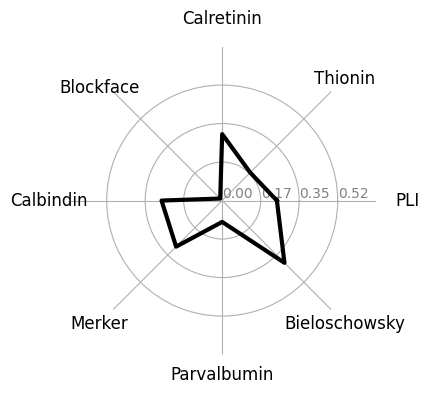

In [1242]:
mts_hist_r_df = pd.DataFrame(mts_histo_r,index=histo_names,columns=["Pearson's r"])
radar_plot(np.abs(mts_hist_r_df.to_numpy()),label=mts_hist_r_df.index,axis_range=(0,.7))


,PLI,Thionin,Calretinin,Blockface,Calbindin,Merker,Parvalbumin,Bieloschowsky
0,0.24864,0.179903,0.302045,-0.012913,0.275717,0.29618,-0.097104,-0.400244


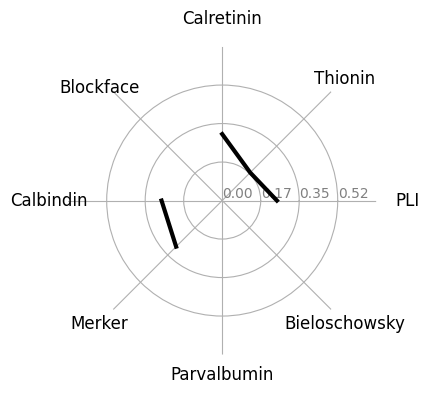

In [1391]:
mts_hist_r_df = pd.DataFrame(mts_histo_r,index=histo_names,columns=["Pearson's r"])
radar_plot(mts_hist_r_df.to_numpy(),label=mts_hist_r_df.index,axis_range=(0,.7))


In [1108]:
spintest_mts_histo[idx][-2]

0.05

In [1392]:
histo_names[idx]

'Bieloschowsky'

Text(0.5, 100, 'r=-0.4002 \np=0.05')

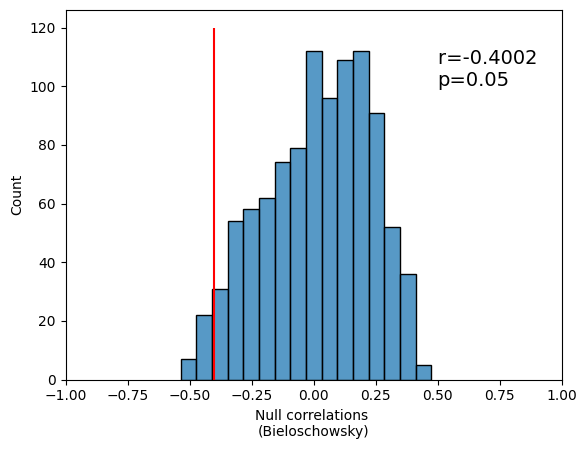

In [1394]:
idx = 7
sns.histplot(x=spintest_mts_histo[idx][0])
plt.xlim(-1,1)
plt.xlabel(f'Null correlations \n({histo_names[idx]})')
plt.vlines(x=spintest_mts_histo[idx][-1],ymin=0,ymax=120,colors='red')
plt.text(.5, 100, f"r={np.round(spintest_mts_histo[idx][-1],4)} \np={np.round(spintest_mts_histo[idx][-2],4)}", fontdict={"size": 14})

In [1037]:
spintest_mts_histo[3][1].shape

(126, 254, 1000)

In [1032]:
spintest_mts_histo[3][-2]

0.949

In [1030]:
spintest_mts_histo[3][-1]

-0.012912526583562612

In [425]:
slm_mts_mx_noagesex_list[2].P['clus']

[   clusid  nverts    resels         P
 0       1    31.0  0.480945  0.033315
 1       2     5.0  0.050866  0.116462
 2       3     1.0  0.002185  0.134612,
 Empty DataFrame
 Columns: [clusid, nverts, resels, P]
 Index: []]

In [280]:
slm_tle_mx_noagesex_list[2].P['clus']

[  clusid nverts              resels                    P
 0      1    6.0  0.1601580051857321  0.08523679144869231,
 Empty DataFrame
 Columns: [clusid, nverts, resels, P]
 Index: []]

In [281]:
slm_mts_mx_list[4].P['clus']

[Empty DataFrame
 Columns: [clusid, nverts, resels, P]
 Index: [],
   clusid nverts                resels                   P
 0      1    4.0  0.043951992984694266  0.1385729615912857]

In [282]:
slm_tle_mx_list[3].P['clus']


[Empty DataFrame
 Columns: [clusid, nverts, resels, P]
 Index: [],
 Empty DataFrame
 Columns: [clusid, nverts, resels, P]
 Index: []]

In [378]:
slm_tle_mx_noagesex_list[4].P['clus']

[Empty DataFrame
 Columns: [clusid, nverts, resels, P]
 Index: [],
 Empty DataFrame
 Columns: [clusid, nverts, resels, P]
 Index: []]

In [385]:
slm_mts_list[0].P['clus']

[Empty DataFrame
 Columns: [clusid, nverts, resels, P]
 Index: [],
   clusid nverts               resels                    P
 0      1    3.0  0.12418076133874656  0.32769221476280824]

In [379]:
slm_mts_list[2].P['clus']

[  clusid nverts               resels                    P
 0      1   18.0  0.34331165655503043  0.04056966429904206,
 Empty DataFrame
 Columns: [clusid, nverts, resels, P]
 Index: []]

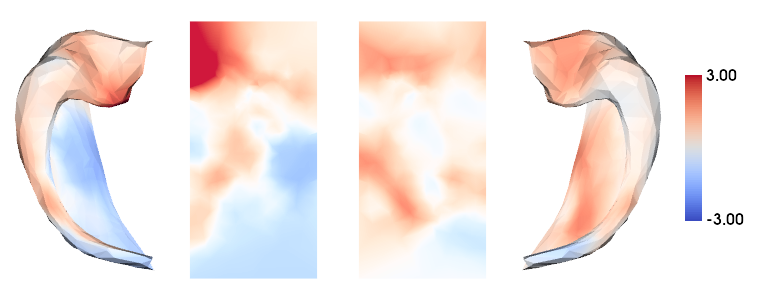

In [457]:
plotting.surfplot_canonical_foldunfold(reshape_1D(slm_mts_list[2].t.flatten()),
                                  labels=['hipp'],
                                  den='2mm',
                                  embed_nb=True, 
                                  color_bar='right',
                                  share='row',
                                  cmap='coolwarm',
                                  color_range=(-3,3))

/home/ROBARTS/myousif/virtualenvs/pcntoolkit_dev_cbs_venv/lib/python3.8/site-packages/brainspace-0.1.10-py3.8.egg/brainspace/vtk_interface/wrappers/data_object.py:166: UserWarning: Input array is boolean. Casting to uint8.
  warnings.warn('Input array is boolean. Casting to uint8.')
/home/ROBARTS/myousif/virtualenvs/pcntoolkit_dev_cbs_venv/lib/python3.8/site-packages/brainspace-0.1.10-py3.8.egg/brainspace/plotting/base.py:287: UserWarning: Interactive mode requires 'panel'. Setting 'interactive=False'
  warnings.warn("Interactive mode requires 'panel'. "


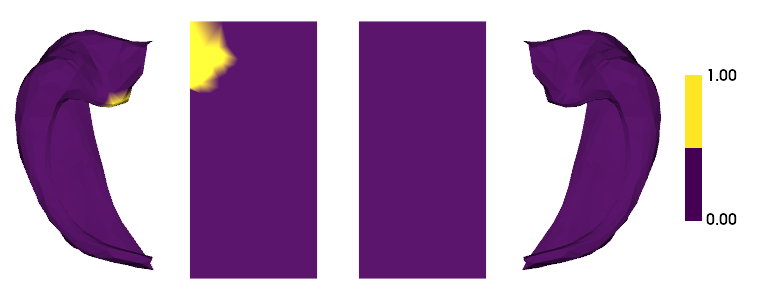

In [413]:
plotting.surfplot_canonical_foldunfold(reshape_1D(slm_mts_list[2].P['clusid'][0].flatten() == 1),
                                  labels=['hipp'],
                                  den='2mm',
                                  embed_nb=True, 
                                  color_bar='right',
                                  share='row')

In [955]:
idx=0
plot_tstat_corr(slm_mts_list[2].t, histo_list[idx],ylabel=histo_names[idx]+ ' z-score')

ValueError: All arrays must be of the same length

In [407]:
slm_noagesex_tle_list[0].P['clus']

[Empty DataFrame
 Columns: [clusid, nverts, resels, P]
 Index: [],
    clusid  nverts    resels         P
 0       1    14.0  0.711252  0.071402
 1       2     1.0  0.089404  0.348134
 2       3     1.0  0.064392  0.369286
 3       4     1.0  0.000000  1.000000
 4       5     1.0  0.000000  1.000000
 5       6     1.0  0.000000  1.000000
 6       7     1.0  0.000000  1.000000]

In [412]:
slm_noagesex_mts_list[2].P['clus']

[   clusid  nverts    resels         P
 0       1    31.0  0.454316  0.024463
 1       2     1.0  0.000000  1.000000
 2       3     1.0  0.000000  1.000000
 3       4     1.0  0.000000  1.000000
 4       5     1.0  0.000000  1.000000
 5       6     1.0  0.000000  1.000000
 6       7     1.0  0.000000  1.000000
 7       8     1.0  0.000000  1.000000
 8       9     1.0  0.000000  1.000000
 9      10     1.0  0.000000  1.000000,
 Empty DataFrame
 Columns: [clusid, nverts, resels, P]
 Index: []]

In [389]:
slm_noagesex_mts_list[0].P['clus']

[Empty DataFrame
 Columns: [clusid, nverts, resels, P]
 Index: [],
   clusid nverts             resels                    P
 0      1   10.0  0.587326499076986  0.10105458641187313]

In [223]:
slm_mts_list[2].P['clus']

[  clusid nverts               resels                    P
 0      1   18.0  0.34331165655503043  0.04056966429904206,
 Empty DataFrame
 Columns: [clusid, nverts, resels, P]
 Index: []]

In [797]:
slm_noagesex_tle_list[4].P['clus']

[Empty DataFrame
 Columns: [clusid, nverts, resels, P]
 Index: [],
 Empty DataFrame
 Columns: [clusid, nverts, resels, P]
 Index: []]

In [777]:
slm_mts_list[2].P['clus']

[  clusid nverts               resels                    P
 0      1   18.0  0.34331165655503043  0.04056966429904206,
 Empty DataFrame
 Columns: [clusid, nverts, resels, P]
 Index: []]

In [801]:
slm_noagesex_mts_list[2].P['clus']

[   clusid  nverts    resels         P
 0       1    31.0  0.454316  0.024463
 1       2     1.0  0.000000  1.000000
 2       3     1.0  0.000000  1.000000
 3       4     1.0  0.000000  1.000000
 4       5     1.0  0.000000  1.000000
 5       6     1.0  0.000000  1.000000
 6       7     1.0  0.000000  1.000000
 7       8     1.0  0.000000  1.000000
 8       9     1.0  0.000000  1.000000
 9      10     1.0  0.000000  1.000000,
 Empty DataFrame
 Columns: [clusid, nverts, resels, P]
 Index: []]

In [754]:
pd.Series(slm_mts_list[2].P['clusid'][0].flatten()).value_counts()



0.0    822
1.0     16
dtype: int64

In [816]:
(slm_noagesex_mts_list[2].P['clusid'][0] == 1).astype(int).flatten().shape

(838,)

In [458]:
tle_tstat_maps = np.stack([slm.t.flatten() for slm in slm_tle_list])
mts_tstat_maps = np.stack([slm.t.flatten() for slm in slm_mts_list])

In [461]:
reshape4surfplot(tle_tstat_maps).shape


(419, 2, 5)

In [ ]:
plotting.surfplot_canonical_foldunfold(reshape4surfplot(tle_tstat_maps),
                                  labels=['hipp'],
                                  den='2mm',
                                  tighten_cwindow=True, 
                                  embed_nb=True, 
                                  color_bar='right',
                                  share='row',
                                  cmap='PRGn',
                                  color_range=(-4,4),
                                  label_text=metric_names)

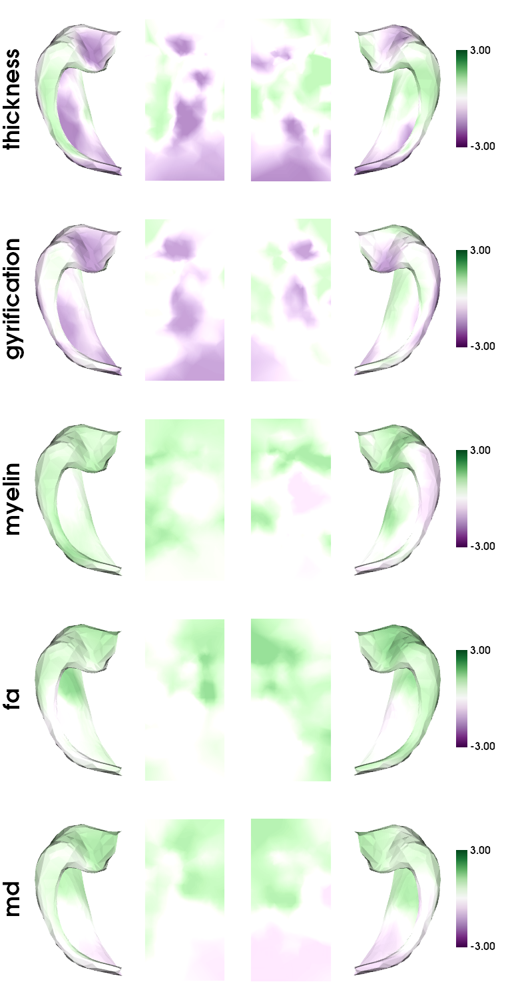

In [462]:
plotting.surfplot_canonical_foldunfold(reshape4surfplot(tle_tstat_maps),
                                  labels=['hipp'],
                                  den='2mm',
                                  tighten_cwindow=True, 
                                  embed_nb=True, 
                                  color_bar='right',
                                  share='row',
                                  cmap='PRGn',
                                  color_range=(-3,3),
                                  label_text=metric_names)


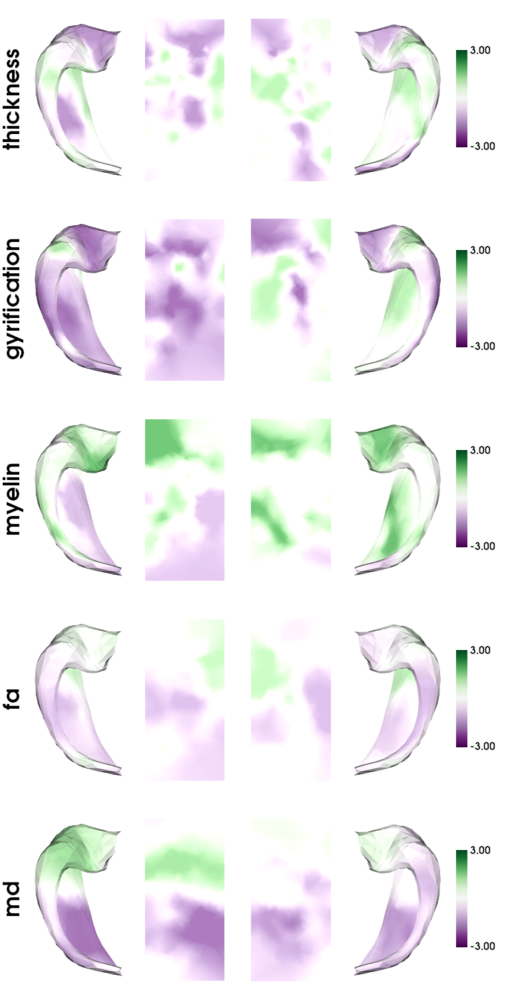

In [464]:
plotting.surfplot_canonical_foldunfold(reshape4surfplot(mts_tstat_maps),
                                  labels=['hipp'],
                                  den='2mm',
                                  tighten_cwindow=True, 
                                  embed_nb=True, 
                                  color_bar='right',
                                  share='row',
                                  cmap='PRGn',
                                  color_range=(-3,3),
                                  label_text=metric_names)

In [649]:
slm_tle_list[0].

In [668]:
slm_tle_list[0].P['clus'][1].head()

,clusid,nverts,resels,P
0,1,4.0,0.09347695356316074,0.13891777959865487


In [627]:
slm_thick_tle.P['clus'][1].head()

,clusid,nverts,resels,P
0,1,4.0,0.09347695356316074,0.13891777959865487


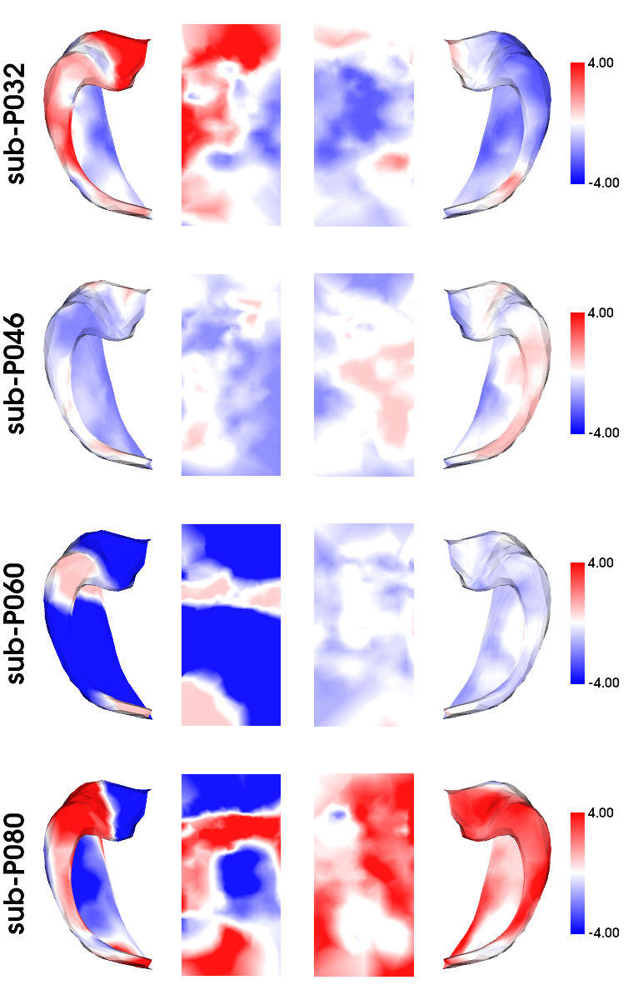

In [197]:
plotting.surfplot_canonical_foldunfold(reshape4surfplot(snsx_epi_zscore[4][snsx_mts_idxs[4]]),
                                  labels=['hipp'],
                                  den='2mm',
                                  tighten_cwindow=True, 
                                  embed_nb=True, 
                                  color_bar='right',
                                  share='row',
                                  cmap='bwr',
                                  color_range=(-4,4),
                                  label_text=snsx_epi_dfs[4].iloc[snsx_mts_idxs[4]]['participant_id'].to_list())


In [ ]:
plotting.surfplot_canonical_foldunfold(reshape4surfplot(snsx_epi_zscore[4][snsx_mts_idxs[4]]),
                                  labels=['hipp'],
                                  den='2mm',
                                  tighten_cwindow=True, 
                                  embed_nb=True, 
                                  color_bar='right',
                                  share='row',
                                  cmap='bwr',
                                  color_range=(-4,4),
                                  label_text=snsx_epi_dfs[4].iloc[snsx_mts_idxs[4]]['participant_id'].to_list())


In [215]:

eplink_mts_idxs = [ list(df[df['mri_mts'] == 1].index) for df in eplink_possibleTLE_dfs]


In [1252]:

eplink_TLE_idxs = [ list(df[df['TLE'] == 1].index) for df in eplink_possibleTLE_dfs]

In [1253]:
eplink_possibleTLE_dfs[0][eplink_possibleTLE_dfs[0]['mri_mts'] ==1].index

Int64Index([10, 14, 16, 17, 24, 31, 34], dtype='int64')

In [1254]:
eplink_possibleTLE_dfs[0].mri_mts.value_counts()

0.0    18
1.0     7
Name: mri_mts, dtype: int64

In [218]:
eplink_possibleTLE_dfs[0].mri_mts_location.value_counts()

0.0    18
1.0     4
3.0     2
2.0     1
Name: mri_mts_location, dtype: int64

In [219]:
eplink_possibleTLE_dfs[0]

,participant_id,age,sex,handedness,focal_seizures,generalized_seizures,mesial_temporal_lobe_epilepsy,temporal_lobe_epilepsy,frontal_lobe_epilepsy,occipital_lobe_epilepsy,...,pathology_completed,ilae_hippocampal_sclerosis_classification,hippocampal_pathology_details,neocortical_pathology_details,paths,site_code,sex_code,mri_mts,mri_mts_location,TLE
0,sub-HSC0002,13.0,Female,Right,Checked,Unchecked,No,Possible,Possible,NaN,...,No,NaN,NaN,NaN,/home/ROBARTS/myousif/graham/scratch/norm_mode...,25,0,NaN,NaN,0.0
1,sub-HSC0006,10.0,Male,Right,Checked,Checked,No,Possible,No,Possible,...,Yes,No hippocampal sclerosis,NaN,Pathology demonstrated diffuse low grade astro...,/home/ROBARTS/myousif/graham/scratch/norm_mode...,25,1,0.0,0.0,0.0
2,sub-HSC0009,9.0,Female,Right,Checked,Unchecked,No,Probable,No,No,...,Yes,NaN,NaN,NaN,/home/ROBARTS/myousif/graham/scratch/norm_mode...,25,0,0.0,0.0,1.0
3,sub-HSC0016,17.0,Female,Right,Checked,Unchecked,No,Probable,Probable,No,...,Yes,NaN,NaN,NaN,/home/ROBARTS/myousif/graham/scratch/norm_mode...,25,0,0.0,0.0,1.0
4,sub-HSC0026,14.0,Female,Right,Checked,Unchecked,Possible,Possible,No,No,...,NaN,NaN,NaN,NaN,/home/ROBARTS/myousif/graham/scratch/norm_mode...,25,0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
58,sub-TWH0078,32.0,Male,Left,Checked,Unchecked,Definite,Definite,No,No,...,NaN,NaN,NaN,NaN,/home/ROBARTS/myousif/graham/scratch/norm_mode...,25,1,NaN,NaN,1.0
59,sub-TWH0081,41.0,Female,Right,Checked,Unchecked,Probable,Probable,Probable,No,...,NaN,NaN,NaN,NaN,/home/ROBARTS/myousif/graham/scratch/norm_mode...,25,0,NaN,NaN,1.0
60,sub-TWH0082,26.0,Male,Right,Checked,Unchecked,Possible,Definite,No,No,...,NaN,NaN,NaN,NaN,/home/ROBARTS/myousif/graham/scratch/norm_mode...,25,1,NaN,NaN,1.0
61,sub-TWH0085,54.0,Male,Right,Checked,Unchecked,No,Definite,No,No,...,NaN,NaN,NaN,NaN,/home/ROBARTS/myousif/graham/scratch/norm_mode...,25,1,NaN,NaN,1.0


In [220]:
eplink_possibleTLE_dfs[0].iloc[eplink_mts_idxs[0]]['mri_mts_location']

10    1.0
14    1.0
16    3.0
17    1.0
24    3.0
31    1.0
34    2.0
Name: mri_mts_location, dtype: float64

/home/ROBARTS/myousif/virtualenvs/pcntoolkit_dev_cbs_venv/lib/python3.8/site-packages/brainspace-0.1.10-py3.8.egg/brainspace/plotting/base.py:287: UserWarning: Interactive mode requires 'panel'. Setting 'interactive=False'
  warnings.warn("Interactive mode requires 'panel'. "


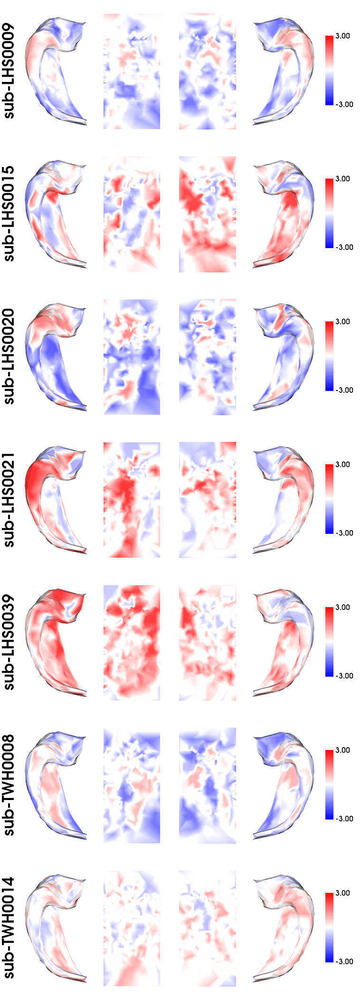

In [221]:
plotting.surfplot_canonical_foldunfold(reshape4surfplot(eplink_possibleTLE_zscore[0][eplink_mts_idxs[0]]),
                                  labels=['hipp'],
                                  den='2mm',
                                  tighten_cwindow=True, 
                                  embed_nb=True, 
                                  color_bar='right',
                                  share='row',
                                  cmap='bwr',
                                  color_range=(-3,3),
                                  label_text=eplink_possibleTLE_dfs[0].iloc[eplink_mts_idxs[0]]['participant_id'].to_list())


In [223]:
eplink_possibleTLE_dfs[1].iloc[eplink_mts_idxs[1]]['mri_mts_location']

10    1.0
14    1.0
16    3.0
17    1.0
24    3.0
31    1.0
34    2.0
Name: mri_mts_location, dtype: float64

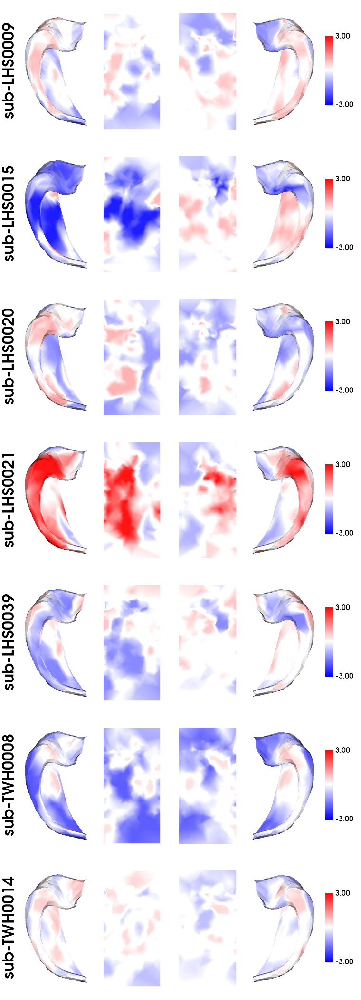

In [222]:
plotting.surfplot_canonical_foldunfold(reshape4surfplot(eplink_possibleTLE_zscore[1][eplink_mts_idxs[1]]),
                                  labels=['hipp'],
                                  den='2mm',
                                  tighten_cwindow=True, 
                                  embed_nb=True, 
                                  color_bar='right',
                                  share='row',
                                  cmap='bwr',
                                  color_range=(-3,3),
                                  label_text=eplink_possibleTLE_dfs[1].iloc[eplink_mts_idxs[1]]['participant_id'].to_list())


In [226]:
eplink_possibleTLE_dfs[2].iloc[eplink_mts_idxs[2]]['mri_mts_location']

7     1.0
9     1.0
10    3.0
16    3.0
21    2.0
Name: mri_mts_location, dtype: float64

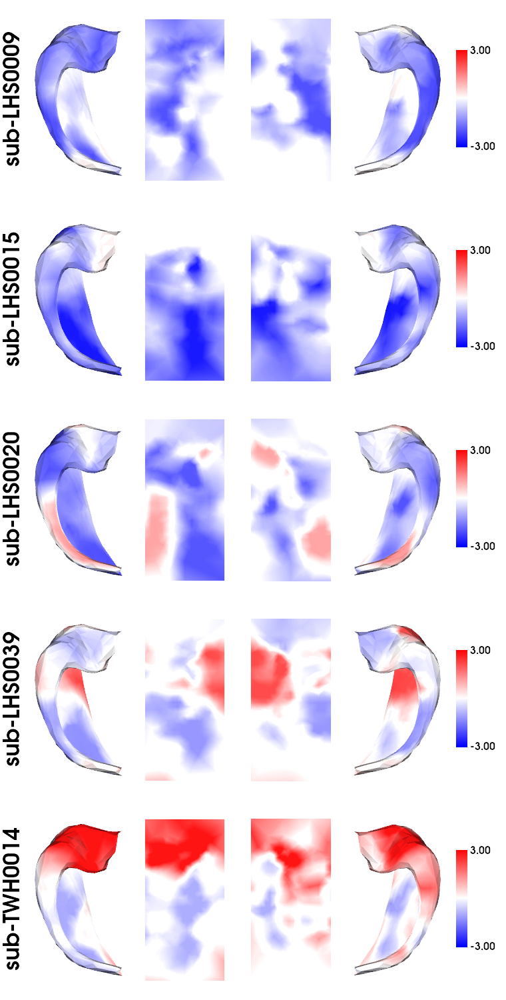

In [224]:
plotting.surfplot_canonical_foldunfold(reshape4surfplot(eplink_possibleTLE_zscore[2][eplink_mts_idxs[2]]),
                                  labels=['hipp'],
                                  den='2mm',
                                  tighten_cwindow=True, 
                                  embed_nb=True, 
                                  color_bar='right',
                                  share='row',
                                  cmap='bwr',
                                  color_range=(-3,3),
                                  label_text=eplink_possibleTLE_dfs[2].iloc[eplink_mts_idxs[2]]['participant_id'].to_list())


In [1244]:
eplink_possibleTLE_dfs[3].iloc[eplink_mts_idxs[3]]['mri_mts_location']

7     1.0
9     1.0
10    3.0
16    3.0
21    2.0
Name: mri_mts_location, dtype: float64

In [1245]:
eplink_possibleTLE_zscore[0]

array([[-0.50165846, -1.24997831, -1.22931511, ...,  1.15447923,
        -1.28414031,  0.245553  ],
       [ 0.46973481,  1.52725675, -0.87353477, ..., -0.23705565,
         2.24321402,  2.17033839],
       [ 0.07311076, -1.4644565 ,  0.28066319, ...,  1.11752243,
        -1.09917856,  0.1556675 ],
       ...,
       [-0.50351003,  1.74988555, -0.70127427, ..., -0.01225926,
        -0.32403428, -0.69123572],
       [-1.10254376, -1.08839988, -0.35186821, ...,  0.50157121,
        -1.84396634, -2.31797884],
       [ 0.23960713, -0.97334775, -1.605619  , ..., -0.39651118,
        -1.58448415, -1.0261822 ]])

In [252]:
np.zeros(len(snsx_disease_ctrl_zscore[4].mean(axis=1)))

array([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0.])

In [1246]:
mean_thick_zscore = np.concatenate([eplink_possibleTLE_zscore[0].mean(axis=1),snsx_epi_zscore[0].mean(axis=1),snsx_disease_ctrl_zscore[0].mean(axis=1)])
mean_gyr_zscore = np.concatenate([eplink_possibleTLE_zscore[1].mean(axis=1),snsx_epi_zscore[1].mean(axis=1),snsx_disease_ctrl_zscore[1].mean(axis=1)])
mean_myelin_zscore = np.concatenate([snsx_epi_zscore[2].mean(axis=1),snsx_disease_ctrl_zscore[2].mean(axis=1)])
mean_fa_zscore = np.concatenate([eplink_possibleTLE_zscore[2].mean(axis=1),snsx_epi_zscore[3].mean(axis=1),snsx_disease_ctrl_zscore[3].mean(axis=1)])
mean_md_zscore = np.concatenate([eplink_possibleTLE_zscore[3].mean(axis=1),snsx_epi_zscore[4].mean(axis=1),snsx_disease_ctrl_zscore[4].mean(axis=1)])


In [1247]:

thick_label = np.concatenate([eplink_possibleTLE_dfs[0].TLE.to_numpy(),snsx_epi_dfs[0].TLE.to_numpy(),np.ones(len(snsx_disease_ctrl_zscore[0].mean(axis=1)))*2])
gyr_label = np.concatenate([eplink_possibleTLE_dfs[1].TLE.to_numpy(),snsx_epi_dfs[1].TLE.to_numpy(),np.ones(len(snsx_disease_ctrl_zscore[1].mean(axis=1)))*2])
myelin_label = np.concatenate([snsx_epi_dfs[2].TLE.to_numpy(),np.ones(len(snsx_disease_ctrl_zscore[2].mean(axis=1)))*2])
fa_label = np.concatenate([eplink_possibleTLE_dfs[2].TLE.to_numpy(),snsx_epi_dfs[3].TLE.to_numpy(),np.ones(len(snsx_disease_ctrl_zscore[3].mean(axis=1)))*2])
md_label = np.concatenate([eplink_possibleTLE_dfs[3].TLE.to_numpy(),snsx_epi_dfs[4].TLE.to_numpy(),np.ones(len(snsx_disease_ctrl_zscore[4].mean(axis=1)))*2])


In [1248]:

rename_labels = lambda labels_arr: pd.Series(labels_arr).replace(0,'non-TLE epilepsy').replace(1,'TLE').replace(2,'Movement disorder')


In [299]:
hue_order_kde = ['non-TLE epilepsy', 'TLE','Movement disorder']

In [298]:
rename_labels(thick_label).unique()

array(['non-TLE epilepsy', 'TLE', nan, 'Movement disorder'], dtype=object)

<AxesSubplot: ylabel='Density'>

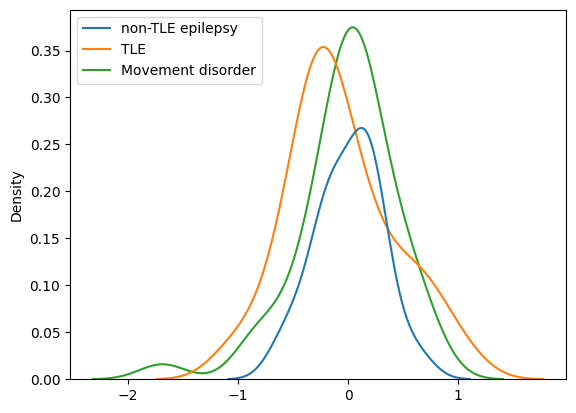

In [300]:

sns.kdeplot(x=mean_thick_zscore, hue=rename_labels(thick_label),hue_order=hue_order_kde)
            

<AxesSubplot: ylabel='Density'>

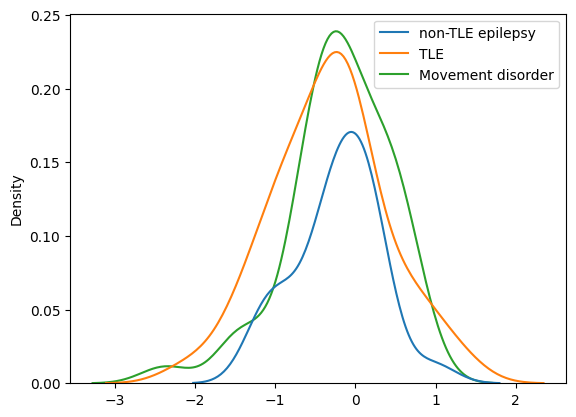

In [301]:
sns.kdeplot(x=mean_gyr_zscore, hue=rename_labels(gyr_label),hue_order=hue_order_kde)

<AxesSubplot: ylabel='Density'>

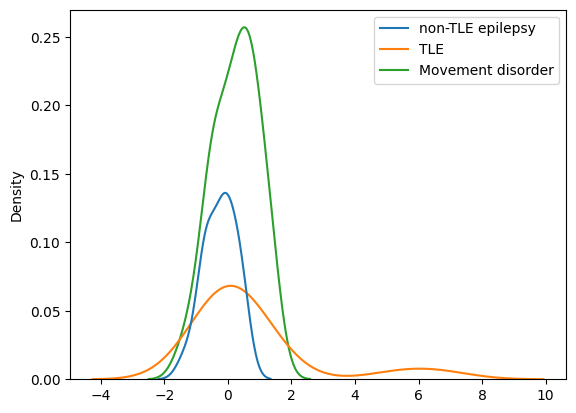

In [302]:
sns.kdeplot(x=mean_myelin_zscore, hue=rename_labels(myelin_label),hue_order=hue_order_kde)

<AxesSubplot: ylabel='Density'>

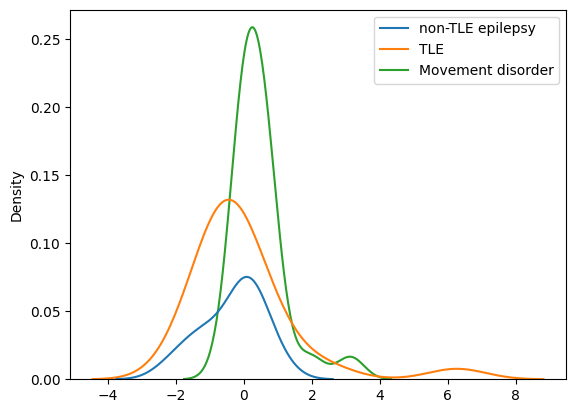

In [303]:
sns.kdeplot(x=mean_fa_zscore, hue=rename_labels(fa_label),hue_order=hue_order_kde)

<AxesSubplot: ylabel='Density'>

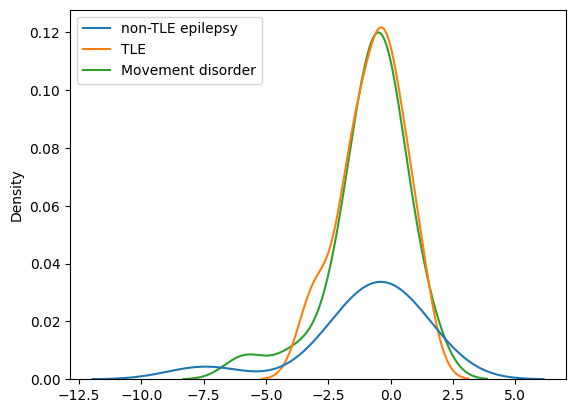

In [304]:
sns.kdeplot(x=mean_md_zscore, hue=rename_labels(md_label),hue_order=hue_order_kde)

# sns.kdeplot(x=snsx_disease_ctrl_zscore[4].mean(axis=1),hue=np.zeros(len(snsx_disease_ctrl_zscore[4].mean(axis=1))))

<AxesSubplot: xlabel='age'>

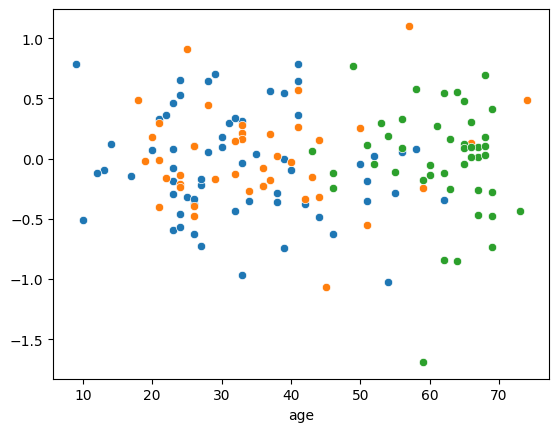

In [308]:
sns.scatterplot(x=eplink_possibleTLE_dfs[0].age,y=eplink_possibleTLE_zscore[0].mean(axis=1))
sns.scatterplot(x=snsx_epi_dfs[0].age,y=snsx_epi_zscore[0].mean(axis=1))
sns.scatterplot(x=snsx_dc_dfs[0].age, y=snsx_disease_ctrl_zscore[0].mean(axis=1))


<AxesSubplot: xlabel='age'>

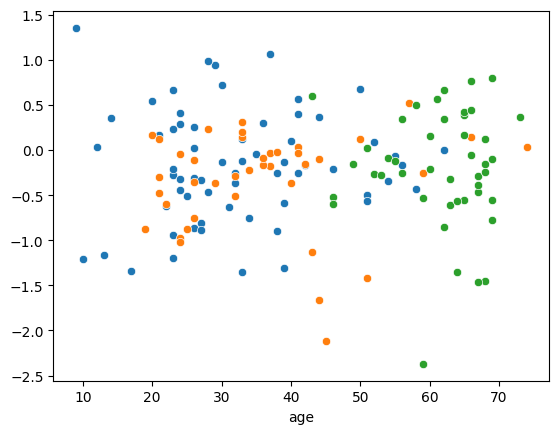

In [307]:

sns.scatterplot(x=eplink_possibleTLE_dfs[1].age,y=eplink_possibleTLE_zscore[1].mean(axis=1))
sns.scatterplot(x=snsx_epi_dfs[1].age,y=snsx_epi_zscore[1].mean(axis=1))
sns.scatterplot(x=snsx_dc_dfs[1].age, y=snsx_disease_ctrl_zscore[1].mean(axis=1))


<AxesSubplot: xlabel='age'>

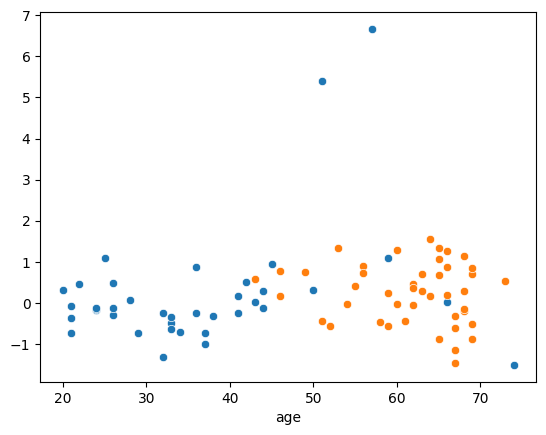

In [306]:


sns.scatterplot(x=snsx_epi_dfs[2].age,y=snsx_epi_zscore[2].mean(axis=1))
sns.scatterplot(x=snsx_dc_dfs[2].age, y=snsx_disease_ctrl_zscore[2].mean(axis=1))


<AxesSubplot: xlabel='age'>

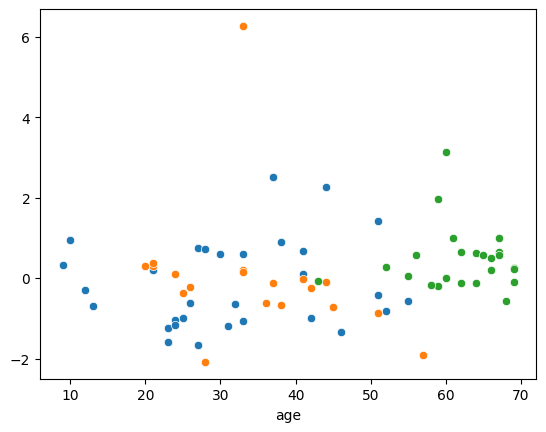

In [305]:

sns.scatterplot(x=eplink_possibleTLE_dfs[2].age,y=eplink_possibleTLE_zscore[2].mean(axis=1))
sns.scatterplot(x=snsx_epi_dfs[3].age,y=snsx_epi_zscore[3].mean(axis=1))
sns.scatterplot(x=snsx_dc_dfs[3].age, y=snsx_disease_ctrl_zscore[3].mean(axis=1))


<AxesSubplot: xlabel='age'>

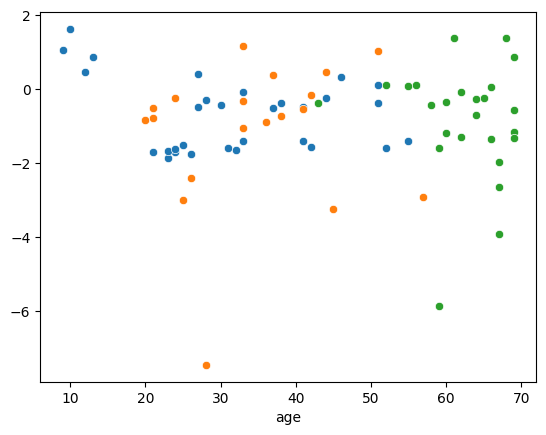

In [247]:

sns.scatterplot(x=eplink_possibleTLE_dfs[3].age,y=eplink_possibleTLE_zscore[3].mean(axis=1))
sns.scatterplot(x=snsx_epi_dfs[4].age,y=snsx_epi_zscore[4].mean(axis=1))
sns.scatterplot(x=snsx_dc_dfs[4].age, y=snsx_disease_ctrl_zscore[4].mean(axis=1))

In [ ]:
e

In [1251]:
eplink_mts_idxs

[[10, 14, 16, 17, 24, 31, 34],
 [10, 14, 16, 17, 24, 31, 34],
 [7, 9, 10, 16, 21],
 [7, 9, 10, 16, 21]]

In [ ]:
epl

In [1263]:
[eplink_possibleTLE_dfs[0].mri_mts_location == 1]

[0     False
 1     False
 2     False
 3     False
 4     False
       ...  
 58    False
 59    False
 60    False
 61    False
 62    False
 Name: mri_mts_location, Length: 63, dtype: bool]

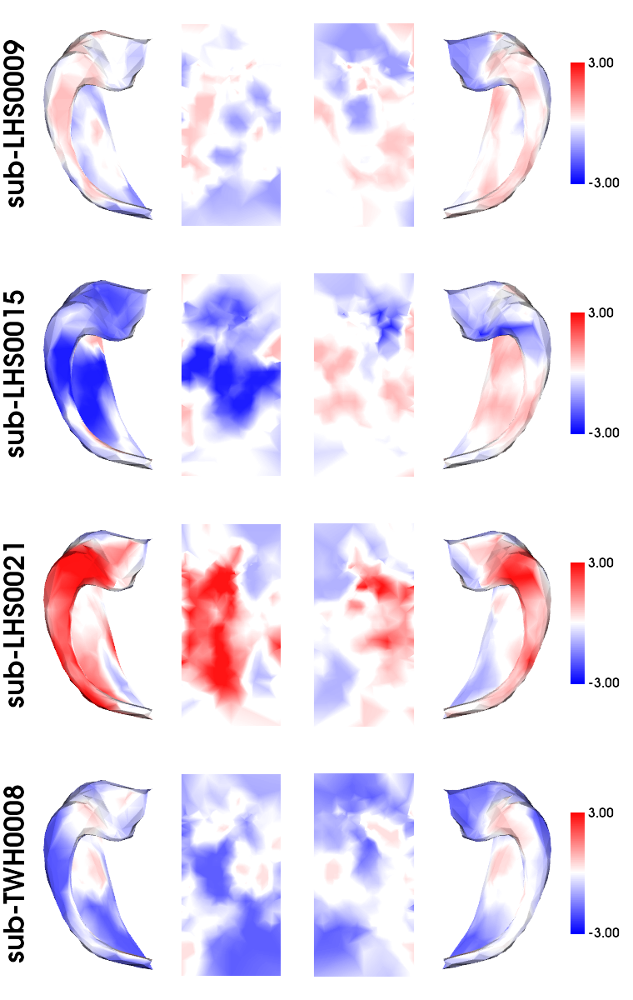

In [1321]:
met_idx = 1
location_idx = 1
plotting.surfplot_canonical_foldunfold(reshape4surfplot(eplink_possibleTLE_zscore[met_idx][eplink_possibleTLE_dfs[met_idx].mri_mts_location == location_idx]),
                                  labels=['hipp'],
                                  den='2mm',
                                  tighten_cwindow=True, 
                                  embed_nb=True, 
                                  color_bar='right',
                                  share='row',
                                  cmap='bwr',
                                  color_range=(-3,3),
                                  label_text=eplink_possibleTLE_dfs[met_idx][eplink_possibleTLE_dfs[met_idx].mri_mts_location == location_idx]['participant_id'].to_list())

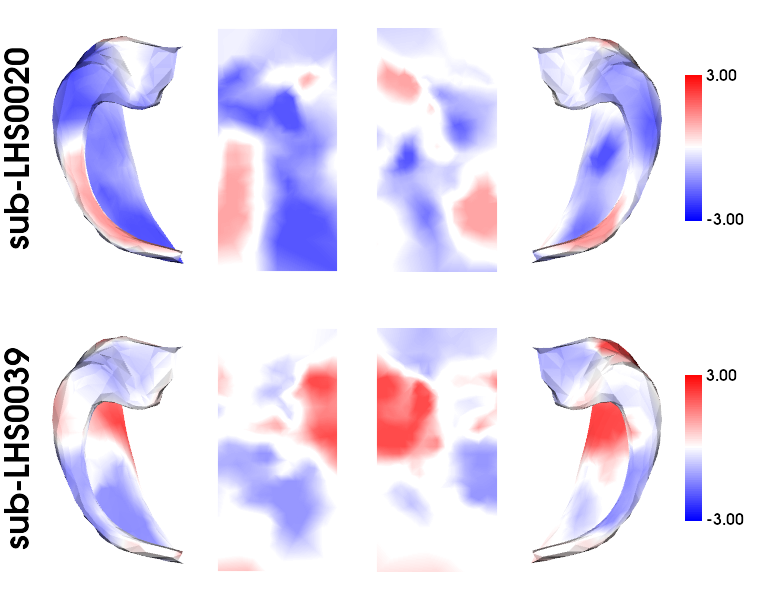

In [1341]:
met_idx = 2
location_idx = 3
plotting.surfplot_canonical_foldunfold(reshape4surfplot(eplink_possibleTLE_zscore[met_idx][eplink_possibleTLE_dfs[met_idx].mri_mts_location == location_idx]),
                                  labels=['hipp'],
                                  den='2mm',
                                  tighten_cwindow=True, 
                                  embed_nb=True, 
                                  color_bar='right',
                                  share='row',
                                  cmap='bwr',
                                  color_range=(-3,3),
                                  label_text=eplink_possibleTLE_dfs[met_idx][eplink_possibleTLE_dfs[met_idx].mri_mts_location == location_idx]['participant_id'].to_list())

In [1275]:
snsx_epi_dfs[0].mri_mts_lateralization.value_counts()


0.0    31
1.0     4
3.0     3
2.0     1
Name: mri_mts_lateralization, dtype: int64

In [1280]:
eplink_possibleTLE_zscore[met_idx][eplink_possibleTLE_dfs[met_idx].mri_mts_location == location_idx]

array([[-0.27190391,  0.82985011, -1.32206805, ..., -0.15021246,
         0.94294349,  0.41606399],
       [ 0.19962658, -1.58702732, -0.80986255, ...,  0.49428264,
        -2.42305661, -0.61390662]])

In [1283]:
snsx_epi_zscore[met_idx][snsx_epi_dfs[met_idx].mri_mts_lateralization==mts_idx]

array([[ 1.16375828, -0.09964744,  1.3850841 , ...,  0.3985123 ,
         1.49267975,  1.07754282],
       [-0.48403808, -0.28459509,  0.02944852, ..., -0.71960899,
         0.42607138,  0.60903432],
       [-1.94290888, -0.1038883 , -1.07219161, ..., -1.6135375 ,
         0.58104964,  0.54177899],
       [-1.08266141, -1.2766728 , -0.55322663, ...,  3.45874712,
         2.00848781,  2.44034997]])

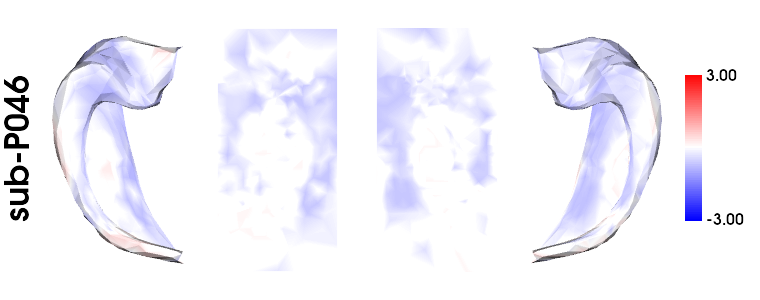

In [1331]:
met_idx = 2
mts_idx = 2
plotting.surfplot_canonical_foldunfold(reshape4surfplot(snsx_epi_zscore[met_idx][snsx_epi_dfs[met_idx].mri_mts_lateralization==mts_idx]),
                                  labels=['hipp'],
                                  den='2mm',
                                  tighten_cwindow=True, 
                                  embed_nb=True, 
                                  color_bar='right',
                                  share='row',
                                  cmap='bwr',
                                  color_range=(-3,3),
                                  label_text=snsx_epi_dfs[met_idx][snsx_epi_dfs[met_idx].mri_mts_lateralization==mts_idx]['participant_id'].to_list())


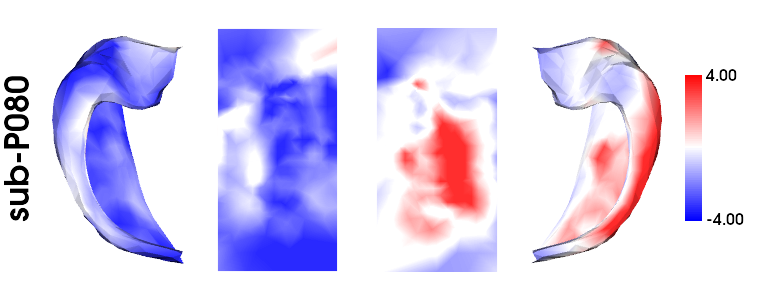

In [1346]:
met_idx = 3
mts_idx = 3
plotting.surfplot_canonical_foldunfold(reshape4surfplot(snsx_epi_zscore[met_idx][snsx_epi_dfs[met_idx].mri_mts_lateralization==mts_idx]),
                                  labels=['hipp'],
                                  den='2mm',
                                  tighten_cwindow=True, 
                                  embed_nb=True, 
                                  color_bar='right',
                                  share='row',
                                  cmap='bwr',
                                  color_range=(-4,4),
                                  label_text=snsx_epi_dfs[met_idx][snsx_epi_dfs[met_idx].mri_mts_lateralization==mts_idx]['participant_id'].to_list())


In [ ]:
plotting.surfplot_canonical_foldunfold(reshape4surfplot(eplink_possibleTLE_zscore[0][eplink_possibleTLE_dfs[0].mri_mts_location == 1]),
                                  labels=['hipp'],
                                  den='2mm',
                                  tighten_cwindow=True, 
                                  embed_nb=True, 
                                  color_bar='right',
                                  share='row',
                                  cmap='bwr',
                                  color_range=(-3,3),
                                  label_text=eplink_possibleTLE_dfs[0][eplink_possibleTLE_dfs[0].mri_mts_location == 1]['participant_id'].to_list())

/home/ROBARTS/myousif/virtualenvs/pcntoolkit_dev_cbs_venv/lib/python3.8/site-packages/brainspace-0.1.10-py3.8.egg/brainspace/plotting/base.py:287: UserWarning: Interactive mode requires 'panel'. Setting 'interactive=False'
  warnings.warn("Interactive mode requires 'panel'. "


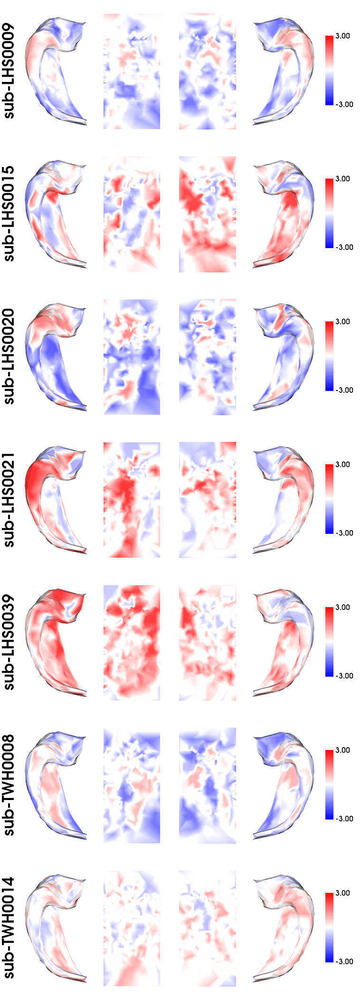

In [1257]:
plotting.surfplot_canonical_foldunfold(reshape4surfplot(eplink_possibleTLE_zscore[0][eplink_mts_idxs[0]]),
                                  labels=['hipp'],
                                  den='2mm',
                                  tighten_cwindow=True, 
                                  embed_nb=True, 
                                  color_bar='right',
                                  share='row',
                                  cmap='bwr',
                                  color_range=(-3,3),
                                  label_text=eplink_possibleTLE_dfs[0].iloc[eplink_mts_idxs[0]]['participant_id'].to_list())

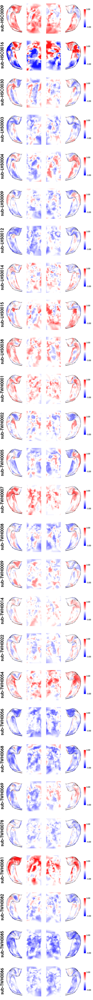

In [321]:
plotting.surfplot_canonical_foldunfold(reshape4surfplot(eplink_possibleTLE_zscore[0][eplink_TLE_idxs[0]]),
                                  labels=['hipp'],
                                  den='2mm',
                                  tighten_cwindow=True, 
                                  embed_nb=True, 
                                  color_bar='right',
                                  share='row',
                                  cmap='bwr',
                                  color_range=(-3,3),
                                  label_text=eplink_possibleTLE_dfs[0].iloc[eplink_TLE_idxs[0]]['participant_id'].to_list())

In [330]:
eplink_possibleTLE_dfs[1][eplink_possibleTLE_dfs[1]['participant_id'] == 'sub-HSC0016']

,participant_id,age,sex,handedness,focal_seizures,generalized_seizures,mesial_temporal_lobe_epilepsy,temporal_lobe_epilepsy,frontal_lobe_epilepsy,occipital_lobe_epilepsy,...,pathology_completed,ilae_hippocampal_sclerosis_classification,hippocampal_pathology_details,neocortical_pathology_details,paths,site_code,sex_code,mri_mts,mri_mts_location,TLE
3,sub-HSC0016,17.0,Female,Right,Checked,Unchecked,No,Probable,Probable,No,...,Yes,NaN,NaN,NaN,/home/ROBARTS/myousif/graham/scratch/norm_mode...,25,0,0.0,0.0,1.0


/home/ROBARTS/myousif/virtualenvs/pcntoolkit_dev_cbs_venv/lib/python3.8/site-packages/brainspace-0.1.10-py3.8.egg/brainspace/plotting/base.py:287: UserWarning: Interactive mode requires 'panel'. Setting 'interactive=False'
  warnings.warn("Interactive mode requires 'panel'. "


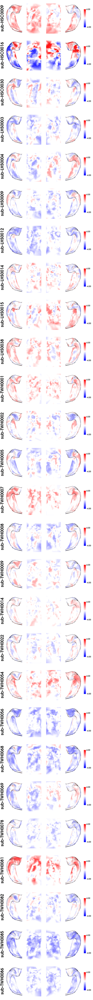

In [331]:
plotting.surfplot_canonical_foldunfold(reshape4surfplot(eplink_possibleTLE_zscore[0][eplink_TLE_idxs[0]]),
                                  labels=['hipp'],
                                  den='2mm',
                                  tighten_cwindow=True, 
                                  embed_nb=True, 
                                  color_bar='right',
                                  share='row',
                                  cmap='bwr',
                                  color_range=(-4,4),
                                  label_text=eplink_possibleTLE_dfs[0].iloc[eplink_TLE_idxs[1]]['participant_id'].to_list())

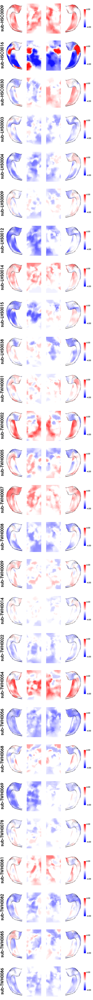

In [323]:
plotting.surfplot_canonical_foldunfold(reshape4surfplot(eplink_possibleTLE_zscore[1][eplink_TLE_idxs[1]]),
                                  labels=['hipp'],
                                  den='2mm',
                                  tighten_cwindow=True, 
                                  embed_nb=True, 
                                  color_bar='right',
                                  share='row',
                                  cmap='bwr',
                                  color_range=(-4,4),
                                  label_text=eplink_possibleTLE_dfs[1].iloc[eplink_TLE_idxs[1]]['participant_id'].to_list())


/home/ROBARTS/myousif/virtualenvs/pcntoolkit_dev_cbs_venv/lib/python3.8/site-packages/brainspace-0.1.10-py3.8.egg/brainspace/plotting/base.py:287: UserWarning: Interactive mode requires 'panel'. Setting 'interactive=False'
  warnings.warn("Interactive mode requires 'panel'. "


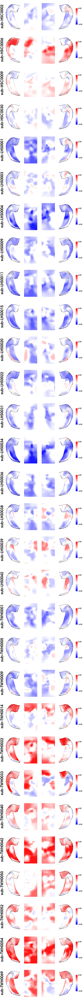

In [309]:
plotting.surfplot_canonical_foldunfold(reshape4surfplot(eplink_possibleTLE_zscore[2]),
                                  labels=['hipp'],
                                  den='2mm',
                                  tighten_cwindow=True, 
                                  embed_nb=True, 
                                  color_bar='right',
                                  share='row',
                                  cmap='bwr',
                                  color_range=(-4,4),
                                  label_text=eplink_possibleTLE_dfs[2]['participant_id'].to_list())


In [335]:
eplink_possibleTLE_zscore[3][eplink_mts_idxs[3]].shape

(5, 838)

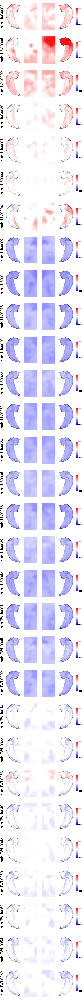

In [230]:
plotting.surfplot_canonical_foldunfold(reshape4surfplot(eplink_possibleTLE_zscore[3]),
                                  labels=['hipp'],
                                  den='2mm',
                                  tighten_cwindow=True, 
                                  embed_nb=True, 
                                  color_bar='right',
                                  share='row',
                                  cmap='bwr',
                                  color_range=(-4,4),
                                  label_text=eplink_possibleTLE_dfs[3]['participant_id'].to_list())


In [130]:
snsx_epi_dfs[0].TLE.value_counts()

1.0    21
0.0    18
Name: TLE, dtype: int64

In [127]:
eplink_possibleTLE_dfs[0].TLE.value_counts()

1.0    27
0.0     8
Name: TLE, dtype: int64

In [123]:
eplink_possibleTLE_zscore[0]

(63, 838)